Created
Feb 20, 2024 with Google Colaboratory

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import learning_curve
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score, recall_score, f1_score

In [ ]:
df=pd.read_csv('/content/One_Simulator_Dataset.csv')
df

,router,sim_time,created,started,relayed,aborted,dropped,removed,delivered,delivery_prob,response_prob,overhead_ratio,latency_avg,latency_med,hopcount_avg,hopcount_med,buffertime_avg,buffertime_med,rtt_avg,rtt_med
0,EpidemicRouter,5000.0,168,5543,2847,2690,2036,0,28,0.1667,0,100.6786,1647.2714,1787.1,3.1786,3,937.7552,758.6,NaN,NaN
1,EpidemicRouter,115152.0,3891,159376,86029,73345,87680,0,993,0.2552,0,85.6354,5131.5297,3828.2,4.5690,4,1458.6536,917.7,NaN,NaN
2,EpidemicRouter,75628.1,2559,102958,54645,48308,55388,0,645,0.2521,0,83.7209,5002.0574,3647.2,4.4481,4,1465.2708,913.3,NaN,NaN
3,EpidemicRouter,166516.0,5631,234747,128346,106395,131290,0,1478,0.2625,0,85.8376,5034.4916,3780.7,4.5825,4,1443.0280,900.6,NaN,NaN
4,EpidemicRouter,153002.0,5172,215752,117985,97766,120645,0,1353,0.2616,0,86.2025,5044.7681,3740.1,4.6105,4,1432.6003,897.2,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3550,SprayAndWaitRouter,8084.0,273,3337,1236,2100,671,0,82,0.3004,0,14.0732,1932.2707,1707.9,2.4146,2,3026.2396,2847.1,NaN,NaN
3551,SprayAndWaitRouter,44062.1,1489,21109,7789,13320,7772,0,664,0.4459,0,10.7304,2983.0107,2217.6,2.4172,2,3960.1532,3287.0,NaN,NaN
3552,SprayAndWaitRouter,42612.1,1441,20345,7500,12844,7451,0,646,0.4483,0,10.6099,2987.3313,2218.2,2.4195,2,3953.3023,3293.9,NaN,NaN
3553,SprayAndWaitRouter,31259.1,1058,14982,5454,9527,5198,0,461,0.4357,0,10.8308,2816.5939,2203.0,2.4295,2,3852.4447,3255.6,NaN,NaN


In [ ]:
df.dtypes

router             object
sim_time          float64
created             int64
started             int64
relayed             int64
aborted             int64
dropped             int64
removed             int64
delivered           int64
delivery_prob     float64
response_prob       int64
overhead_ratio    float64
latency_avg       float64
latency_med       float64
hopcount_avg      float64
hopcount_med        int64
buffertime_avg    float64
buffertime_med    float64
rtt_avg           float64
rtt_med           float64
dtype: object

In [ ]:
df.isnull().sum()

router               0
sim_time             0
created              0
started              0
relayed              0
aborted              0
dropped              0
removed              0
delivered            0
delivery_prob        0
response_prob        0
overhead_ratio       0
latency_avg          0
latency_med          0
hopcount_avg         0
hopcount_med         0
buffertime_avg       0
buffertime_med       0
rtt_avg           3555
rtt_med           3555
dtype: int64

In [ ]:
print(set(df['router']))

{'SprayAndWaitRouter', 'EpidemicRouter', 'ProphetRouter', 'MaxPropRouter', 'FirstContactRouter'}


In [ ]:
print(len(set(df['router'])))

5


In [ ]:
df.columns

Index(['router', 'sim_time', 'created', 'started', 'relayed', 'aborted',
       'dropped', 'removed', 'delivered', 'delivery_prob', 'response_prob',
       'overhead_ratio', 'latency_avg', 'latency_med', 'hopcount_avg',
       'hopcount_med', 'buffertime_avg', 'buffertime_med', 'rtt_avg',
       'rtt_med'],
      dtype='object')

In [ ]:
print(list(df['removed']))

[0, 0, 0, 0, 0, 10690, 12754, 17958, 12145, 12963, 18673, 15363, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [ ]:
print(list(df['response_prob']))

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [ ]:
import pandas as pd

# Drop 'rtt_avg' and 'rtt_med' columns
df.drop(['removed','response_prob','rtt_avg', 'rtt_med'], axis=1, inplace=True)

# Display the DataFrame after removing the columns
df.head(5)


,router,sim_time,created,started,relayed,aborted,dropped,delivered,delivery_prob,overhead_ratio,latency_avg,latency_med,hopcount_avg,hopcount_med,buffertime_avg,buffertime_med
0,EpidemicRouter,5000.0,168,5543,2847,2690,2036,28,0.1667,100.6786,1647.2714,1787.1,3.1786,3,937.7552,758.6
1,EpidemicRouter,115152.0,3891,159376,86029,73345,87680,993,0.2552,85.6354,5131.5297,3828.2,4.5690,4,1458.6536,917.7
2,EpidemicRouter,75628.1,2559,102958,54645,48308,55388,645,0.2521,83.7209,5002.0574,3647.2,4.4481,4,1465.2708,913.3
3,EpidemicRouter,166516.0,5631,234747,128346,106395,131290,1478,0.2625,85.8376,5034.4916,3780.7,4.5825,4,1443.0280,900.6
4,EpidemicRouter,153002.0,5172,215752,117985,97766,120645,1353,0.2616,86.2025,5044.7681,3740.1,4.6105,4,1432.6003,897.2


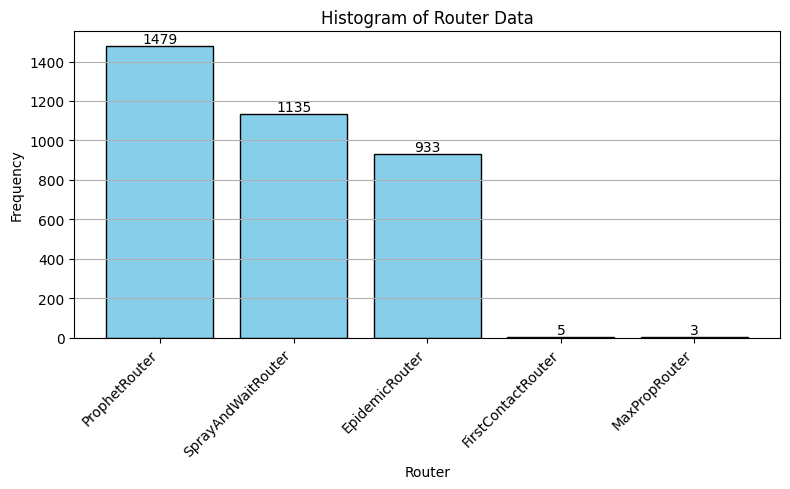

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt


# Get unique router names and their counts
router_counts = df['router'].value_counts()
router_names = router_counts.index
router_values = router_counts.values

# Plotting Histogram with Router Names and Counts
plt.figure(figsize=(8, 5))
plt.bar(router_names, router_values, color='skyblue', edgecolor='black')
plt.title('Histogram of Router Data')
plt.xlabel('Router')
plt.ylabel('Frequency')
plt.xticks(rotation=45, ha='right')  # Rotate labels for better readability
for i, v in enumerate(router_values):
    plt.text(i, v + 0.1, str(v), ha='center', va='bottom')  # Display count above each bar
plt.grid(axis='y')
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd

# Remove rows where 'router' column contains 'FirstContactrouter' or 'Maxproprouter'
df = df[~df['router'].isin(['FirstContactRouter', 'MaxPropRouter'])]

print(df)


                  router  sim_time  created  started  relayed  aborted  \
0         EpidemicRouter    5000.0      168     5543     2847     2690   
1         EpidemicRouter  115152.0     3891   159376    86029    73345   
2         EpidemicRouter   75628.1     2559   102958    54645    48308   
3         EpidemicRouter  166516.0     5631   234747   128346   106395   
4         EpidemicRouter  153002.0     5172   215752   117985    97766   
...                  ...       ...      ...      ...      ...      ...   
3550  SprayAndWaitRouter    8084.0      273     3337     1236     2100   
3551  SprayAndWaitRouter   44062.1     1489    21109     7789    13320   
3552  SprayAndWaitRouter   42612.1     1441    20345     7500    12844   
3553  SprayAndWaitRouter   31259.1     1058    14982     5454     9527   
3554  SprayAndWaitRouter  134036.0     4531    66149    24069    42079   

      dropped  delivered  delivery_prob  overhead_ratio  latency_avg  \
0        2036         28         0.1667

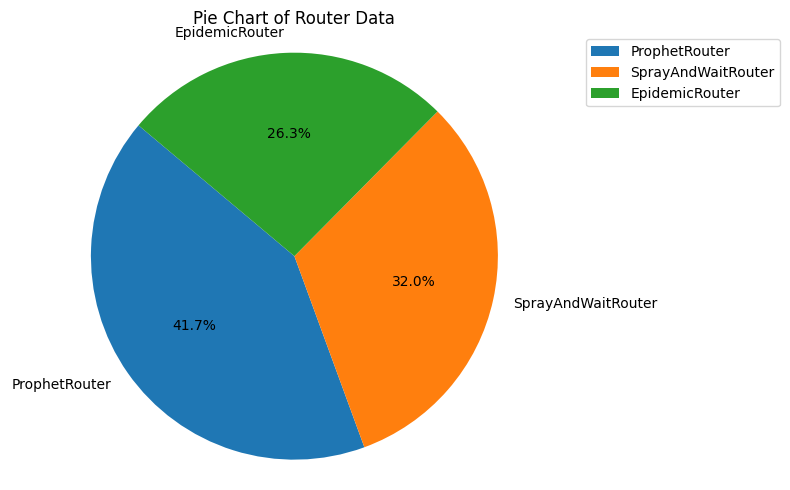

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt


# Get unique router names and their counts
router_counts = df['router'].value_counts()
router_names = router_counts.index
router_values = router_counts.values

# Plotting Pie Chart
plt.figure(figsize=(8, 5))
plt.pie(router_values, labels=router_names, autopct='%1.1f%%', startangle=140, colors=plt.cm.tab10.colors)
plt.title('Pie Chart of Router Data')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

# Adding a legend outside the plot
plt.legend(bbox_to_anchor=(1, 1), loc='upper left')

plt.tight_layout()
plt.show()


<ipython-input-142-b2cbb0705a76>:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()


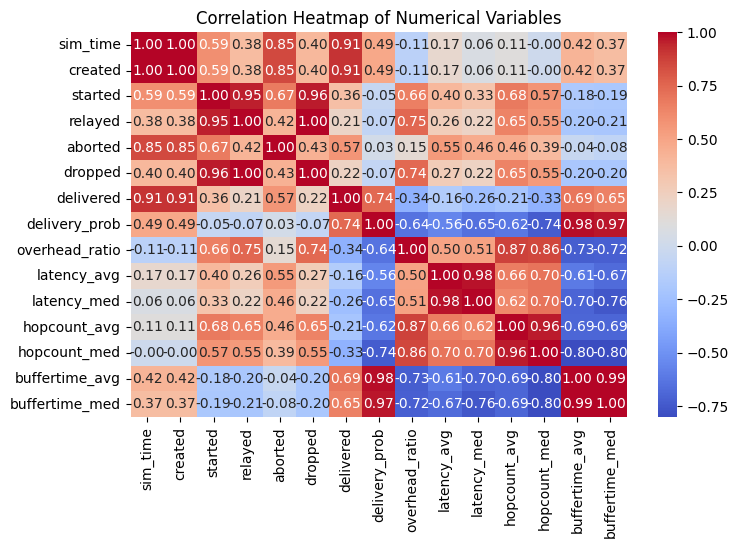

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Compute the correlation matrix
corr_matrix = df.corr()

# Plot heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap of Numerical Variables')
plt.show()


It seems like you're referring to a list of terms related to networking or communication systems. Here's an explanation of each term:

1. Router: A device that forwards data packets between computer networks. Routers use headers and forwarding tables to determine the best path for forwarding the packets.

2. Sim_time: Simulation time, indicating the time elapsed within a simulation environment. It's often used in network simulations to track events and behaviors over time.

3. Created: This likely refers to the number of data packets or network entities that were generated or initialized within a simulation or network environment.

4. Started: The number of processes or tasks that have commenced within the simulated network environment.

5. Relayed: The count of data packets or messages that were passed through an intermediary node (such as a router or relay) within the network.

6. Aborted: The number of processes or tasks that were terminated prematurely within the simulated network environment.

7. Dropped: The count of data packets or messages that were not successfully delivered to their intended destination and were therefore discarded or dropped by the network.

8. Removed: This could refer to entities or elements that were removed or deleted from the network simulation or environment.

9. Delivered: The count of data packets or messages that successfully reached their intended destination within the network.

10. Delivery_prob: Delivery probability, which may represent the likelihood or percentage of successful message delivery within the network.

11. Response_prob: Response probability, indicating the likelihood or percentage of receiving a response or acknowledgment to a transmitted message within the network.

12. Overhead_ratio: The ratio of additional data or resources consumed by the network protocol or system compared to the actual useful data being transmitted. It measures the efficiency of the network in terms of resource utilization.

13. Latency_avg: Average latency, referring to the average time it takes for data packets to travel from the source to the destination in the network.

14. Latency_med: Median latency, indicating the middle value in a sorted list of latencies, often used to represent the typical delay experienced by data packets in the network.

15. Hopcount_avg: Average hop count, which is the average number of intermediary nodes (hops) that data packets traverse from the source to the destination in the network.

16. Hopcount_med: Median hop count, representing the middle value in a sorted list of hop counts, providing another measure of the network's efficiency in data packet traversal.

17. Buffertime_avg: Average buffer time, indicating the average amount of time that data packets spend waiting in buffers or queues within the network before being forwarded.

18. Buffertime_med: Median buffer time, representing the middle value in a sorted list of buffer times, providing insight into the typical waiting time experienced by data packets in the network.

19. Rtt_avg: Average round-trip time (RTT), which is the average time it takes for a data packet to travel from the source to the destination and back again, often used to measure network latency.

20. Rtt_med: Median round-trip time (RTT), indicating the middle value in a sorted list of round-trip times, providing another measure of the typical delay experienced by data packets in the network.

#Replaced Data by Mean, Median and Mode

1. Sim_Time

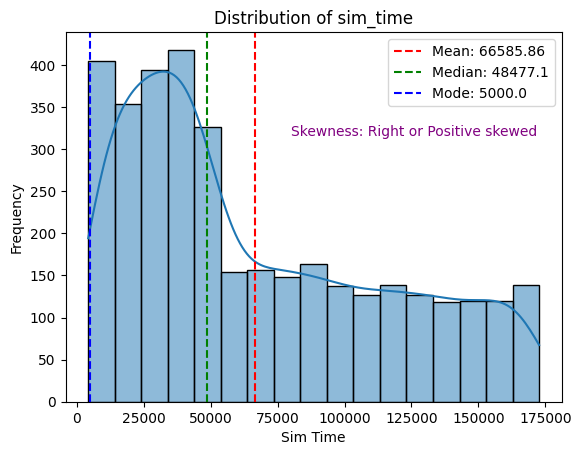

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['sim_time'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of sim_time')
plt.xlabel('Sim Time')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['sim_time'].mean()
median_value = df['sim_time'].median()
mode_value = df['sim_time'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['sim_time'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()

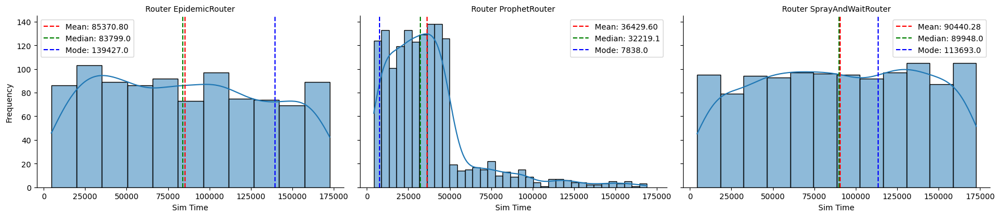

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'sim_time', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("Sim Time", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['sim_time'].mean()
    median_value = df[df['router'] == router]['sim_time'].median()
    mode_value = df[df['router'] == router]['sim_time'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


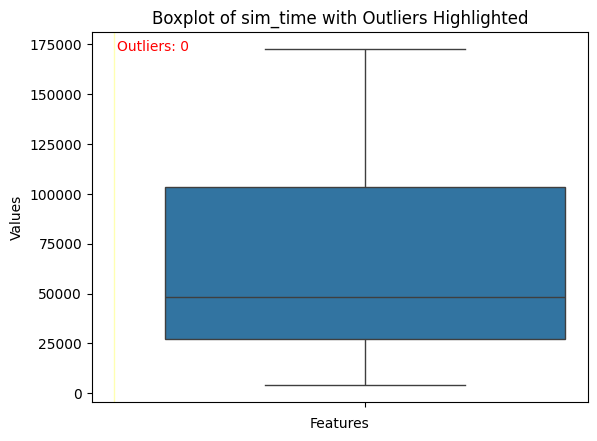

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['sim_time'])

# Calculate the number of outliers
q1 = df['sim_time'].quantile(0.25)
q3 = df['sim_time'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['sim_time'] < lower_bound) | (df['sim_time'] > upper_bound)]['sim_time']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of sim_time with Outliers Highlighted')
plt.show()


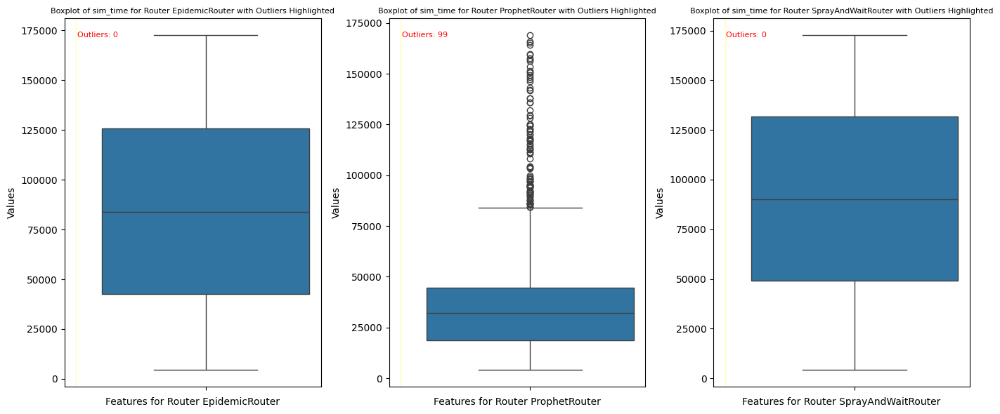

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['sim_time'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['sim_time'].quantile(0.25)
    q3 = df[df['router'] == router]['sim_time'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['sim_time'] < lower_bound) | (df['sim_time'] > upper_bound))]['sim_time']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of sim_time for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Loop through each router
for router in unique_routers:
    # Calculate outliers for each router
    q1 = df[df['router'] == router]['sim_time'].quantile(0.25)
    q3 = df[df['router'] == router]['sim_time'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr

    # Remove outliers
    df = df.drop(df[(df['router'] == router) & ((df['sim_time'] < lower_bound) | (df['sim_time'] > upper_bound))].index)

# Now df contains data with outliers removed


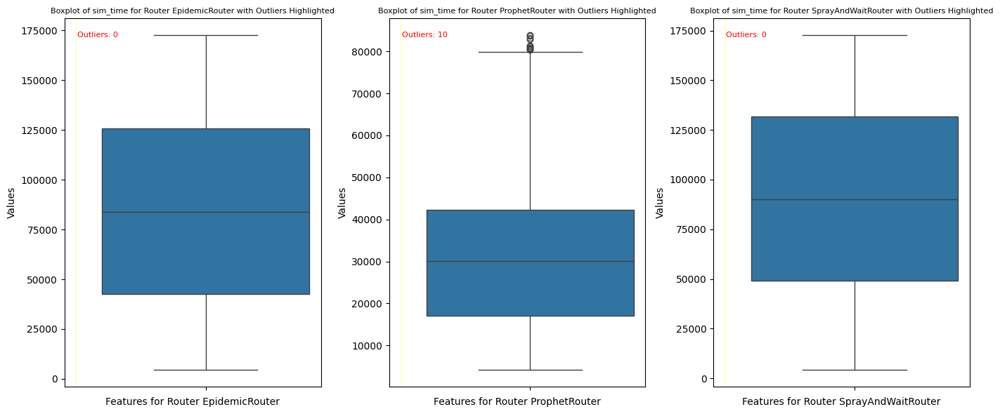

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['sim_time'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['sim_time'].quantile(0.25)
    q3 = df[df['router'] == router]['sim_time'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['sim_time'] < lower_bound) | (df['sim_time'] > upper_bound))]['sim_time']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of sim_time for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
df.shape

(3448, 16)

<ipython-input-152-b2cbb0705a76>:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()


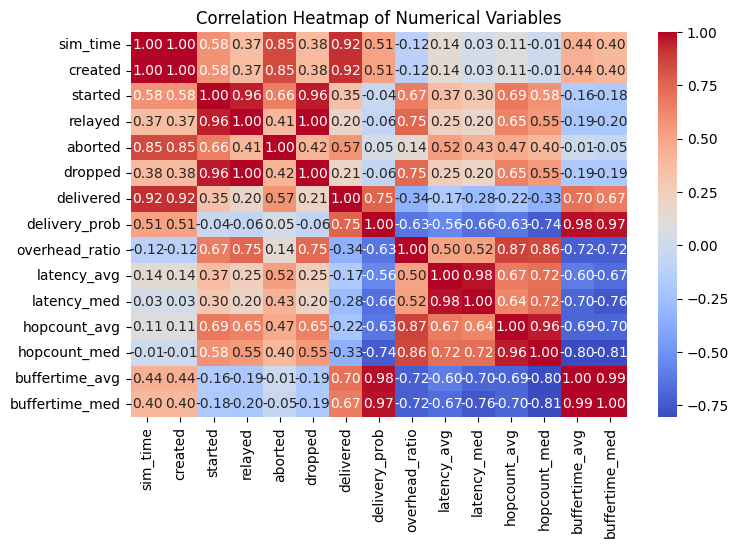

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Compute the correlation matrix
corr_matrix = df.corr()

# Plot heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap of Numerical Variables')
plt.show()


2. Created

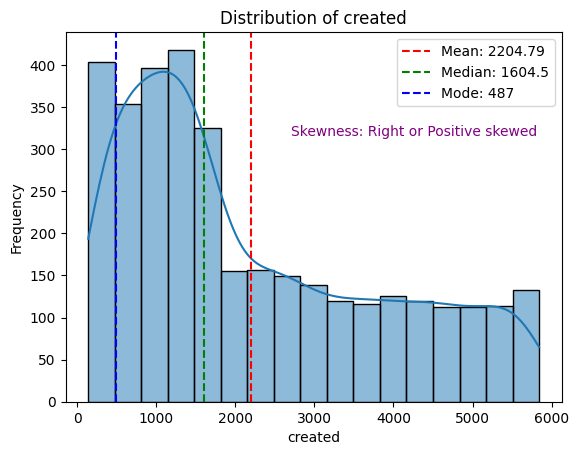

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['created'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of created')
plt.xlabel('created')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['created'].mean()
median_value = df['created'].median()
mode_value = df['created'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['created'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()


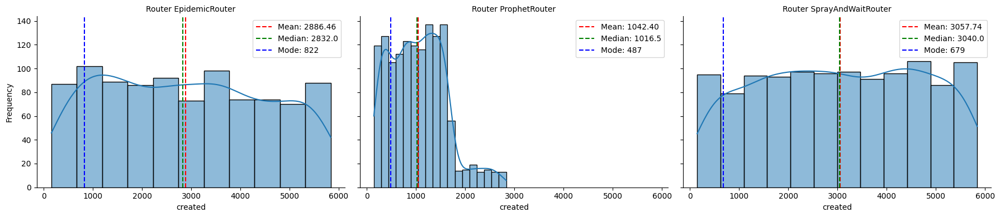

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'created', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("created", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['created'].mean()
    median_value = df[df['router'] == router]['created'].median()
    mode_value = df[df['router'] == router]['created'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


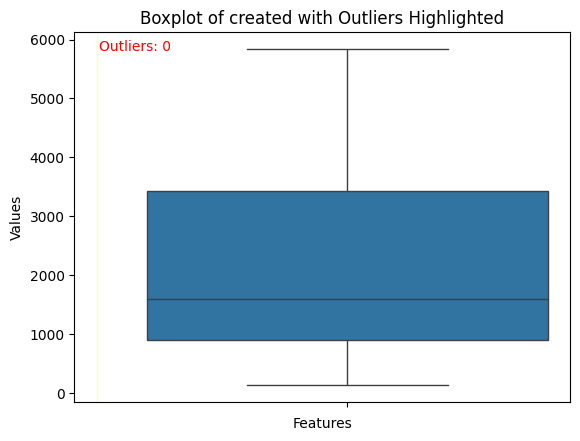

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['created'])

# Calculate the number of outliers
q1 = df['created'].quantile(0.25)
q3 = df['created'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['created'] < lower_bound) | (df['created'] > upper_bound)]['created']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of created with Outliers Highlighted')
plt.show()


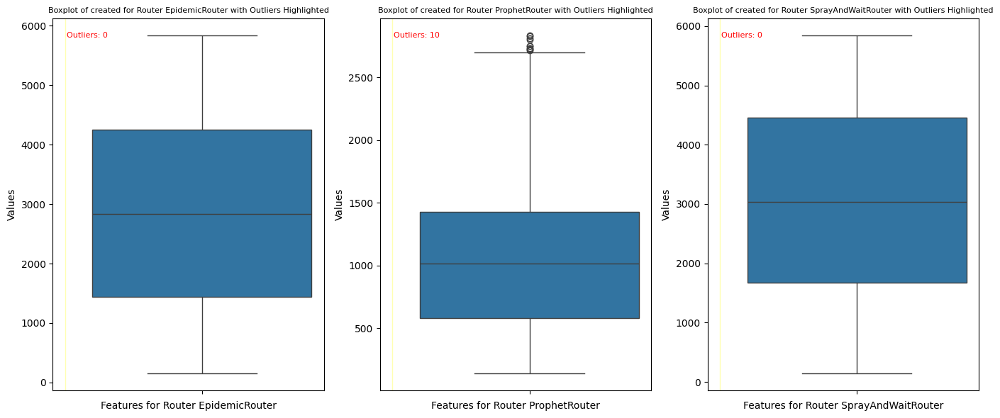

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['created'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['created'].quantile(0.25)
    q3 = df[df['router'] == router]['created'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['created'] < lower_bound) | (df['created'] > upper_bound))]['created']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of created for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Loop through each router
for router in unique_routers:
    # Calculate outliers for each router
    q1 = df[df['router'] == router]['created'].quantile(0.25)
    q3 = df[df['router'] == router]['created'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr

    # Remove outliers
    df = df.drop(df[(df['router'] == router) & ((df['created'] < lower_bound) | (df['created'] > upper_bound))].index)

# Now df contains data with outliers removed


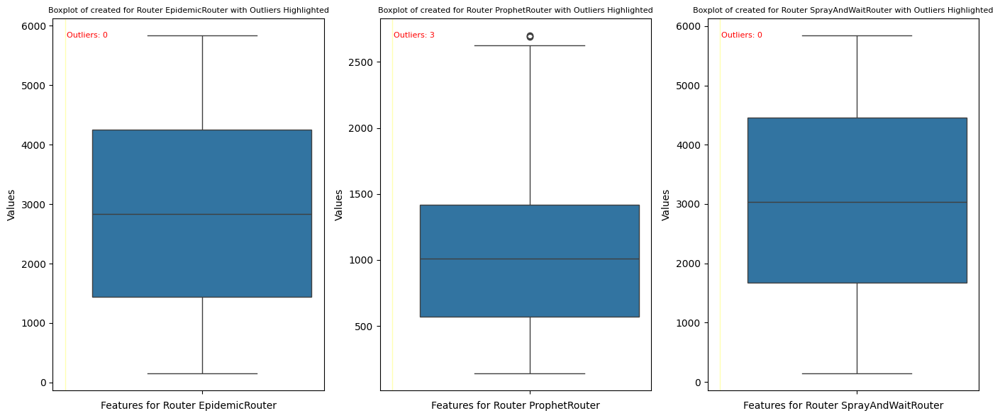

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['created'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['created'].quantile(0.25)
    q3 = df[df['router'] == router]['created'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['created'] < lower_bound) | (df['created'] > upper_bound))]['created']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of created for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
df.shape

(3438, 16)

<ipython-input-162-b2cbb0705a76>:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()


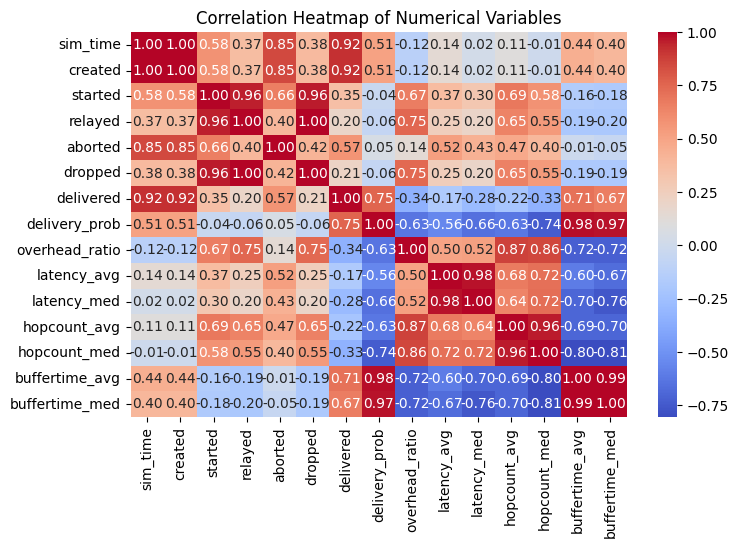

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Compute the correlation matrix
corr_matrix = df.corr()

# Plot heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap of Numerical Variables')
plt.show()


3. Started

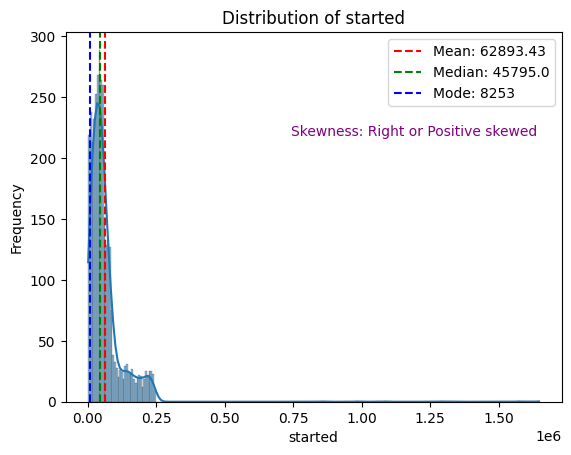

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['started'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of started')
plt.xlabel('started')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['started'].mean()
median_value = df['started'].median()
mode_value = df['started'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['started'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()


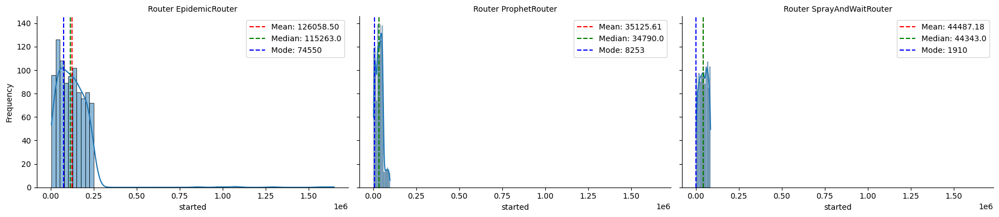

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'started', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("started", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['started'].mean()
    median_value = df[df['router'] == router]['started'].median()
    mode_value = df[df['router'] == router]['started'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


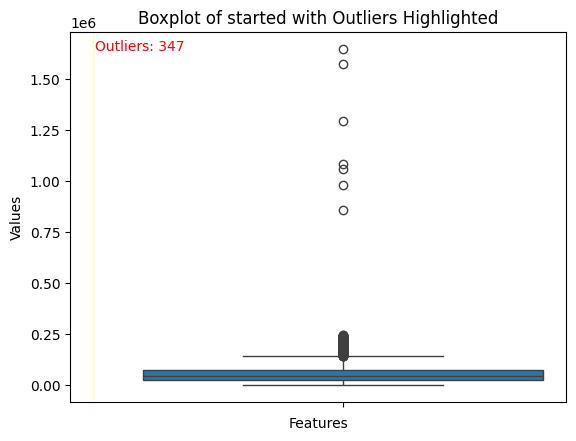

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['started'])

# Calculate the number of outliers
q1 = df['started'].quantile(0.25)
q3 = df['started'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['started'] < lower_bound) | (df['started'] > upper_bound)]['started']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of started with Outliers Highlighted')
plt.show()


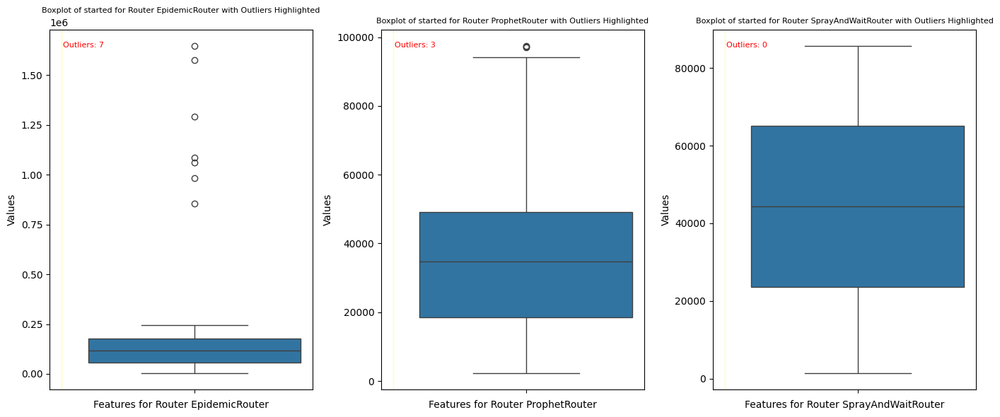

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['started'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['started'].quantile(0.25)
    q3 = df[df['router'] == router]['started'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['started'] < lower_bound) | (df['started'] > upper_bound))]['started']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of started for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


4.Relayed



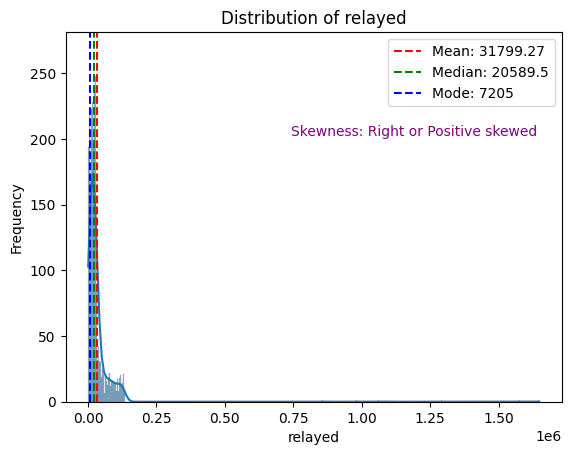

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['relayed'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of relayed')
plt.xlabel('relayed')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['relayed'].mean()
median_value = df['relayed'].median()
mode_value = df['relayed'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['relayed'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()


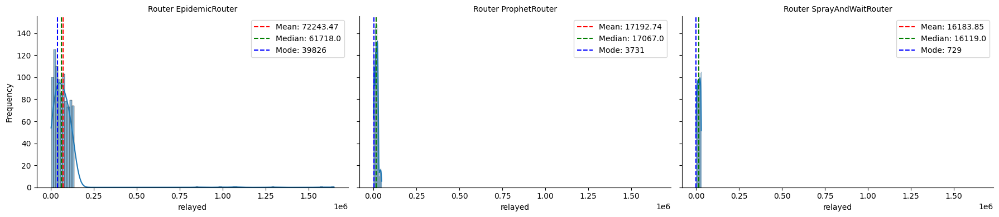

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'relayed', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("relayed", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['relayed'].mean()
    median_value = df[df['router'] == router]['relayed'].median()
    mode_value = df[df['router'] == router]['relayed'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


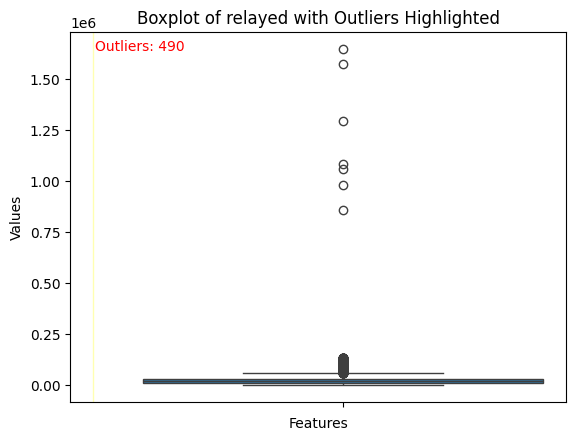

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['relayed'])

# Calculate the number of outliers
q1 = df['relayed'].quantile(0.25)
q3 = df['relayed'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['relayed'] < lower_bound) | (df['relayed'] > upper_bound)]['relayed']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of relayed with Outliers Highlighted')
plt.show()


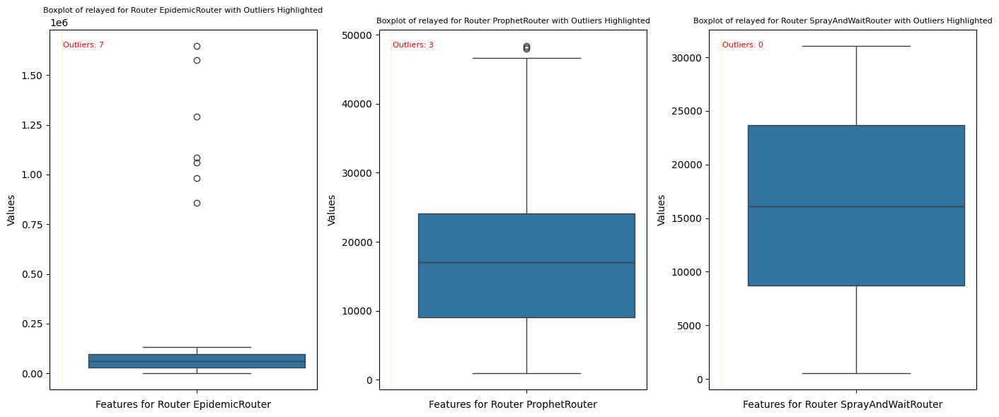

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['relayed'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['relayed'].quantile(0.25)
    q3 = df[df['router'] == router]['relayed'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['relayed'] < lower_bound) | (df['relayed'] > upper_bound))]['relayed']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of relayed for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


5.Aborted



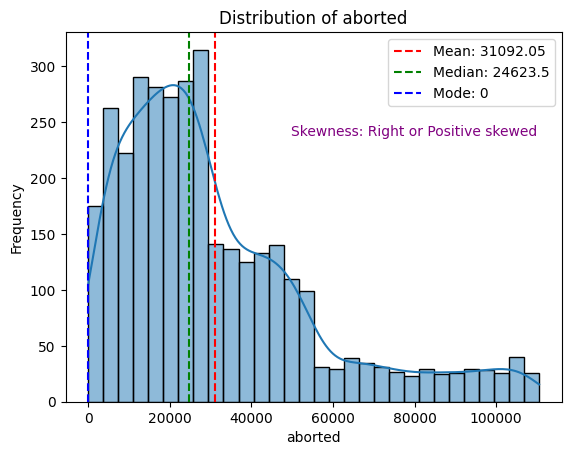

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['aborted'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of aborted')
plt.xlabel('aborted')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['aborted'].mean()
median_value = df['aborted'].median()
mode_value = df['aborted'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['aborted'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()


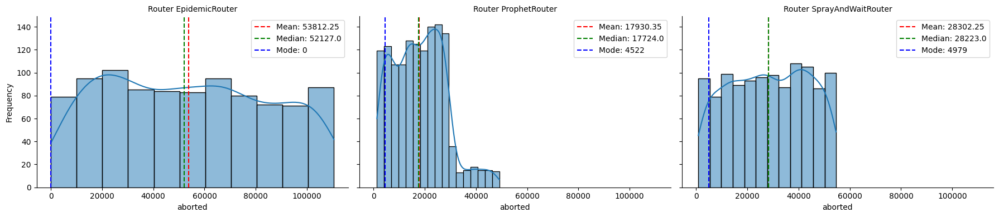

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'aborted', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("aborted", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['aborted'].mean()
    median_value = df[df['router'] == router]['aborted'].median()
    mode_value = df[df['router'] == router]['aborted'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


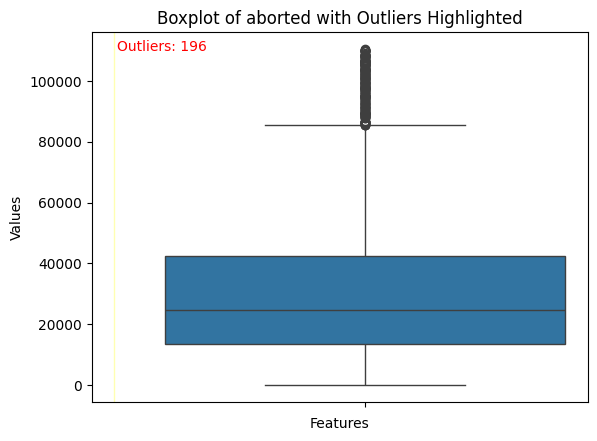

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['aborted'])

# Calculate the number of outliers
q1 = df['aborted'].quantile(0.25)
q3 = df['aborted'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['aborted'] < lower_bound) | (df['aborted'] > upper_bound)]['aborted']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of aborted with Outliers Highlighted')
plt.show()


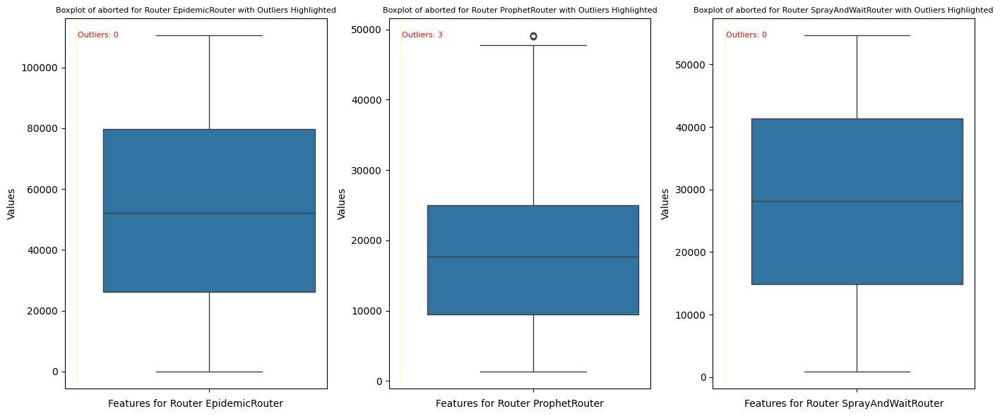

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['aborted'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['aborted'].quantile(0.25)
    q3 = df[df['router'] == router]['aborted'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['aborted'] < lower_bound) | (df['aborted'] > upper_bound))]['aborted']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of aborted for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


6.Dropped



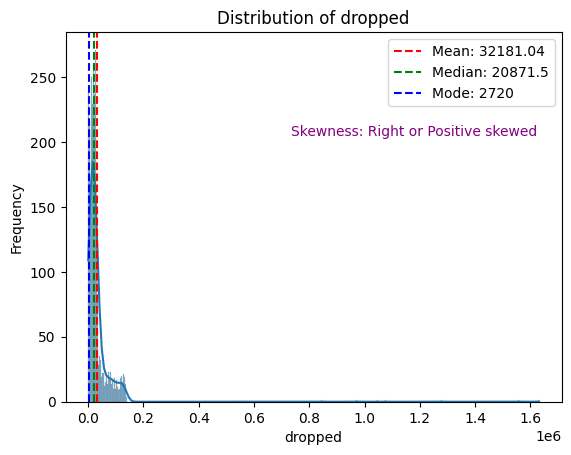

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['dropped'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of dropped')
plt.xlabel('dropped')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['dropped'].mean()
median_value = df['dropped'].median()
mode_value = df['dropped'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['dropped'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()


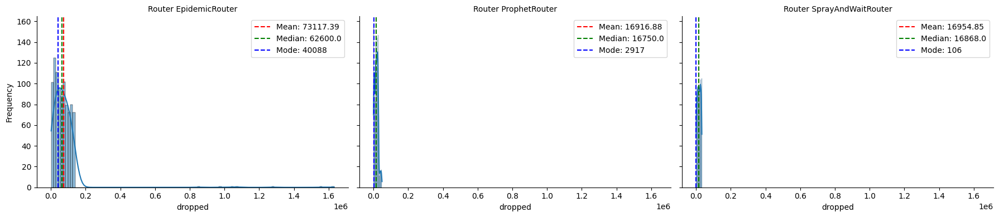

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'dropped', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("dropped", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['dropped'].mean()
    median_value = df[df['router'] == router]['dropped'].median()
    mode_value = df[df['router'] == router]['dropped'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


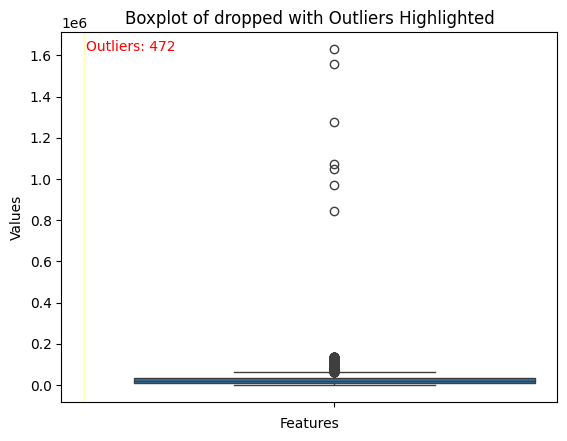

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['dropped'])

# Calculate the number of outliers
q1 = df['dropped'].quantile(0.25)
q3 = df['dropped'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['dropped'] < lower_bound) | (df['dropped'] > upper_bound)]['dropped']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of dropped with Outliers Highlighted')
plt.show()


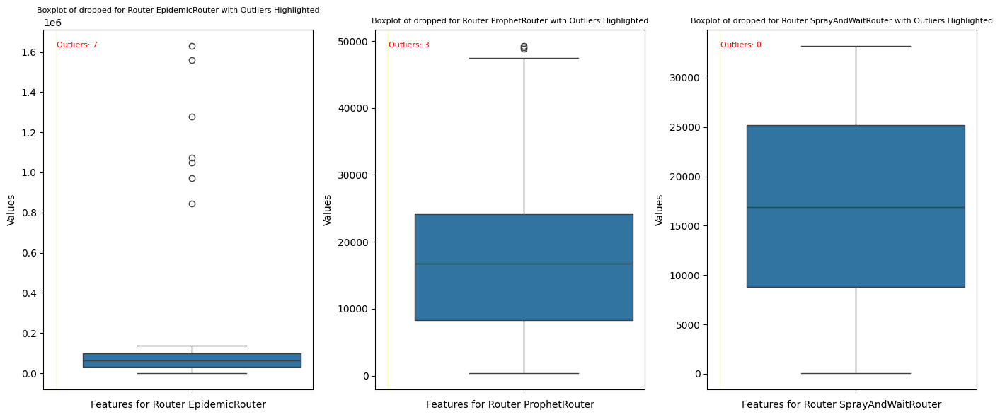

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['dropped'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['dropped'].quantile(0.25)
    q3 = df[df['router'] == router]['dropped'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['dropped'] < lower_bound) | (df['dropped'] > upper_bound))]['dropped']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of dropped for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


7.Delivered



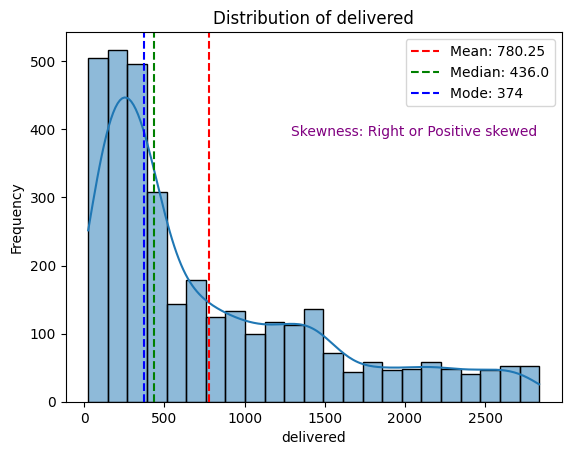

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['delivered'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of delivered')
plt.xlabel('delivered')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['delivered'].mean()
median_value = df['delivered'].median()
mode_value = df['delivered'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['delivered'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()


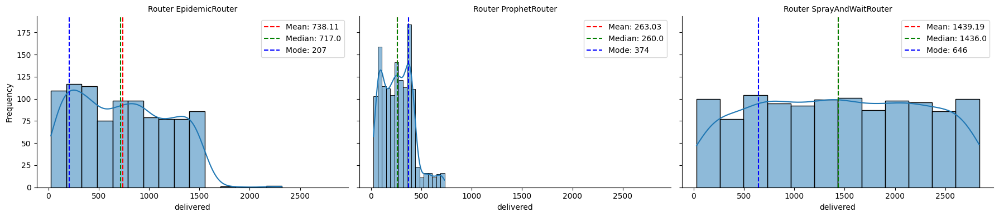

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'delivered', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("delivered", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['delivered'].mean()
    median_value = df[df['router'] == router]['delivered'].median()
    mode_value = df[df['router'] == router]['delivered'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


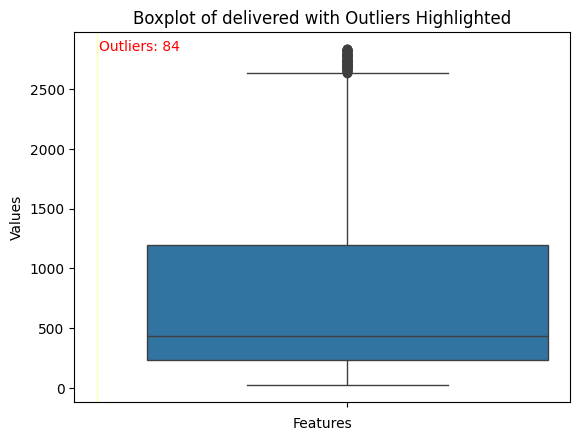

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['delivered'])

# Calculate the number of outliers
q1 = df['delivered'].quantile(0.25)
q3 = df['delivered'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['delivered'] < lower_bound) | (df['delivered'] > upper_bound)]['delivered']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of delivered with Outliers Highlighted')
plt.show()


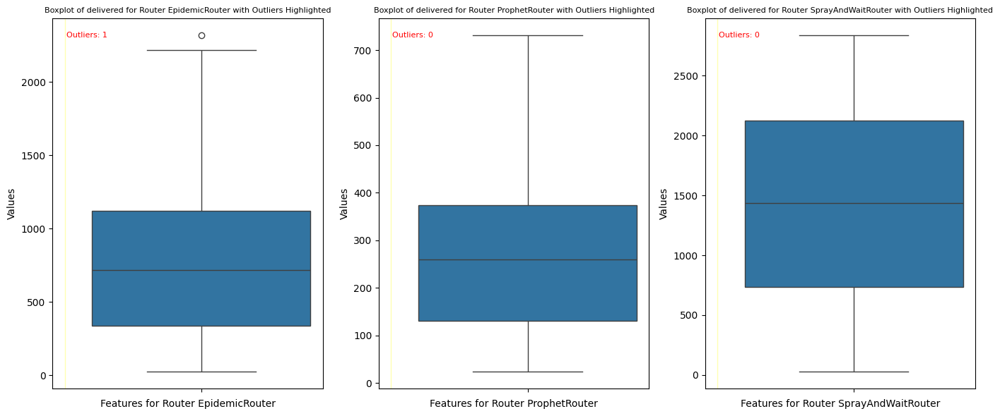

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['delivered'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['delivered'].quantile(0.25)
    q3 = df[df['router'] == router]['delivered'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['delivered'] < lower_bound) | (df['delivered'] > upper_bound))]['delivered']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of delivered for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


8.Delivery_prob

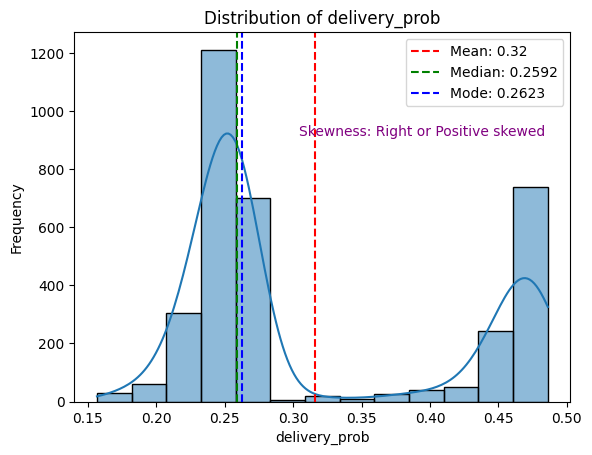

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['delivery_prob'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of delivery_prob')
plt.xlabel('delivery_prob')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['delivery_prob'].mean()
median_value = df['delivery_prob'].median()
mode_value = df['delivery_prob'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['delivery_prob'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()


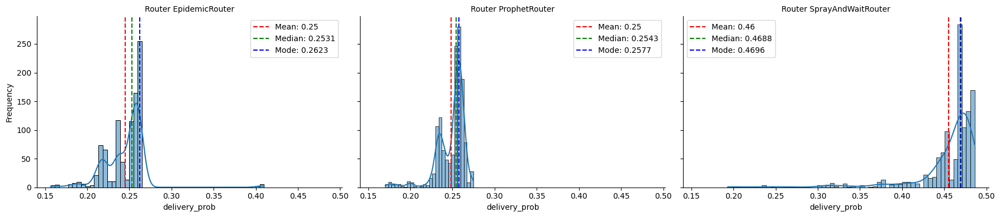

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'delivery_prob', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("delivery_prob", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['delivery_prob'].mean()
    median_value = df[df['router'] == router]['delivery_prob'].median()
    mode_value = df[df['router'] == router]['delivery_prob'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


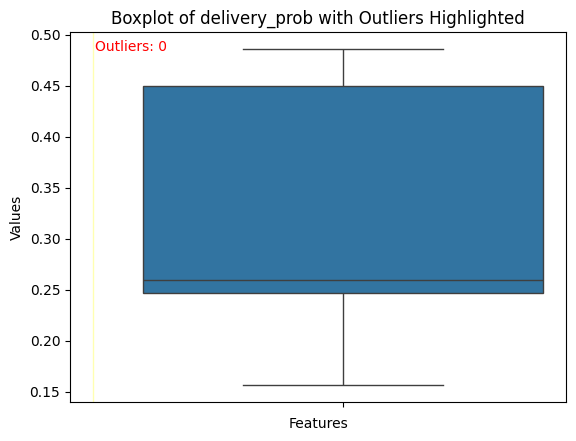

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['delivery_prob'])

# Calculate the number of outliers
q1 = df['delivery_prob'].quantile(0.25)
q3 = df['delivery_prob'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['delivery_prob'] < lower_bound) | (df['delivery_prob'] > upper_bound)]['delivery_prob']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of delivery_prob with Outliers Highlighted')
plt.show()


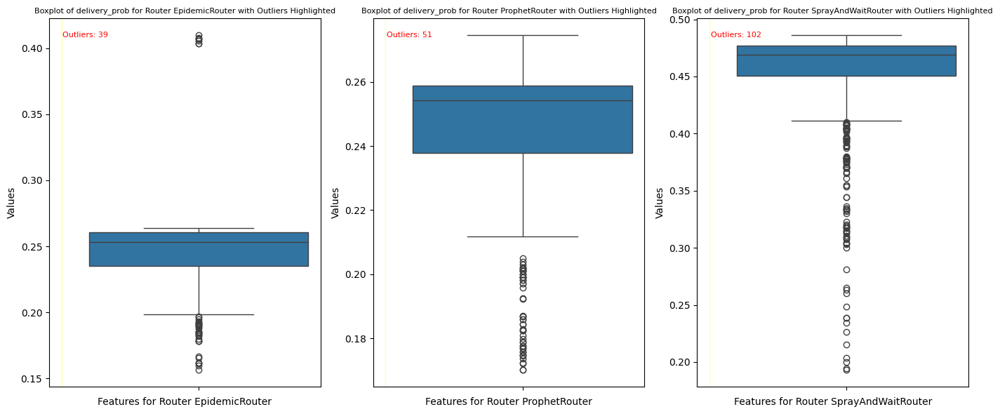

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['delivery_prob'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['delivery_prob'].quantile(0.25)
    q3 = df[df['router'] == router]['delivery_prob'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['delivery_prob'] < lower_bound) | (df['delivery_prob'] > upper_bound))]['delivery_prob']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of delivery_prob for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Loop through each router
for router in unique_routers:
    # Calculate outliers for each router
    q1 = df[df['router'] == router]['delivery_prob'].quantile(0.25)
    q3 = df[df['router'] == router]['delivery_prob'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr

    # Remove outliers
    df = df.drop(df[(df['router'] == router) & ((df['delivery_prob'] < lower_bound) | (df['delivery_prob'] > upper_bound))].index)

# Now df contains data with outliers removed


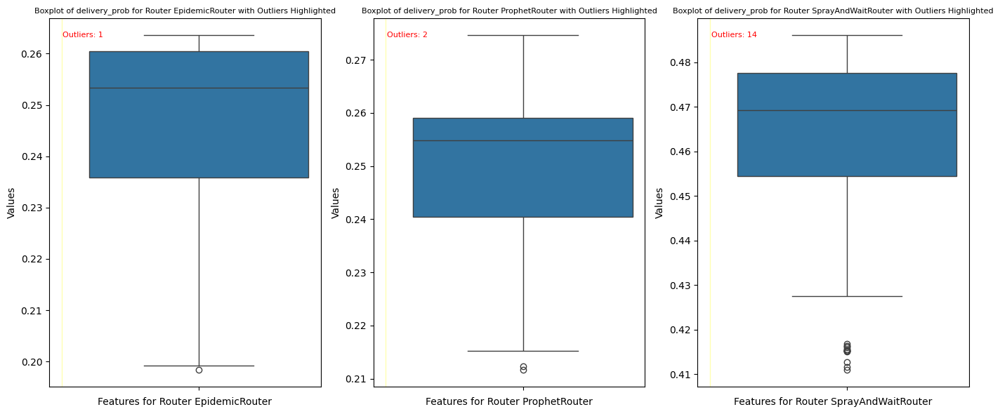

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['delivery_prob'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['delivery_prob'].quantile(0.25)
    q3 = df[df['router'] == router]['delivery_prob'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['delivery_prob'] < lower_bound) | (df['delivery_prob'] > upper_bound))]['delivery_prob']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of delivery_prob for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
df.shape

(3246, 16)

<ipython-input-190-b2cbb0705a76>:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()


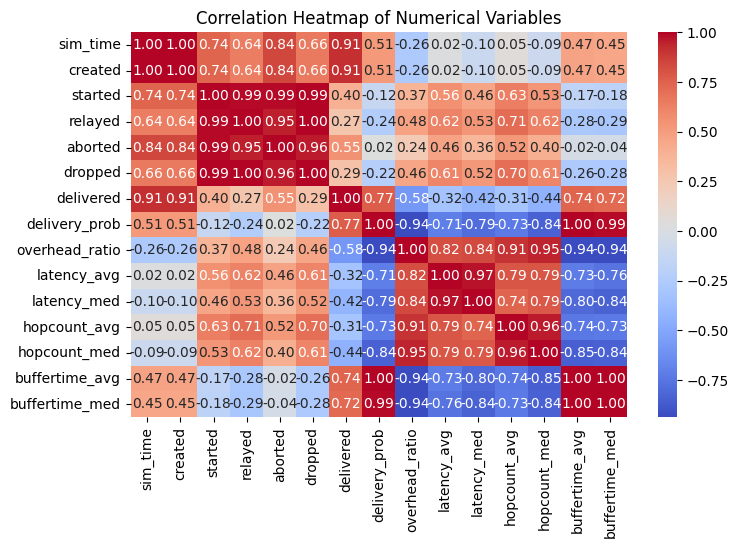

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Compute the correlation matrix
corr_matrix = df.corr()

# Plot heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap of Numerical Variables')
plt.show()


9.Overhead_ratio

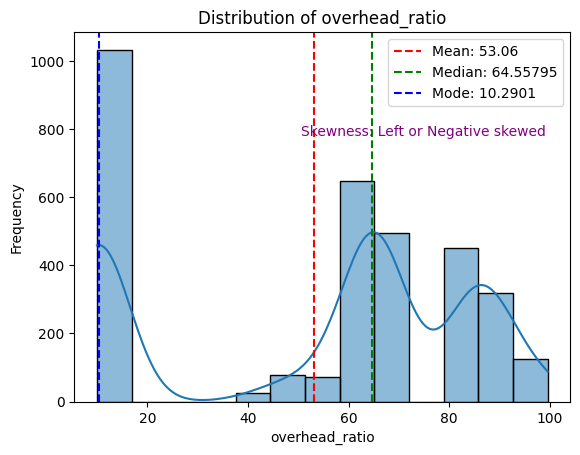

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['overhead_ratio'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of overhead_ratio')
plt.xlabel('overhead_ratio')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['overhead_ratio'].mean()
median_value = df['overhead_ratio'].median()
mode_value = df['overhead_ratio'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['overhead_ratio'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()


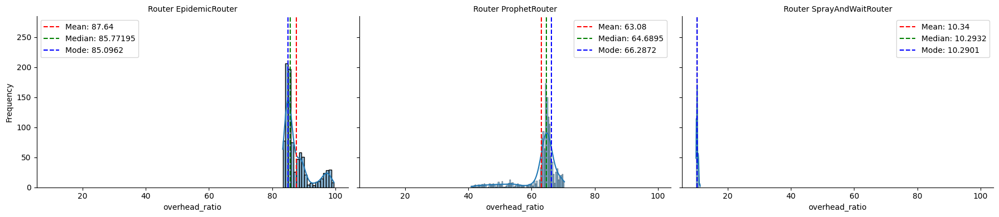

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'overhead_ratio', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("overhead_ratio", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['overhead_ratio'].mean()
    median_value = df[df['router'] == router]['overhead_ratio'].median()
    mode_value = df[df['router'] == router]['overhead_ratio'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


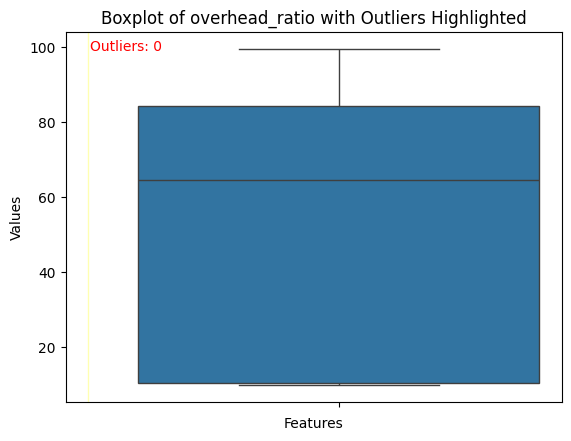

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['overhead_ratio'])

# Calculate the number of outliers
q1 = df['overhead_ratio'].quantile(0.25)
q3 = df['overhead_ratio'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['overhead_ratio'] < lower_bound) | (df['overhead_ratio'] > upper_bound)]['overhead_ratio']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of overhead_ratio with Outliers Highlighted')
plt.show()


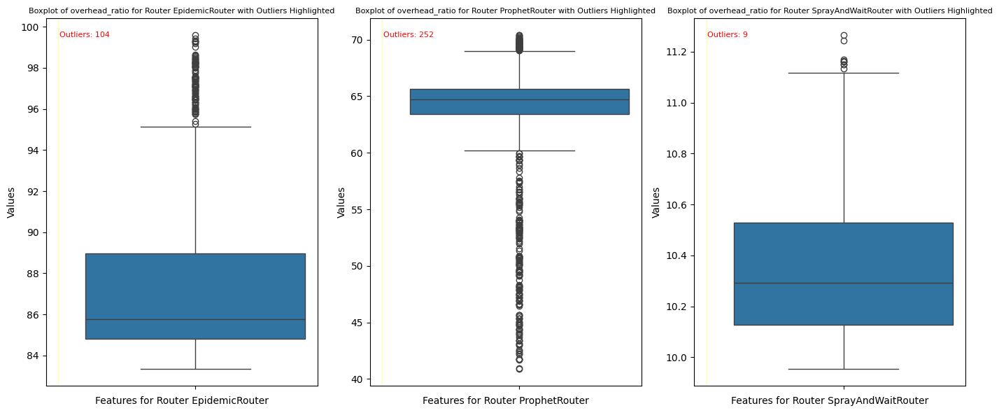

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['overhead_ratio'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['overhead_ratio'].quantile(0.25)
    q3 = df[df['router'] == router]['overhead_ratio'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['overhead_ratio'] < lower_bound) | (df['overhead_ratio'] > upper_bound))]['overhead_ratio']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of overhead_ratio for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


#If we delite the outliers the correlation of the dataset is not perfect. It is not neceassry to remove the outliers.

In [ ]:
df.shape

(3246, 16)

10.Latency_avg


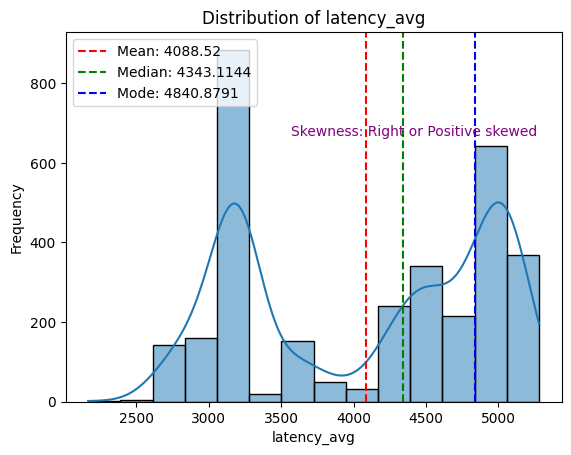

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['latency_avg'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of latency_avg')
plt.xlabel('latency_avg')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['latency_avg'].mean()
median_value = df['latency_avg'].median()
mode_value = df['latency_avg'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['created'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()


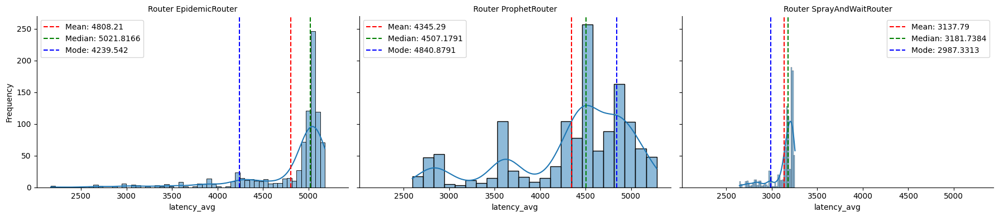

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'latency_avg', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("latency_avg", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['latency_avg'].mean()
    median_value = df[df['router'] == router]['latency_avg'].median()
    mode_value = df[df['router'] == router]['latency_avg'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


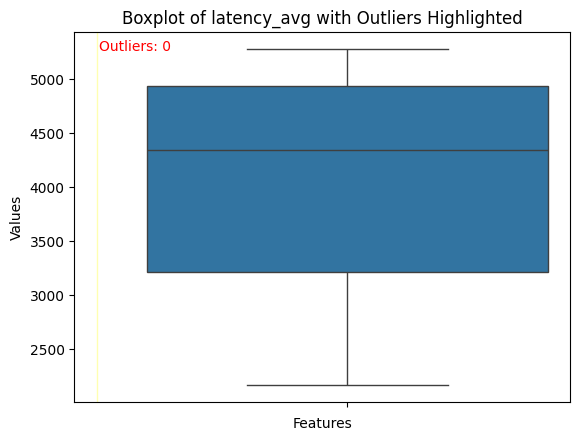

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['latency_avg'])

# Calculate the number of outliers
q1 = df['latency_avg'].quantile(0.25)
q3 = df['latency_avg'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['latency_avg'] < lower_bound) | (df['latency_avg'] > upper_bound)]['latency_avg']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of latency_avg with Outliers Highlighted')
plt.show()


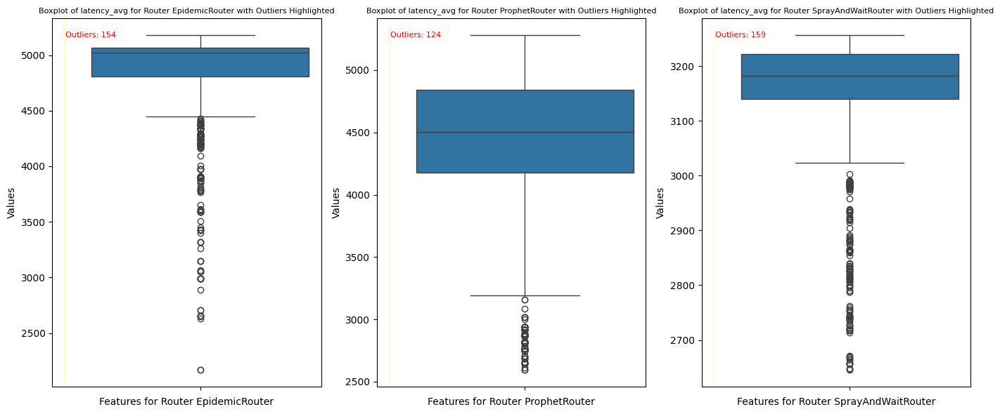

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['latency_avg'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['latency_avg'].quantile(0.25)
    q3 = df[df['router'] == router]['latency_avg'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['latency_avg'] < lower_bound) | (df['latency_avg'] > upper_bound))]['latency_avg']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of latency_avg for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Loop through each router
for router in unique_routers:
    # Calculate outliers for each router
    q1 = df[df['router'] == router]['latency_avg'].quantile(0.25)
    q3 = df[df['router'] == router]['latency_avg'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr

    # Remove outliers
    df = df.drop(df[(df['router'] == router) & ((df['latency_avg'] < lower_bound) | (df['latency_avg'] > upper_bound))].index)

# Now df contains data with outliers removed


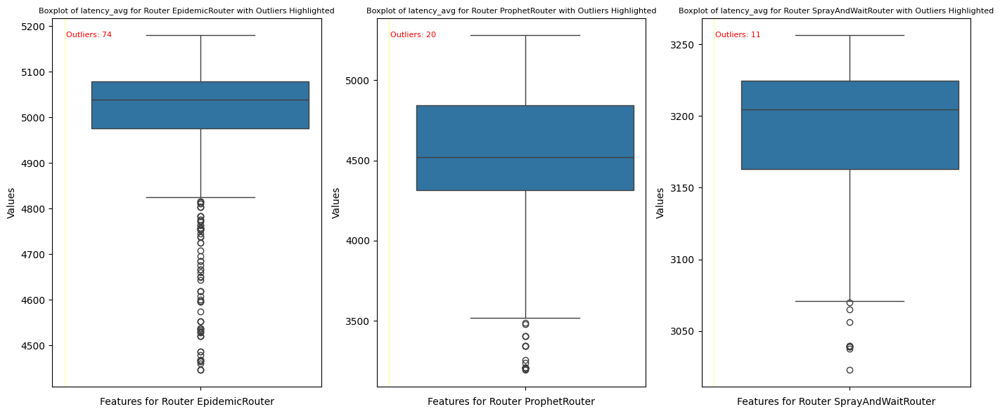

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['latency_avg'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['latency_avg'].quantile(0.25)
    q3 = df[df['router'] == router]['latency_avg'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['latency_avg'] < lower_bound) | (df['latency_avg'] > upper_bound))]['latency_avg']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of latency_avg for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
df.shape

(2809, 16)

<ipython-input-203-b2cbb0705a76>:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()


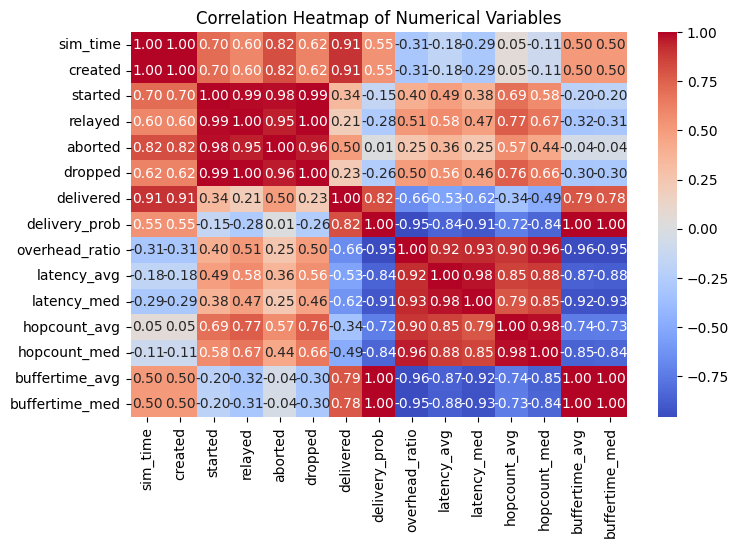

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Compute the correlation matrix
corr_matrix = df.corr()

# Plot heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap of Numerical Variables')
plt.show()


11.Latency_med

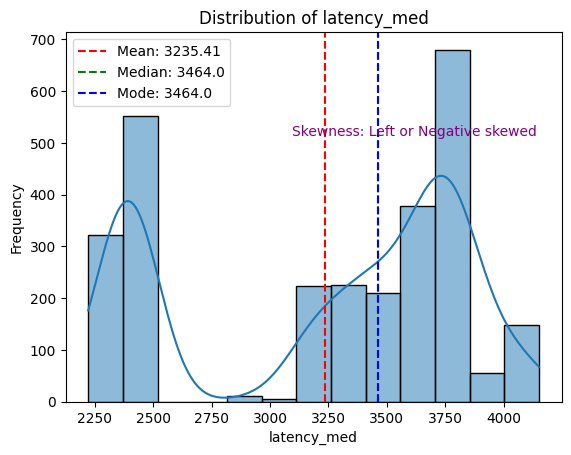

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['latency_med'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of latency_med')
plt.xlabel('latency_med')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['latency_med'].mean()
median_value = df['latency_med'].median()
mode_value = df['latency_med'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['latency_med'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()


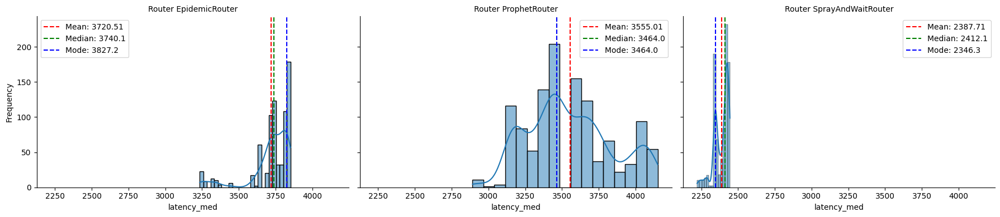

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'latency_med', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("latency_med", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['latency_med'].mean()
    median_value = df[df['router'] == router]['latency_med'].median()
    mode_value = df[df['router'] == router]['latency_med'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


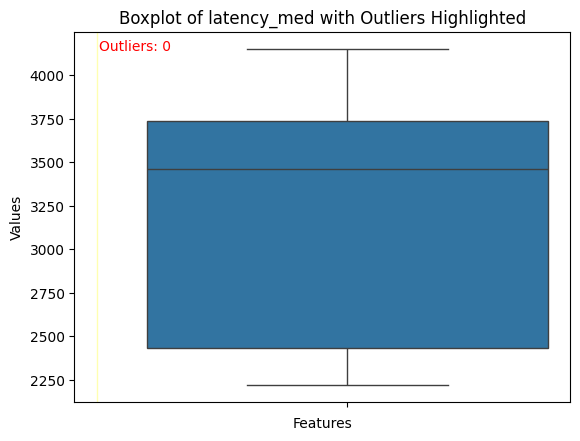

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['latency_med'])

# Calculate the number of outliers
q1 = df['latency_med'].quantile(0.25)
q3 = df['latency_med'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['latency_med'] < lower_bound) | (df['latency_med'] > upper_bound)]['latency_med']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of latency_med with Outliers Highlighted')
plt.show()


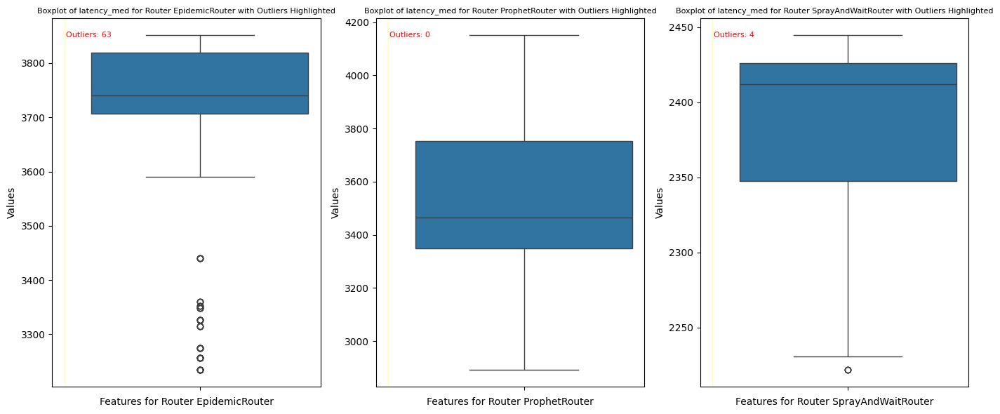

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['latency_med'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['latency_med'].quantile(0.25)
    q3 = df[df['router'] == router]['latency_med'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['latency_med'] < lower_bound) | (df['latency_med'] > upper_bound))]['latency_med']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of latency_med for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Loop through each router
for router in unique_routers:
    # Calculate outliers for each router
    q1 = df[df['router'] == router]['latency_med'].quantile(0.25)
    q3 = df[df['router'] == router]['latency_med'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr

    # Remove outliers
    df = df.drop(df[(df['router'] == router) & ((df['latency_med'] < lower_bound) | (df['latency_med'] > upper_bound))].index)

# Now df contains data with outliers removed


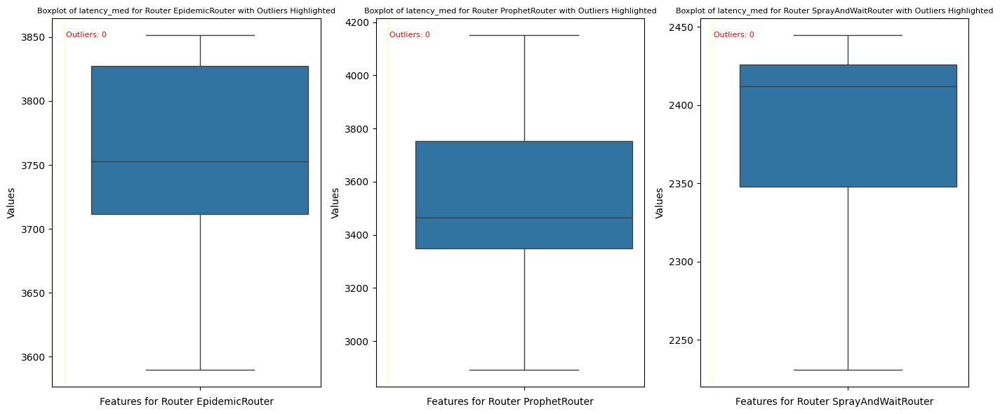

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['latency_med'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['latency_med'].quantile(0.25)
    q3 = df[df['router'] == router]['latency_med'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['latency_med'] < lower_bound) | (df['latency_med'] > upper_bound))]['latency_med']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of latency_med for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
df.shape

(2742, 16)

<ipython-input-211-b2cbb0705a76>:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()


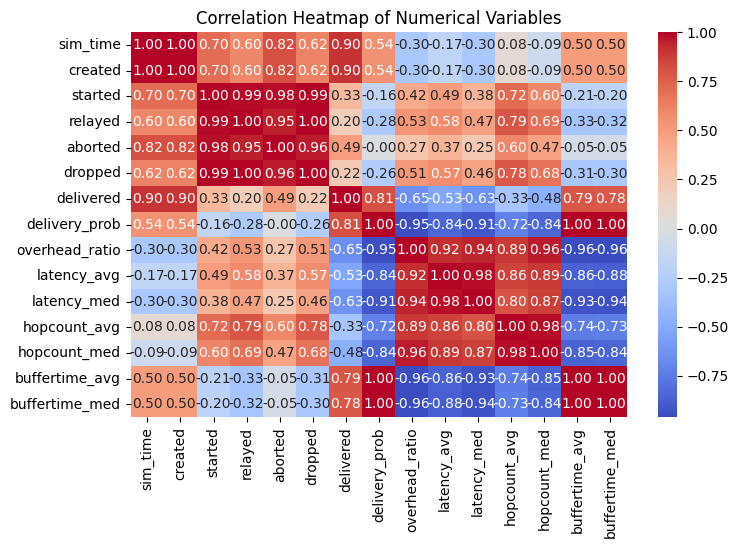

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Compute the correlation matrix
corr_matrix = df.corr()

# Plot heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap of Numerical Variables')
plt.show()


12.Hopcount_avg

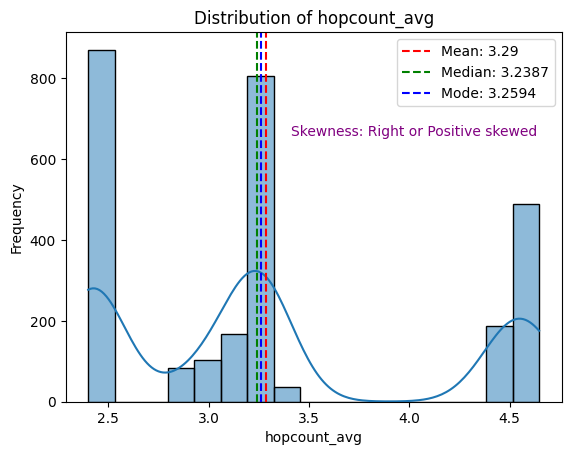

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['hopcount_avg'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of hopcount_avg')
plt.xlabel('hopcount_avg')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['hopcount_avg'].mean()
median_value = df['hopcount_avg'].median()
mode_value = df['hopcount_avg'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['hopcount_avg'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()


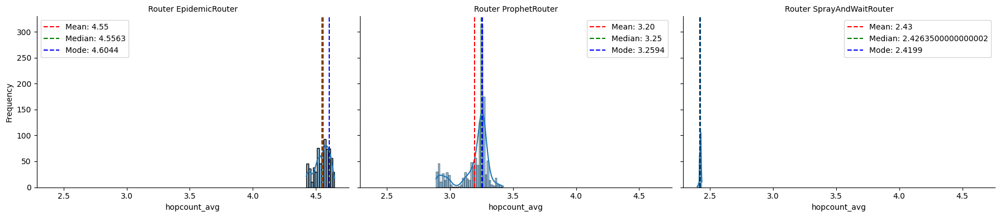

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'hopcount_avg', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("hopcount_avg", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['hopcount_avg'].mean()
    median_value = df[df['router'] == router]['hopcount_avg'].median()
    mode_value = df[df['router'] == router]['hopcount_avg'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


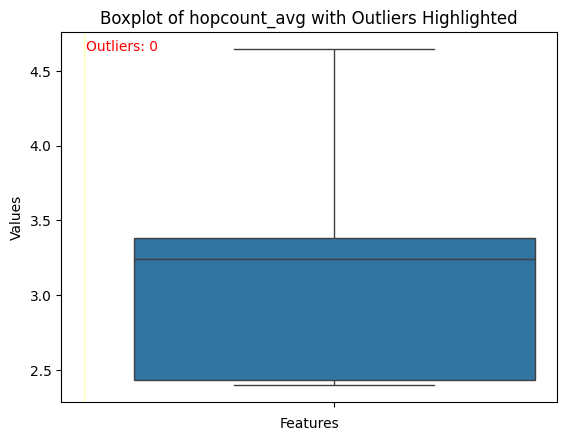

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['hopcount_avg'])

# Calculate the number of outliers
q1 = df['hopcount_avg'].quantile(0.25)
q3 = df['hopcount_avg'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['hopcount_avg'] < lower_bound) | (df['hopcount_avg'] > upper_bound)]['hopcount_avg']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of hopcount_avg with Outliers Highlighted')
plt.show()


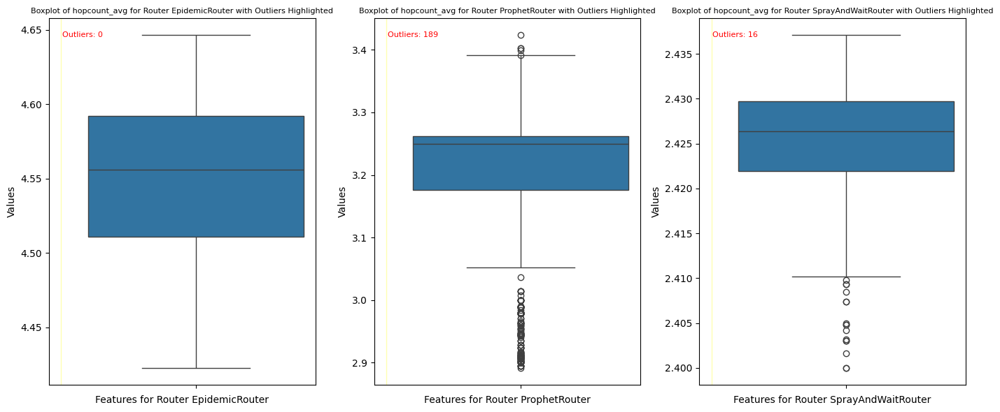

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['hopcount_avg'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['hopcount_avg'].quantile(0.25)
    q3 = df[df['router'] == router]['hopcount_avg'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['hopcount_avg'] < lower_bound) | (df['hopcount_avg'] > upper_bound))]['hopcount_avg']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of hopcount_avg for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


13.Hopcount_med

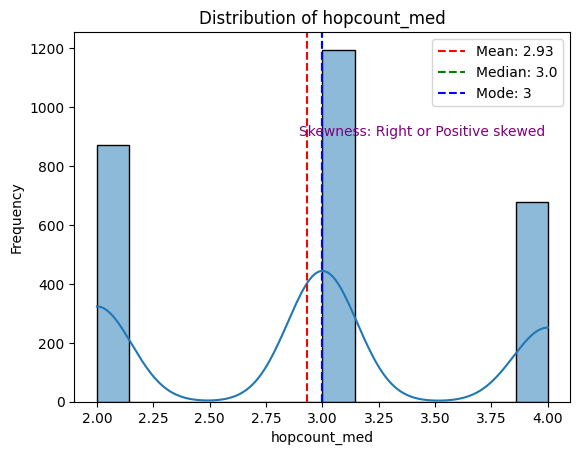

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['hopcount_med'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of hopcount_med')
plt.xlabel('hopcount_med')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['hopcount_med'].mean()
median_value = df['hopcount_med'].median()
mode_value = df['hopcount_med'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['hopcount_med'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()


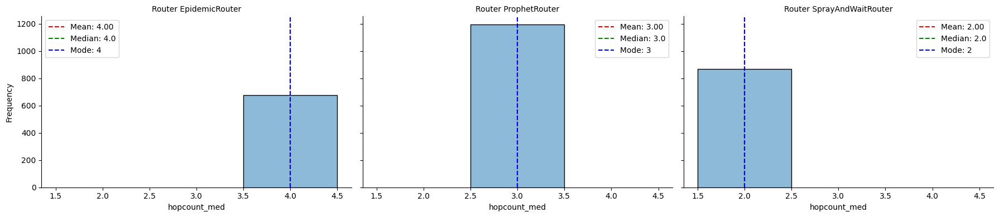

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'hopcount_med', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("hopcount_med", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['hopcount_med'].mean()
    median_value = df[df['router'] == router]['hopcount_med'].median()
    mode_value = df[df['router'] == router]['hopcount_med'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


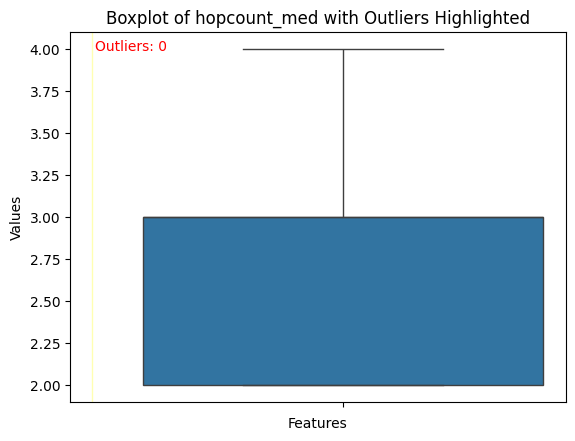

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['hopcount_med'])

# Calculate the number of outliers
q1 = df['hopcount_med'].quantile(0.25)
q3 = df['hopcount_med'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['hopcount_med'] < lower_bound) | (df['hopcount_med'] > upper_bound)]['hopcount_med']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of hopcount_med with Outliers Highlighted')
plt.show()


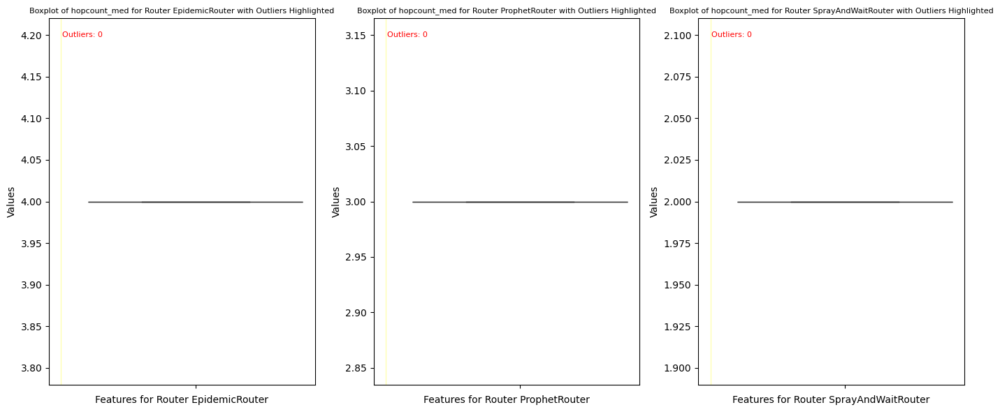

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['hopcount_med'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['hopcount_med'].quantile(0.25)
    q3 = df[df['router'] == router]['hopcount_med'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['hopcount_med'] < lower_bound) | (df['hopcount_med'] > upper_bound))]['hopcount_med']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of hopcount_med for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
print(list(df['hopcount_med']))

[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 

14.Buffertime_avg

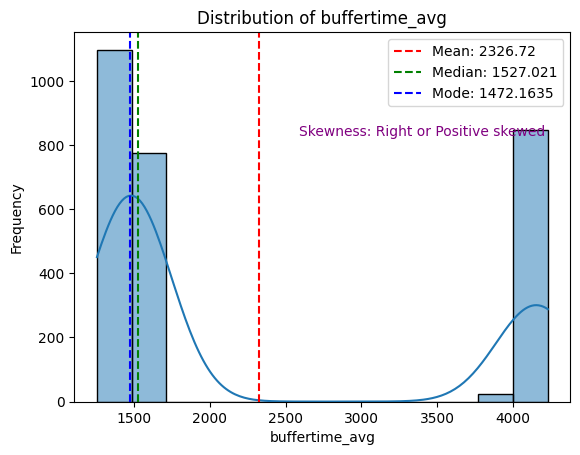

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['buffertime_avg'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of buffertime_avg')
plt.xlabel('buffertime_avg')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['buffertime_avg'].mean()
median_value = df['buffertime_avg'].median()
mode_value = df['buffertime_avg'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['buffertime_avg'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()

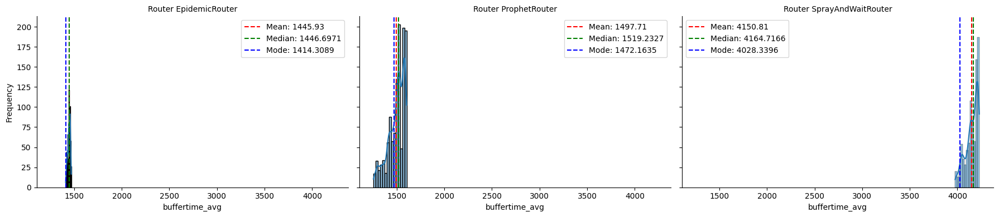

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'buffertime_avg', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("buffertime_avg", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['buffertime_avg'].mean()
    median_value = df[df['router'] == router]['buffertime_avg'].median()
    mode_value = df[df['router'] == router]['buffertime_avg'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


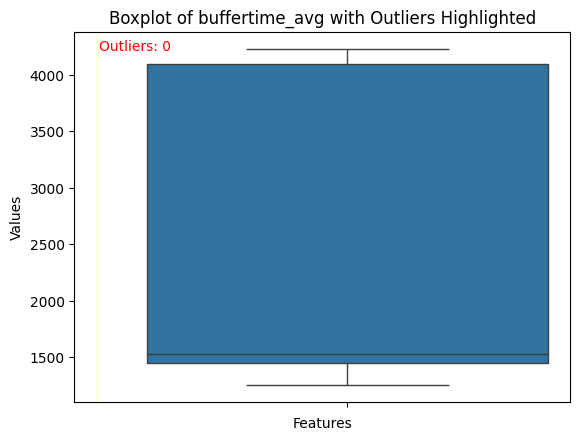

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['buffertime_avg'])

# Calculate the number of outliers
q1 = df['buffertime_avg'].quantile(0.25)
q3 = df['buffertime_avg'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['buffertime_avg'] < lower_bound) | (df['buffertime_avg'] > upper_bound)]['buffertime_avg']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of buffertime_avg with Outliers Highlighted')
plt.show()

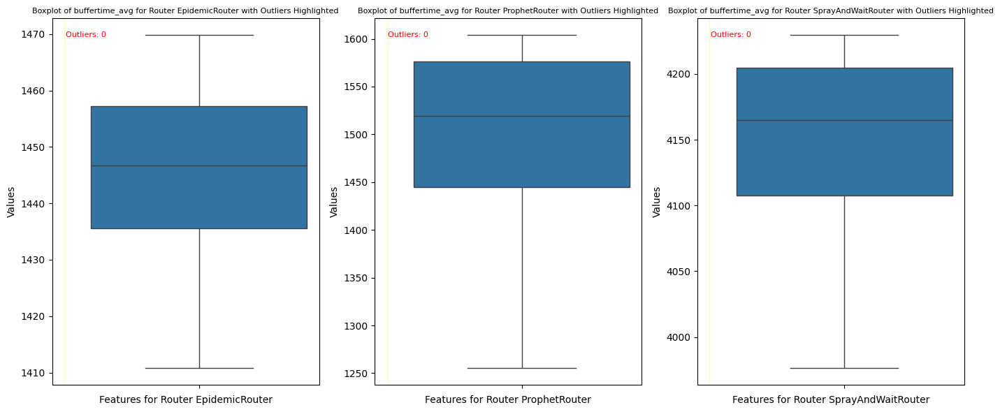

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['buffertime_avg'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['buffertime_avg'].quantile(0.25)
    q3 = df[df['router'] == router]['buffertime_avg'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['buffertime_avg'] < lower_bound) | (df['buffertime_avg'] > upper_bound))]['buffertime_avg']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of buffertime_avg for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


15.Buffertime_med

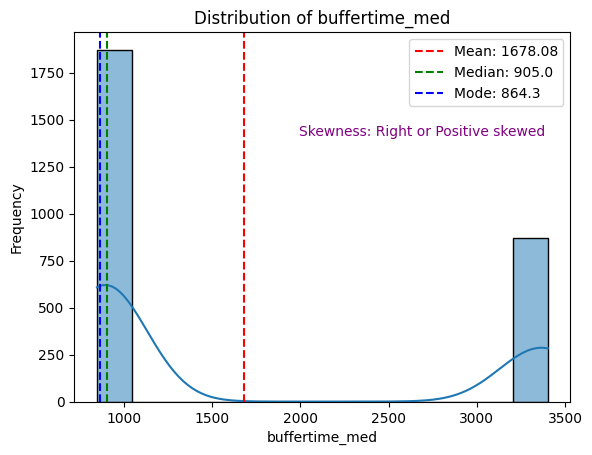

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the histogram
sns.histplot(df['buffertime_med'], kde=True)  # Using histplot instead of distplot for newer versions of Seaborn
plt.title('Distribution of buffertime_med')
plt.xlabel('buffertime_med')
plt.ylabel('Frequency')

# Calculate mean, median, and mode
mean_value = df['buffertime_med'].mean()
median_value = df['buffertime_med'].median()
mode_value = df['buffertime_med'].mode().values[0]  # mode() returns a series, take the first value

# Annotate the mean, median, and mode values onto the plot
plt.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
plt.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
plt.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

# Determine skewness
skewness = df['buffertime_med'].skew()
skew_label = 'Right or Positive skewed' if skewness > 0 else 'Left or Negative skewed' if skewness < 0 else 'Symmetric'

# Annotate skewness type
plt.text(0.95, 0.75, f'Skewness: {skew_label}', transform=plt.gca().transAxes, ha='right', va='top', fontsize=10, color='purple')

# Display the legend
plt.legend()
plt.show()

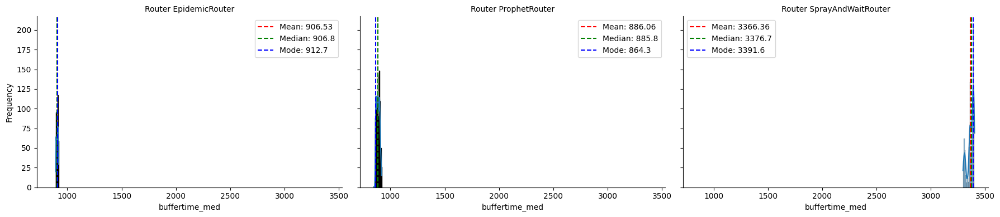

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a FacetGrid for each router
g = sns.FacetGrid(df, col="router", col_wrap=3, height=4, aspect=1.5)
g.map(sns.histplot, 'buffertime_med', kde=True)

# Set titles
g.set_titles("Router {col_name}")
g.set_axis_labels("buffertime_med", "Frequency")

# Calculate mean, median, and mode for each router
for router, ax in g.axes_dict.items():
    mean_value = df[df['router'] == router]['buffertime_med'].mean()
    median_value = df[df['router'] == router]['buffertime_med'].median()
    mode_value = df[df['router'] == router]['buffertime_med'].mode().values[0]

    # Annotate the mean, median, and mode values onto each plot
    ax.axvline(mean_value, color='r', linestyle='--', label=f'Mean: {mean_value:.2f}')
    ax.axvline(median_value, color='g', linestyle='--', label=f'Median: {median_value}')
    ax.axvline(mode_value, color='b', linestyle='--', label=f'Mode: {mode_value}')

    # Display legend
    ax.legend()

plt.show()


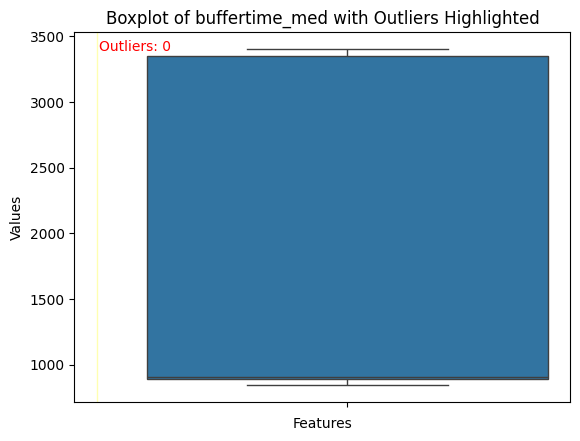

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Create the boxplot
sns.boxplot(data=df['buffertime_med'])

# Calculate the number of outliers
q1 = df['buffertime_med'].quantile(0.25)
q3 = df['buffertime_med'].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df['buffertime_med'] < lower_bound) | (df['buffertime_med'] > upper_bound)]['buffertime_med']

# Annotate the number of outliers
plt.annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=10, color='red')

# Highlight outliers with colored box on the left
plt.axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

plt.xlabel('Features')
plt.ylabel('Values')
plt.title('Boxplot of buffertime_med with Outliers Highlighted')
plt.show()

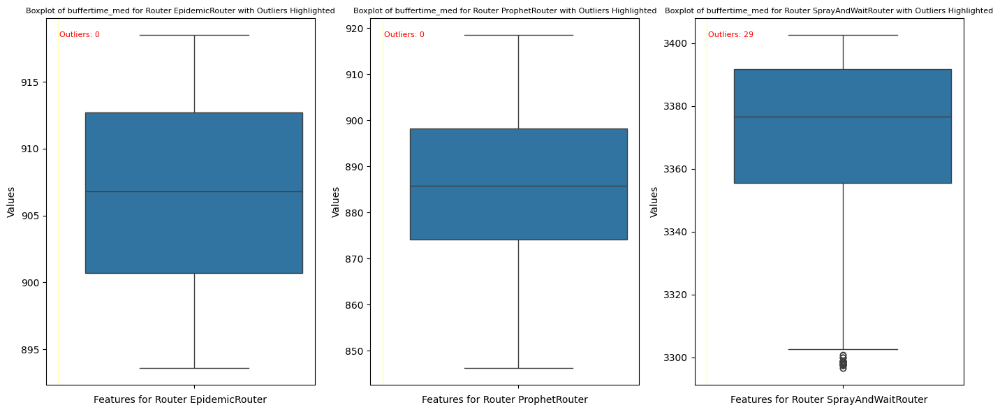

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df contains the data with a column 'router_id' for each router
unique_routers = df['router'].unique()

# Define the number of rows and columns for subplots
num_rows = 1
num_cols = len(unique_routers)

# Create subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(14, 6))

# Loop through each router and create a boxplot
for i, router in enumerate(unique_routers):
    sns.boxplot(data=df[df['router'] == router]['buffertime_med'], ax=axs[i])

    # Calculate outliers for each router
    q1 = df[df['router'] == router]['buffertime_med'].quantile(0.25)
    q3 = df[df['router'] == router]['buffertime_med'].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = df[(df['router'] == router) & ((df['buffertime_med'] < lower_bound) | (df['buffertime_med'] > upper_bound))]['buffertime_med']

    # Annotate the number of outliers for each router
    axs[i].annotate(f'Outliers: {len(outliers)}', xy=(0.05, 0.95), xycoords='axes fraction', ha='left', fontsize=8, color='red')

    # Highlight outliers with colored box on the left for each router
    axs[i].axvspan(-0.5, -0.5, color='yellow', alpha=0.3)  # Adjust the x-limits as needed

    axs[i].set_xlabel(f'Features for Router {router}')
    axs[i].set_ylabel('Values')
    axs[i].set_title(f'Boxplot of buffertime_med for Router {router} with Outliers Highlighted',fontsize=8)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
df.shape

(2742, 16)

<ipython-input-231-b2cbb0705a76>:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()


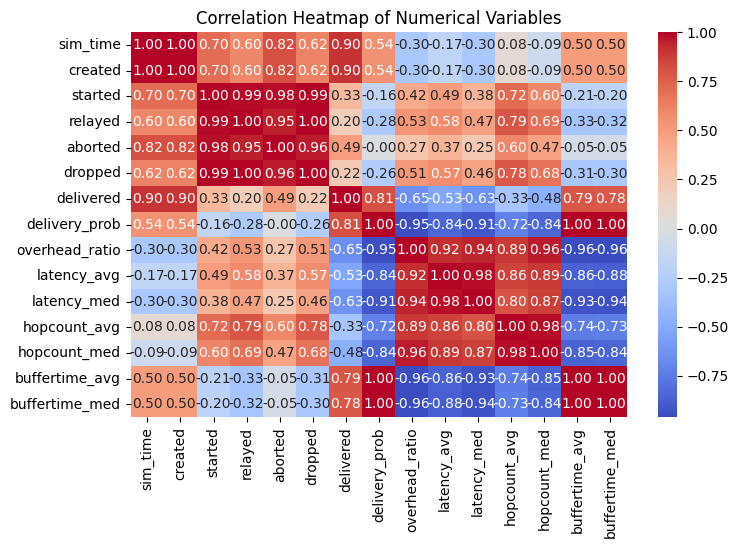

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Compute the correlation matrix
corr_matrix = df.corr()

# Plot heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap of Numerical Variables')
plt.show()


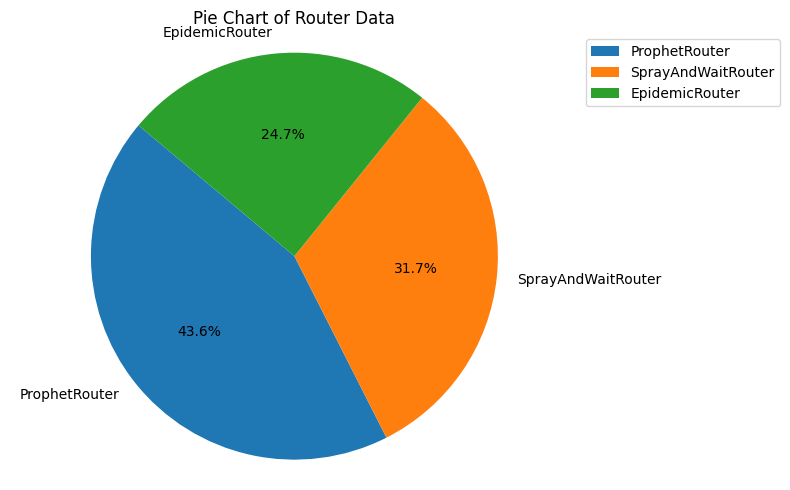

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt


# Get unique router names and their counts
router_counts = df['router'].value_counts()
router_names = router_counts.index
router_values = router_counts.values

# Plotting Pie Chart
plt.figure(figsize=(8, 5))
plt.pie(router_values, labels=router_names, autopct='%1.1f%%', startangle=140, colors=plt.cm.tab10.colors)
plt.title('Pie Chart of Router Data')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

# Adding a legend outside the plot
plt.legend(bbox_to_anchor=(1, 1), loc='upper left')

plt.tight_layout()
plt.show()


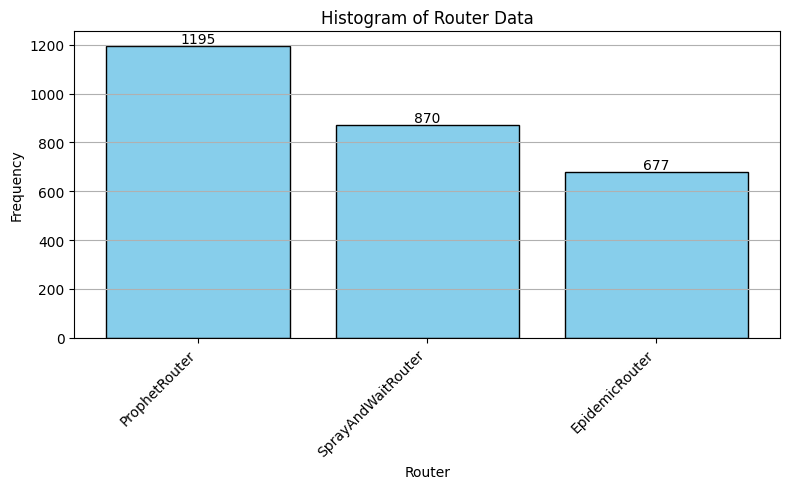

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt


# Get unique router names and their counts
router_counts = df['router'].value_counts()
router_names = router_counts.index
router_values = router_counts.values

# Plotting Histogram with Router Names and Counts
plt.figure(figsize=(8, 5))
plt.bar(router_names, router_values, color='skyblue', edgecolor='black')
plt.title('Histogram of Router Data')
plt.xlabel('Router')
plt.ylabel('Frequency')
plt.xticks(rotation=45, ha='right')  # Rotate labels for better readability
for i, v in enumerate(router_values):
    plt.text(i, v + 0.1, str(v), ha='center', va='bottom')  # Display count above each bar
plt.grid(axis='y')
plt.tight_layout()
plt.show()


In [ ]:
df['router'].replace(['EpidemicRouter','ProphetRouter','SprayAndWaitRouter'],
                        [0, 1,2], inplace=True)

df.head()

,router,sim_time,created,started,relayed,aborted,dropped,delivered,delivery_prob,overhead_ratio,latency_avg,latency_med,hopcount_avg,hopcount_med,buffertime_avg,buffertime_med
1,0,115152.0,3891,159376,86029,73345,87680,993,0.2552,85.6354,5131.5297,3828.2,4.5690,4,1458.6536,917.7
2,0,75628.1,2559,102958,54645,48308,55388,645,0.2521,83.7209,5002.0574,3647.2,4.4481,4,1465.2708,913.3
3,0,166516.0,5631,234747,128346,106395,131290,1478,0.2625,85.8376,5034.4916,3780.7,4.5825,4,1443.0280,900.6
4,0,153002.0,5172,215752,117985,97766,120645,1353,0.2616,86.2025,5044.7681,3740.1,4.6105,4,1432.6003,897.2
12,0,63075.1,2134,85612,45650,39960,46154,510,0.2390,88.5098,4941.2594,3833.2,4.5686,4,1432.4102,903.1


In [ ]:
df.columns

Index(['router', 'sim_time', 'created', 'started', 'relayed', 'aborted',
       'dropped', 'delivered', 'delivery_prob', 'overhead_ratio',
       'latency_avg', 'latency_med', 'hopcount_avg', 'hopcount_med',
       'buffertime_avg', 'buffertime_med'],
      dtype='object')

#Will be added 2D and 3D plot


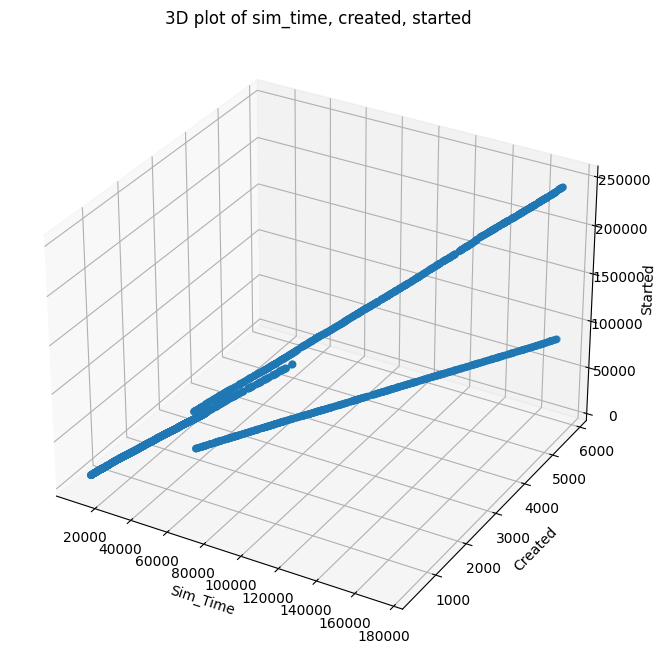

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['sim_time'], df['created'], df['started'])
ax.set_title("3D plot of sim_time, created, started")
ax.set_xlabel('Sim_Time')
ax.set_ylabel('Created')
ax.set_zlabel('Started')

plt.show()

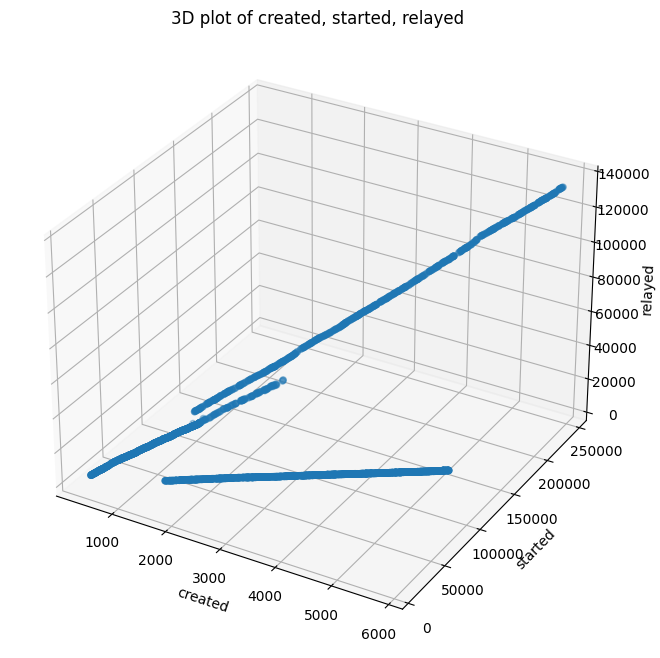

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['created'], df['started'], df['relayed'])
ax.set_title("3D plot of created, started, relayed")
ax.set_xlabel('created')
ax.set_ylabel('started')
ax.set_zlabel('relayed')

plt.show()

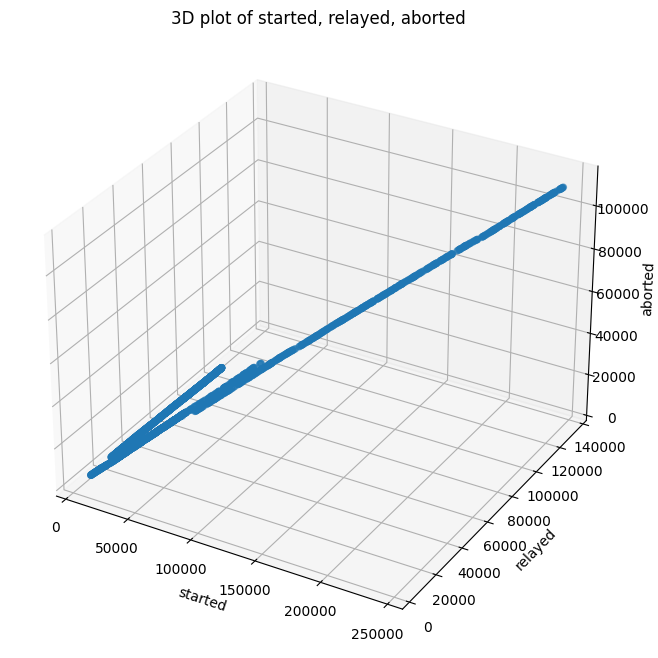

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['started'], df['relayed'], df['aborted'])
ax.set_title("3D plot of started, relayed, aborted")
ax.set_xlabel('started')
ax.set_ylabel('relayed')
ax.set_zlabel('aborted')

plt.show()


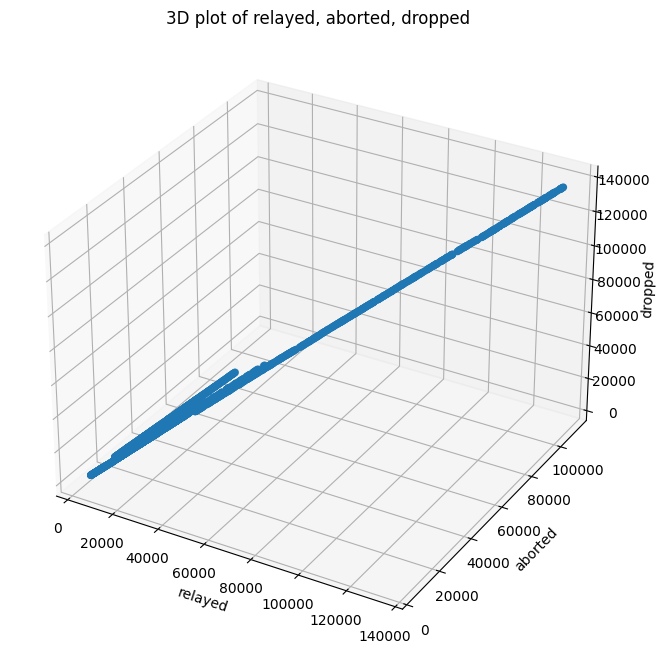

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['relayed'], df['aborted'], df['dropped'])
ax.set_title("3D plot of relayed, aborted, dropped")
ax.set_xlabel('relayed')
ax.set_ylabel('aborted')
ax.set_zlabel('dropped')

plt.show()


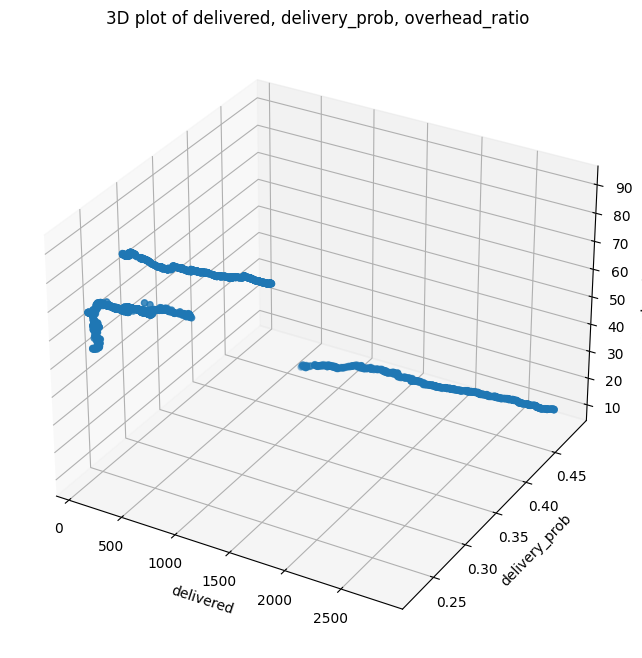

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['delivered'], df['delivery_prob'], df['overhead_ratio'])
ax.set_title("3D plot of delivered, delivery_prob, overhead_ratio")
ax.set_xlabel('delivered')
ax.set_ylabel('delivery_prob')
ax.set_zlabel('overhead_ratio')

plt.show()


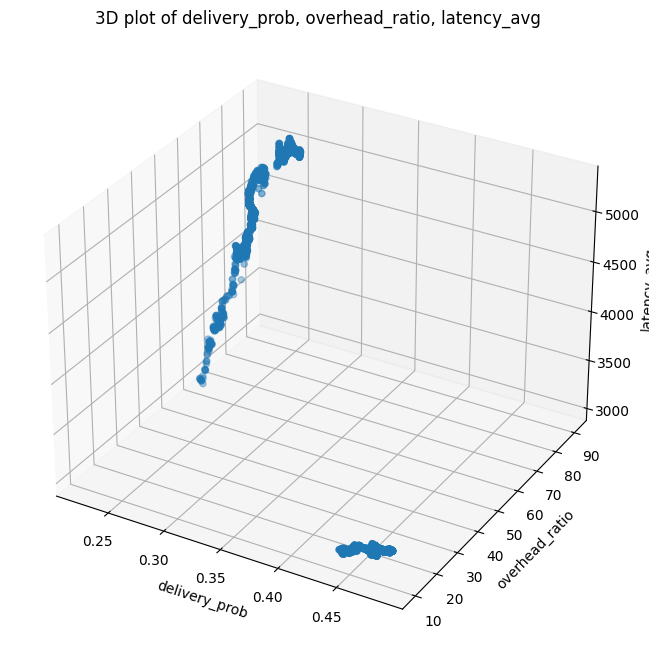

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['delivery_prob'], df['overhead_ratio'], df['latency_avg'])
ax.set_title("3D plot of delivery_prob, overhead_ratio, latency_avg")
ax.set_xlabel('delivery_prob')
ax.set_ylabel('overhead_ratio')
ax.set_zlabel('latency_avg')

plt.show()


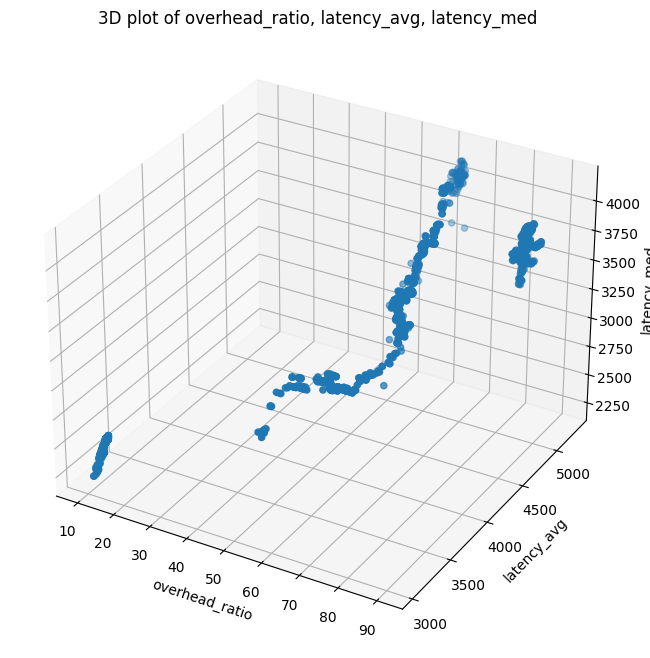

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['overhead_ratio'], df['latency_avg'], df['latency_med'])
ax.set_title("3D plot of overhead_ratio, latency_avg, latency_med")
ax.set_xlabel('overhead_ratio')
ax.set_ylabel('latency_avg')
ax.set_zlabel('latency_med')

plt.show()


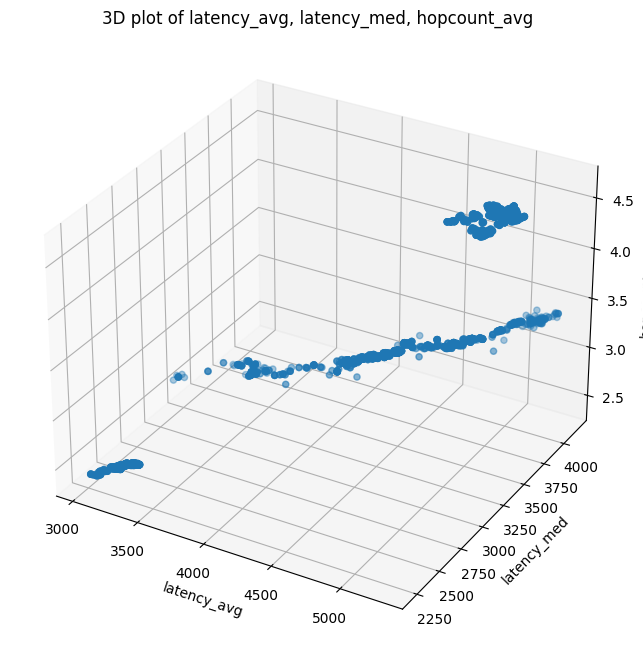

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['latency_avg'], df['latency_med'], df['hopcount_avg'])
ax.set_title("3D plot of latency_avg, latency_med, hopcount_avg")
ax.set_xlabel('latency_avg')
ax.set_ylabel('latency_med')
ax.set_zlabel('hopcount_avg')

plt.show()


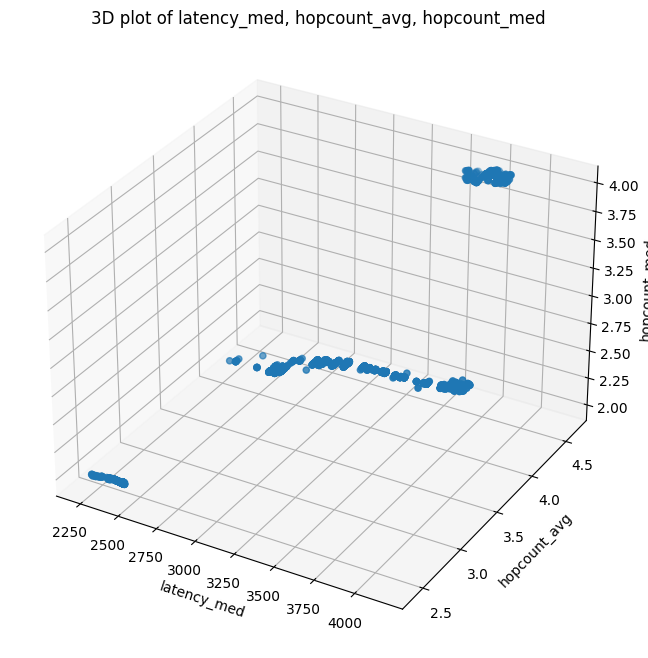

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['latency_med'], df['hopcount_avg'], df['hopcount_med'])
ax.set_title("3D plot of latency_med, hopcount_avg, hopcount_med")
ax.set_xlabel('latency_med')
ax.set_ylabel('hopcount_avg')
ax.set_zlabel('hopcount_med')

plt.show()


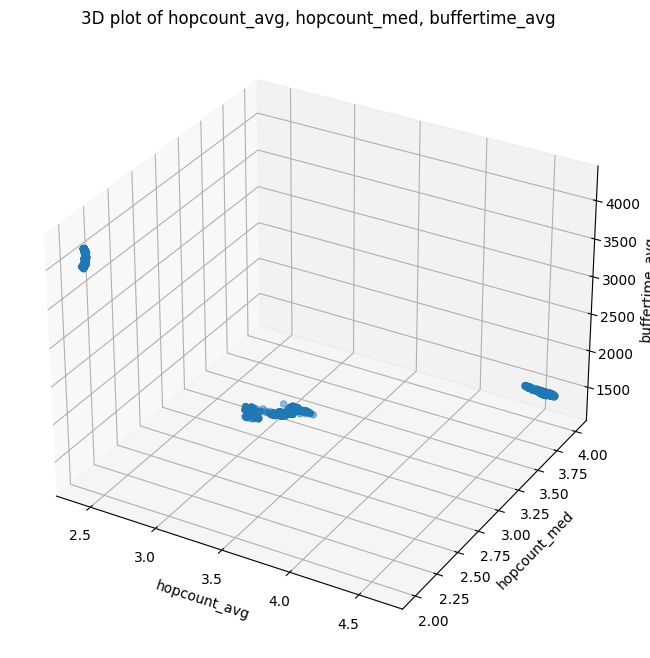

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['hopcount_avg'], df['hopcount_med'], df['buffertime_avg'])
ax.set_title("3D plot of hopcount_avg, hopcount_med, buffertime_avg")
ax.set_xlabel('hopcount_avg')
ax.set_ylabel('hopcount_med')
ax.set_zlabel('buffertime_avg')

plt.show()


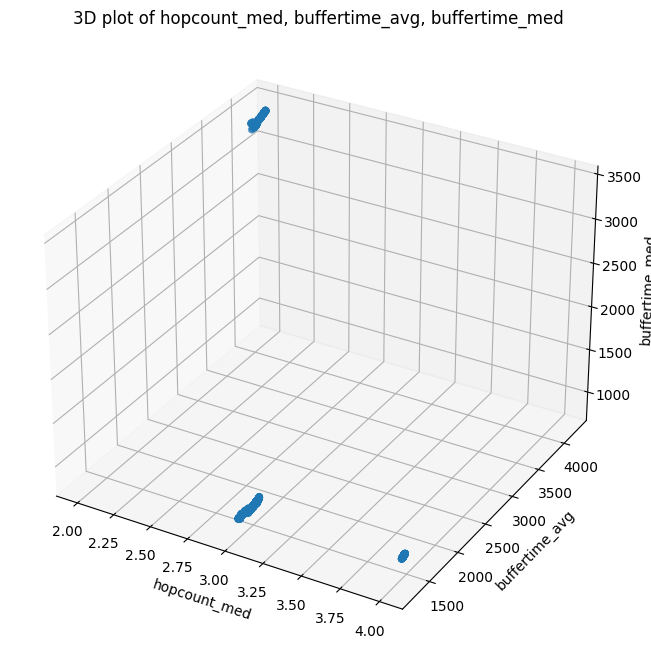

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['hopcount_med'], df['buffertime_avg'], df['buffertime_med'])
ax.set_title("3D plot of hopcount_med, buffertime_avg, buffertime_med")
ax.set_xlabel('hopcount_med')
ax.set_ylabel('buffertime_avg')
ax.set_zlabel('buffertime_med')

plt.show()

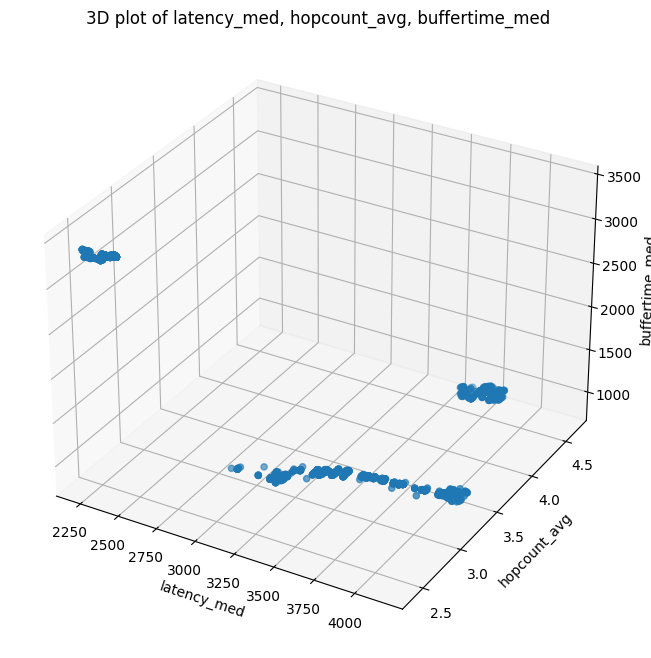

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['latency_med'], df['hopcount_avg'], df['buffertime_med'])
ax.set_title("3D plot of latency_med, hopcount_avg, buffertime_med")

ax.set_xlabel('latency_med')
ax.set_ylabel('hopcount_avg')
ax.set_zlabel('buffertime_med')

plt.show()


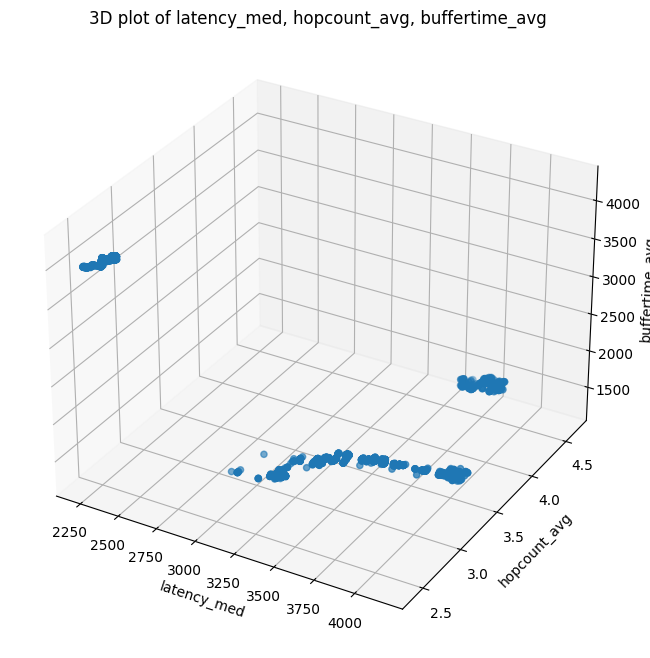

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['latency_med'], df['hopcount_avg'], df['buffertime_avg'])
ax.set_title("3D plot of latency_med, hopcount_avg, buffertime_avg")

ax.set_xlabel('latency_med')
ax.set_ylabel('hopcount_avg')
ax.set_zlabel('buffertime_avg')

plt.show()


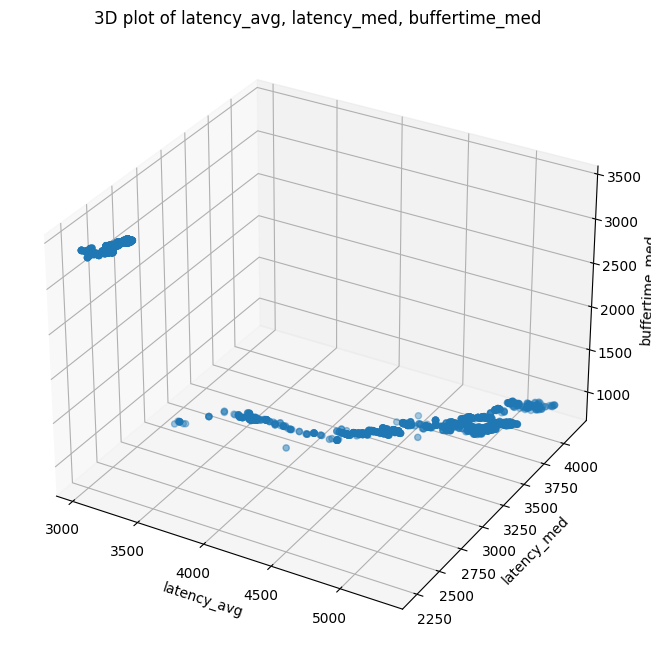

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['latency_avg'], df['latency_med'], df['buffertime_med'])
ax.set_title("3D plot of latency_avg, latency_med, buffertime_med")

ax.set_xlabel('latency_avg')
ax.set_ylabel('latency_med')
ax.set_zlabel('buffertime_med')

plt.show()


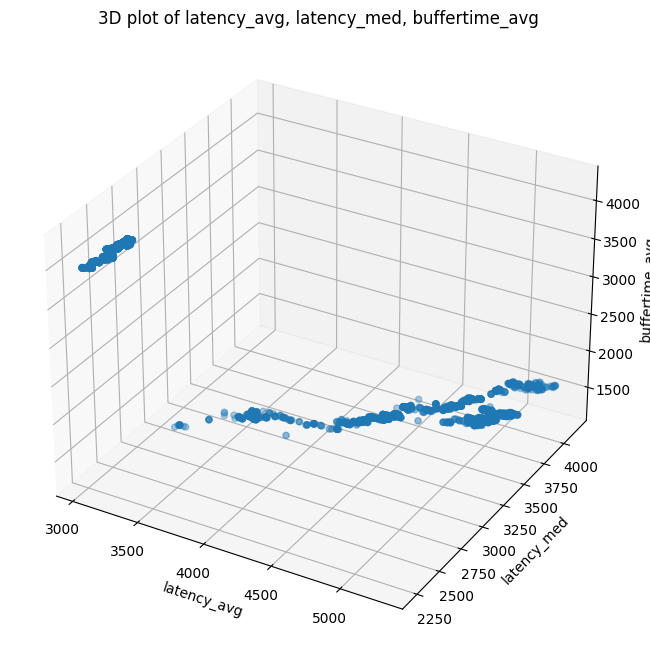

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['latency_avg'], df['latency_med'], df['buffertime_avg'])
ax.set_title("3D plot of latency_avg, latency_med, buffertime_avg")

ax.set_xlabel('latency_avg')
ax.set_ylabel('latency_med')
ax.set_zlabel('buffertime_avg')

plt.show()


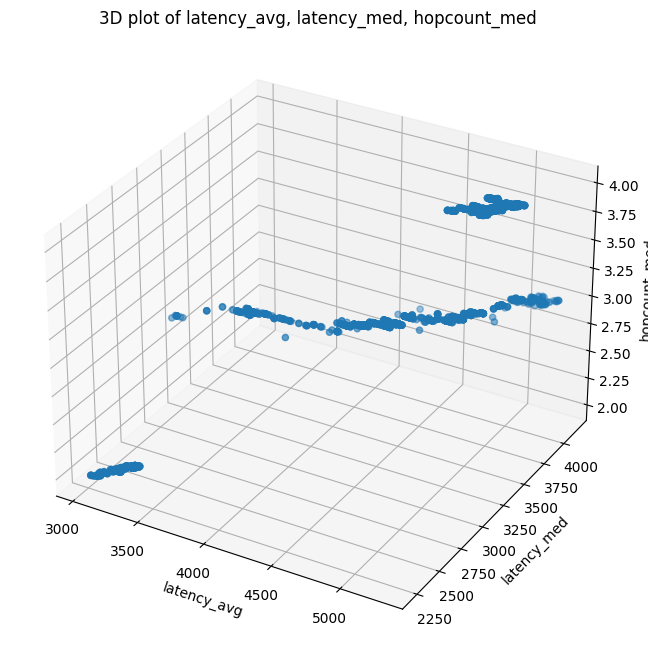

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['latency_avg'], df['latency_med'], df['hopcount_med'])
ax.set_title("3D plot of latency_avg, latency_med, hopcount_med")

ax.set_xlabel('latency_avg')
ax.set_ylabel('latency_med')
ax.set_zlabel('hopcount_med')

plt.show()


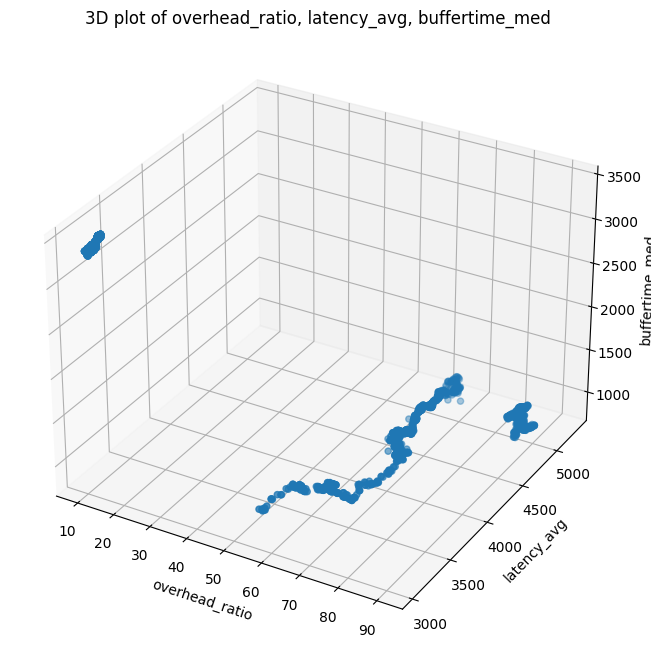

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['overhead_ratio'], df['latency_avg'], df['buffertime_med'])
ax.set_title("3D plot of overhead_ratio, latency_avg, buffertime_med")

ax.set_xlabel('overhead_ratio')
ax.set_ylabel('latency_avg')
ax.set_zlabel('buffertime_med')

plt.show()


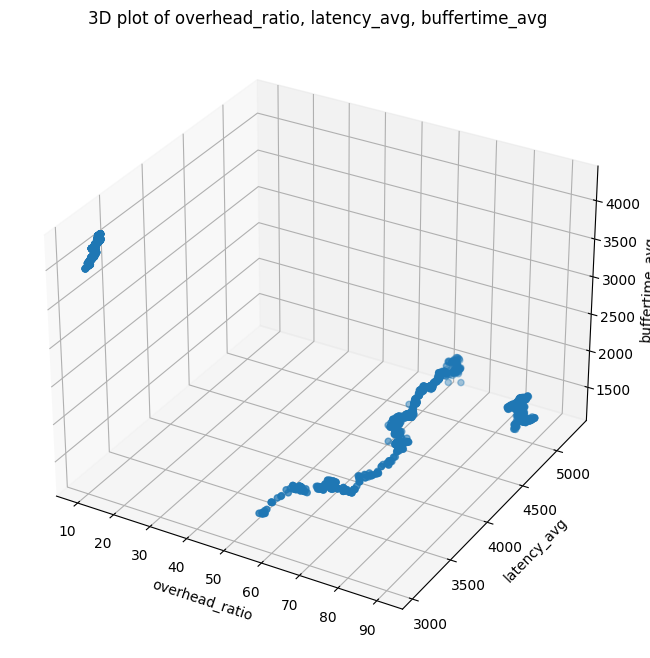

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['overhead_ratio'], df['latency_avg'], df['buffertime_avg'])
ax.set_title("3D plot of overhead_ratio, latency_avg, buffertime_avg")

ax.set_xlabel('overhead_ratio')
ax.set_ylabel('latency_avg')
ax.set_zlabel('buffertime_avg')

plt.show()


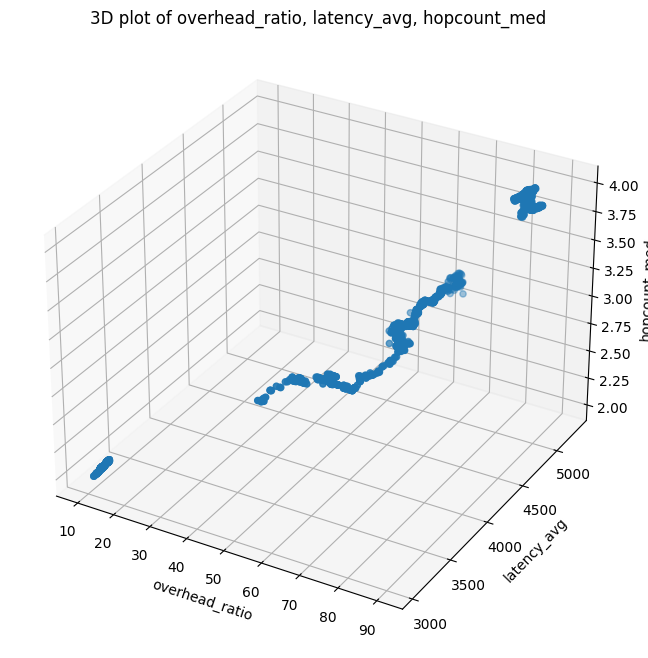

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
('overhead_ratio','latency_avg','hopcount_med')
ax.scatter(df['overhead_ratio'], df['latency_avg'], df['hopcount_med'])
ax.set_title("3D plot of overhead_ratio, latency_avg, hopcount_med")

ax.set_xlabel('overhead_ratio')
ax.set_ylabel('latency_avg')
ax.set_zlabel('hopcount_med')

plt.show()


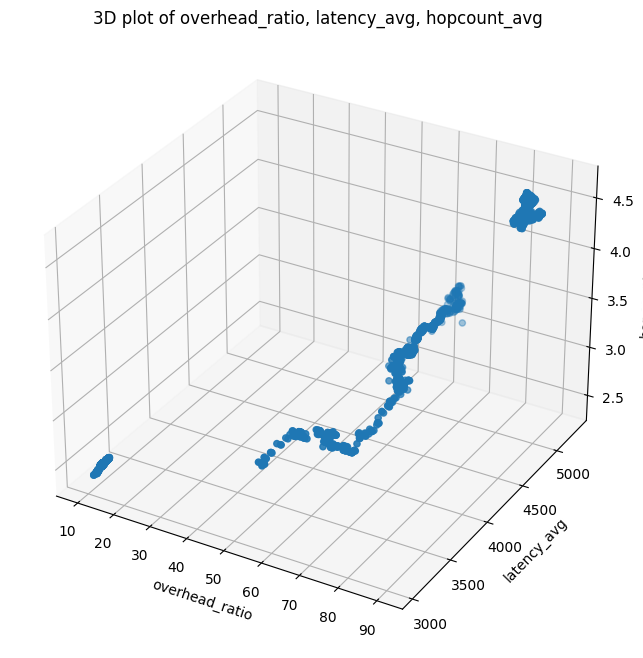

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['overhead_ratio'], df['latency_avg'], df['hopcount_avg'])
ax.set_title("3D plot of overhead_ratio, latency_avg, hopcount_avg")

ax.set_xlabel('overhead_ratio')
ax.set_ylabel('latency_avg')
ax.set_zlabel('hopcount_avg')

plt.show()


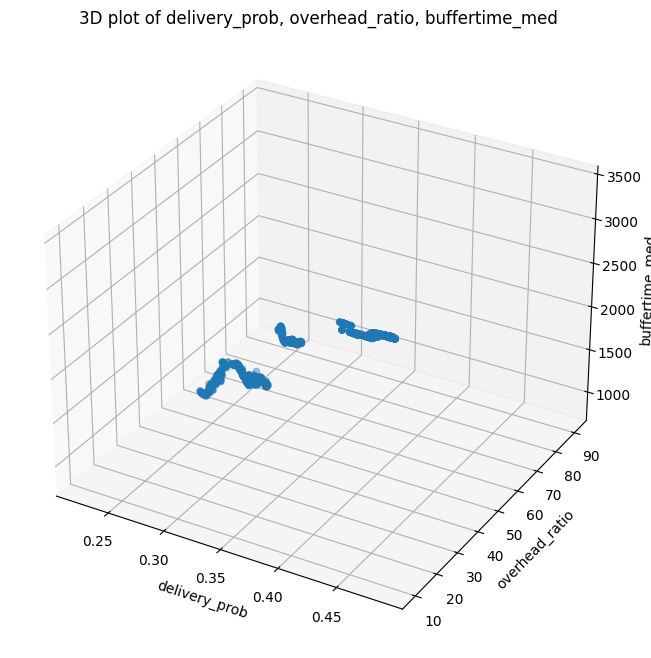

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['delivery_prob'], df['overhead_ratio'], df['buffertime_med'])
ax.set_title("3D plot of delivery_prob, overhead_ratio, buffertime_med")

ax.set_xlabel('delivery_prob')
ax.set_ylabel('overhead_ratio')
ax.set_zlabel('buffertime_med')

plt.show()


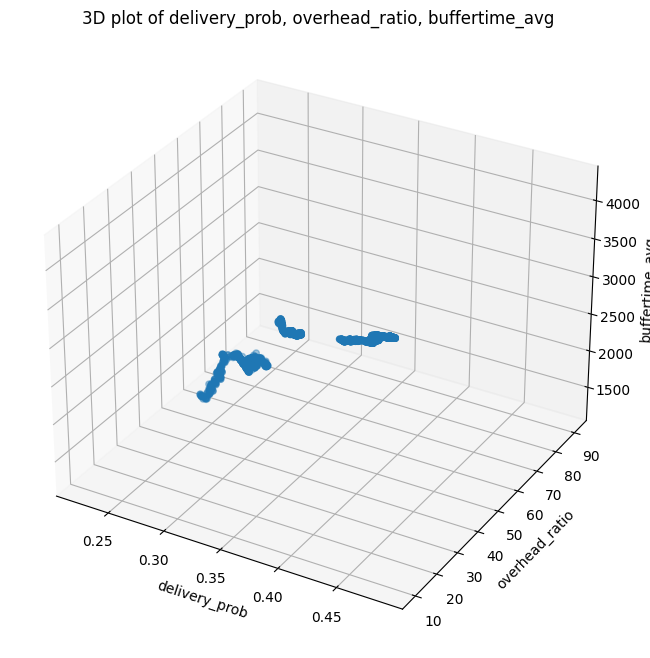

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['delivery_prob'], df['overhead_ratio'], df['buffertime_avg'])
ax.set_title("3D plot of delivery_prob, overhead_ratio, buffertime_avg")

ax.set_xlabel('delivery_prob')
ax.set_ylabel('overhead_ratio')
ax.set_zlabel('buffertime_avg')

plt.show()


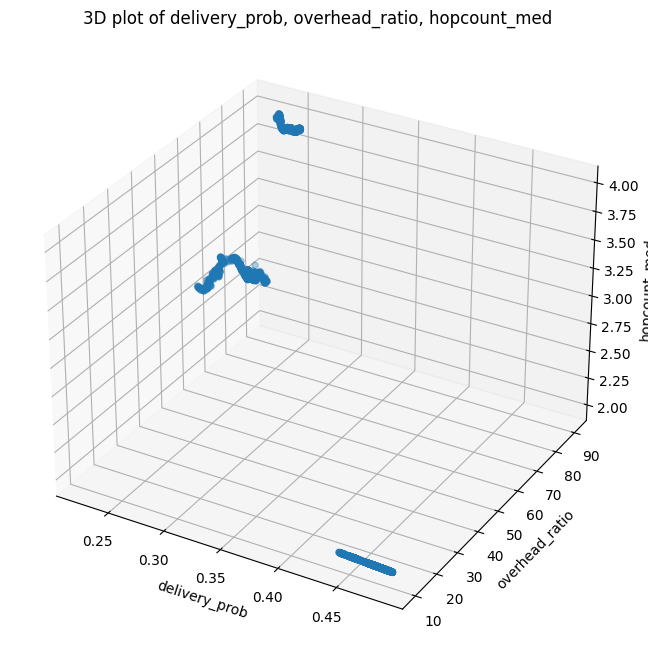

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['delivery_prob'], df['overhead_ratio'], df['hopcount_med'])
ax.set_title("3D plot of delivery_prob, overhead_ratio, hopcount_med")

ax.set_xlabel('delivery_prob')
ax.set_ylabel('overhead_ratio')
ax.set_zlabel('hopcount_med')

plt.show()


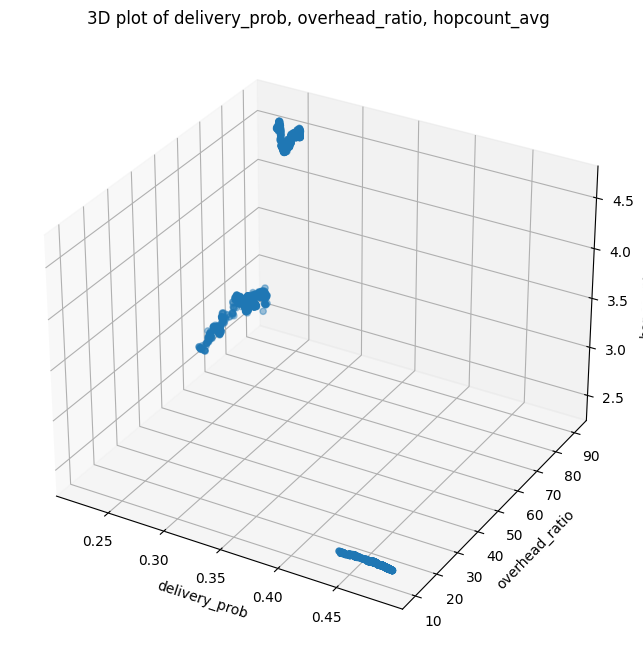

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['delivery_prob'], df['overhead_ratio'], df['hopcount_avg'])
ax.set_title("3D plot of delivery_prob, overhead_ratio, hopcount_avg")

ax.set_xlabel('delivery_prob')
ax.set_ylabel('overhead_ratio')
ax.set_zlabel('hopcount_avg')

plt.show()


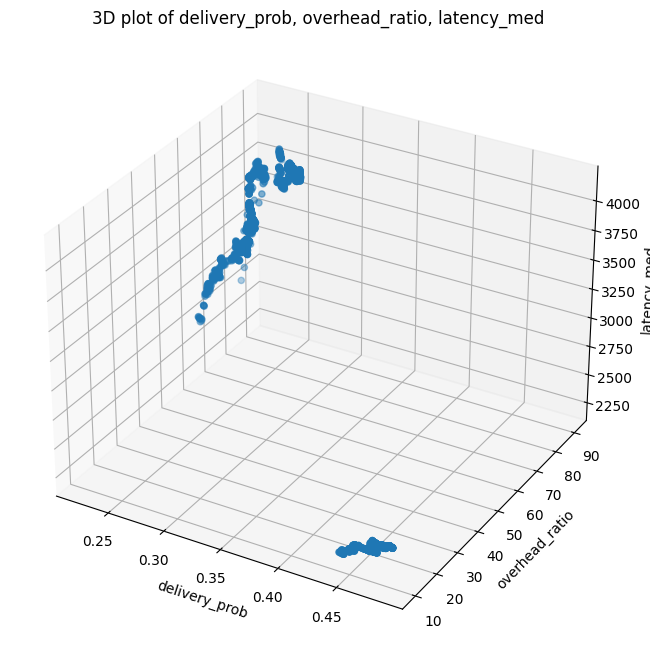

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['delivery_prob'], df['overhead_ratio'], df['latency_med'])
ax.set_title("3D plot of delivery_prob, overhead_ratio, latency_med")

ax.set_xlabel('delivery_prob')
ax.set_ylabel('overhead_ratio')
ax.set_zlabel('latency_med')

plt.show()


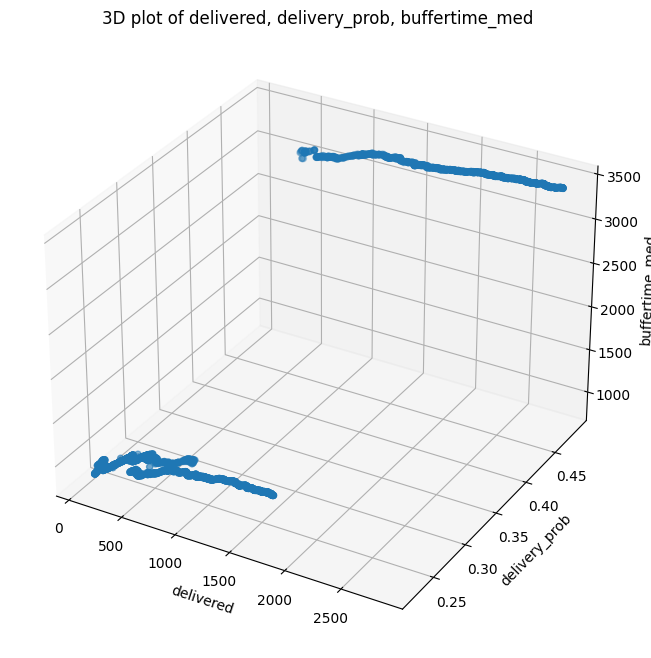

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['delivered'], df['delivery_prob'], df['buffertime_med'])
ax.set_title("3D plot of delivered, delivery_prob, buffertime_med")

ax.set_xlabel('delivered')
ax.set_ylabel('delivery_prob')
ax.set_zlabel('buffertime_med')

plt.show()


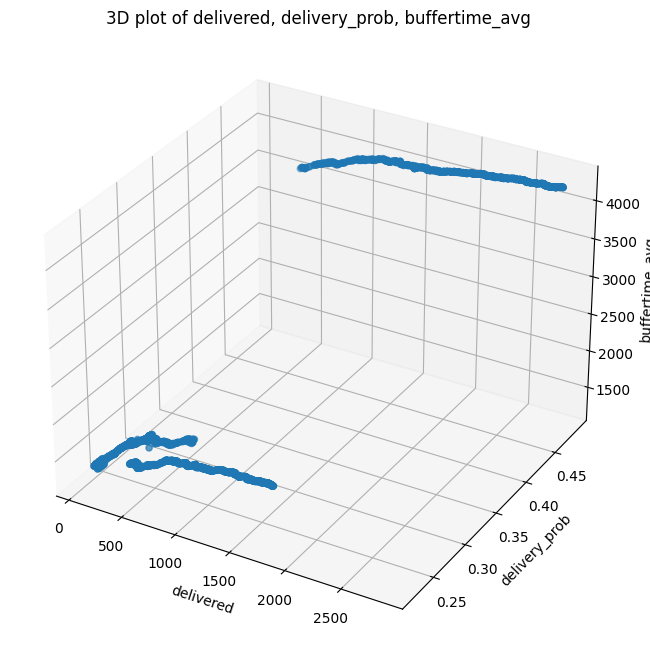

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['delivered'], df['delivery_prob'], df['buffertime_avg'])
ax.set_title("3D plot of delivered, delivery_prob, buffertime_avg")

ax.set_xlabel('delivered')
ax.set_ylabel('delivery_prob')
ax.set_zlabel('buffertime_avg')

plt.show()


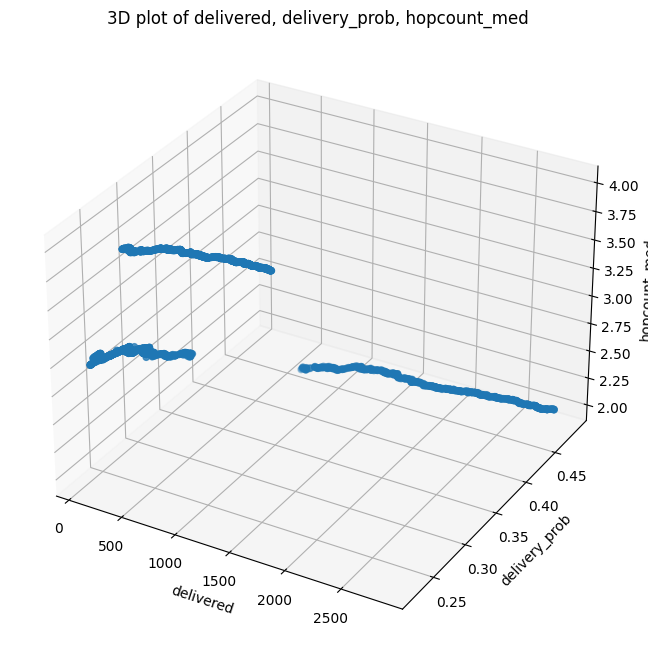

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['delivered'], df['delivery_prob'], df['hopcount_med'])
ax.set_title("3D plot of delivered, delivery_prob, hopcount_med")

ax.set_xlabel('delivered')
ax.set_ylabel('delivery_prob')
ax.set_zlabel('hopcount_med')

plt.show()


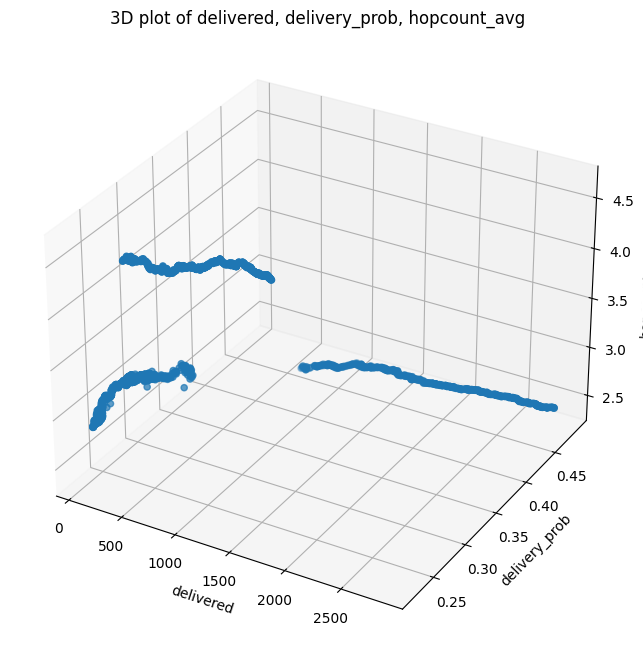

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['delivered'], df['delivery_prob'], df['hopcount_avg'])
ax.set_title("3D plot of delivered, delivery_prob, hopcount_avg")

ax.set_xlabel('delivered')
ax.set_ylabel('delivery_prob')
ax.set_zlabel('hopcount_avg')

plt.show()


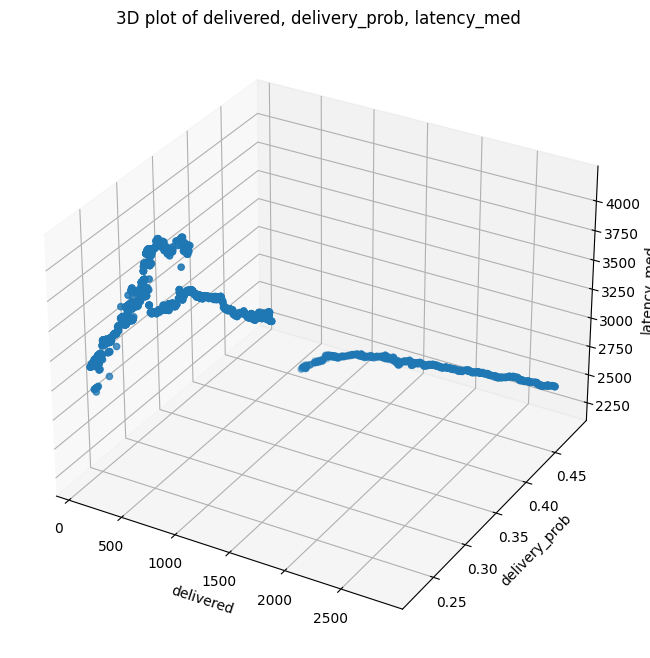

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['delivered'], df['delivery_prob'], df['latency_med'])
ax.set_title("3D plot of delivered, delivery_prob, latency_med")

ax.set_xlabel('delivered')
ax.set_ylabel('delivery_prob')
ax.set_zlabel('latency_med')

plt.show()


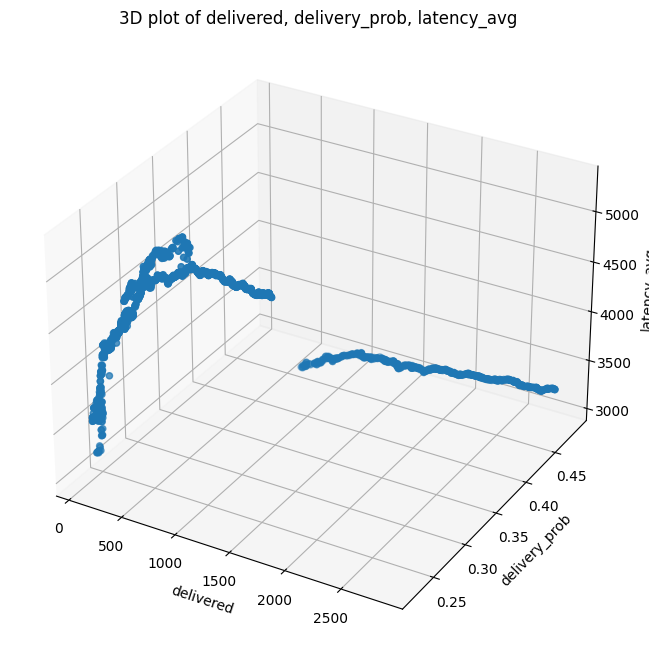

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['delivered'], df['delivery_prob'], df['latency_avg'])
ax.set_title("3D plot of delivered, delivery_prob, latency_avg")

ax.set_xlabel('delivered')
ax.set_ylabel('delivery_prob')
ax.set_zlabel('latency_avg')

plt.show()


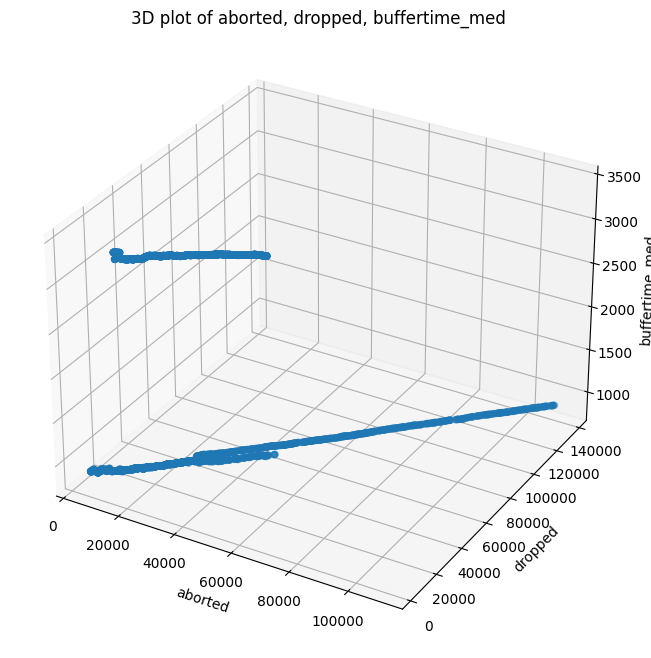

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['aborted'], df['dropped'], df['buffertime_med'])
ax.set_title("3D plot of aborted, dropped, buffertime_med")

ax.set_xlabel('aborted')
ax.set_ylabel('dropped')
ax.set_zlabel('buffertime_med')

plt.show()


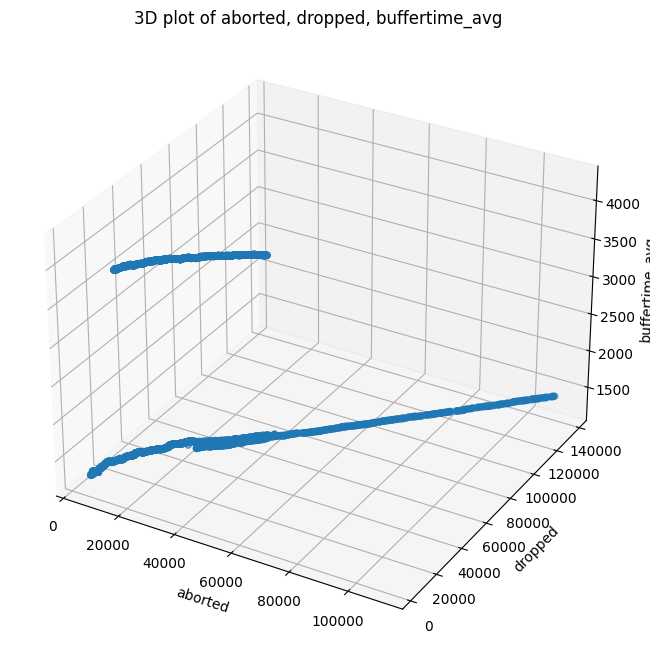

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['aborted'], df['dropped'], df['buffertime_avg'])
ax.set_title("3D plot of aborted, dropped, buffertime_avg")

ax.set_xlabel('aborted')
ax.set_ylabel('dropped')
ax.set_zlabel('buffertime_avg')

plt.show()


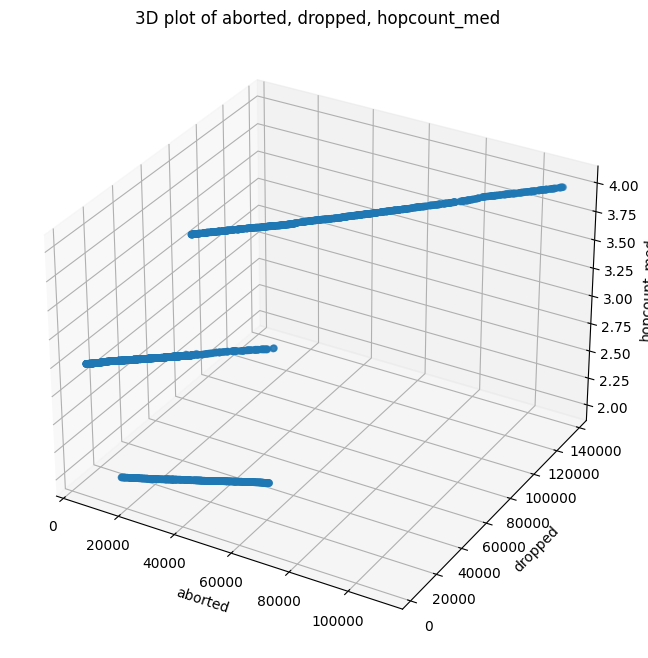

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['aborted'], df['dropped'], df['hopcount_med'])
ax.set_title("3D plot of aborted, dropped, hopcount_med")

ax.set_xlabel('aborted')
ax.set_ylabel('dropped')
ax.set_zlabel('hopcount_med')

plt.show()


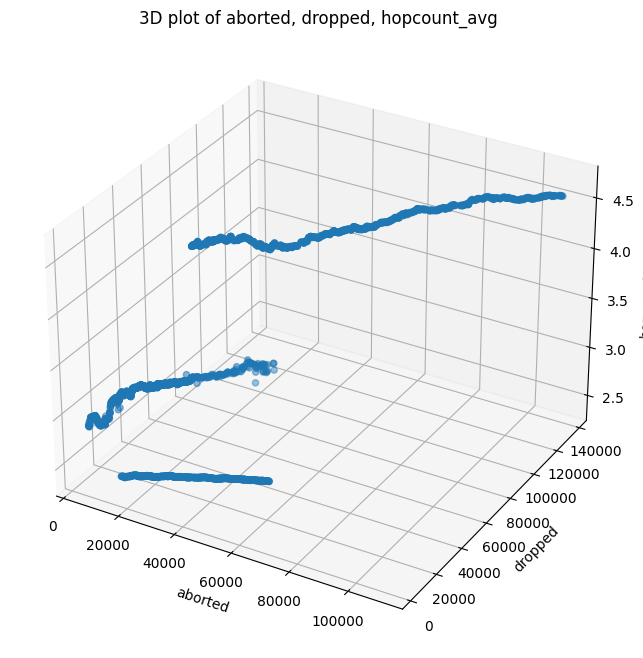

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['aborted'], df['dropped'], df['hopcount_avg'])
ax.set_title("3D plot of aborted, dropped, hopcount_avg")

ax.set_xlabel('aborted')
ax.set_ylabel('dropped')
ax.set_zlabel('hopcount_avg')

plt.show()


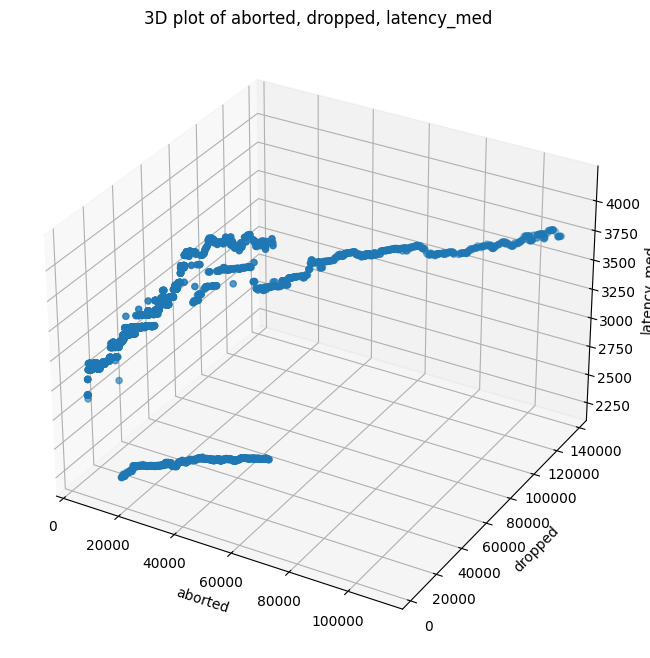

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
('aborted','dropped','latency_med')
ax.scatter(df['aborted'], df['dropped'], df['latency_med'])
ax.set_title("3D plot of aborted, dropped, latency_med")

ax.set_xlabel('aborted')
ax.set_ylabel('dropped')
ax.set_zlabel('latency_med')

plt.show()


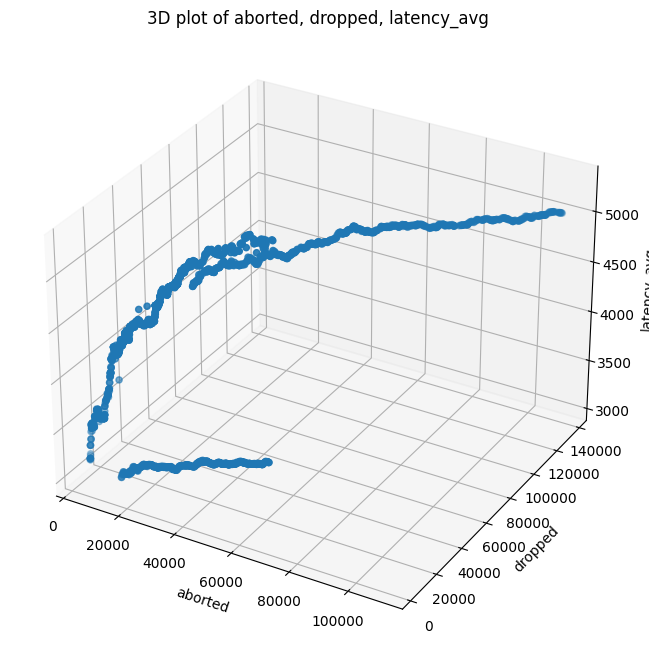

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['aborted'], df['dropped'], df['latency_avg'])
ax.set_title("3D plot of aborted, dropped, latency_avg")

ax.set_xlabel('aborted')
ax.set_ylabel('dropped')
ax.set_zlabel('latency_avg')

plt.show()


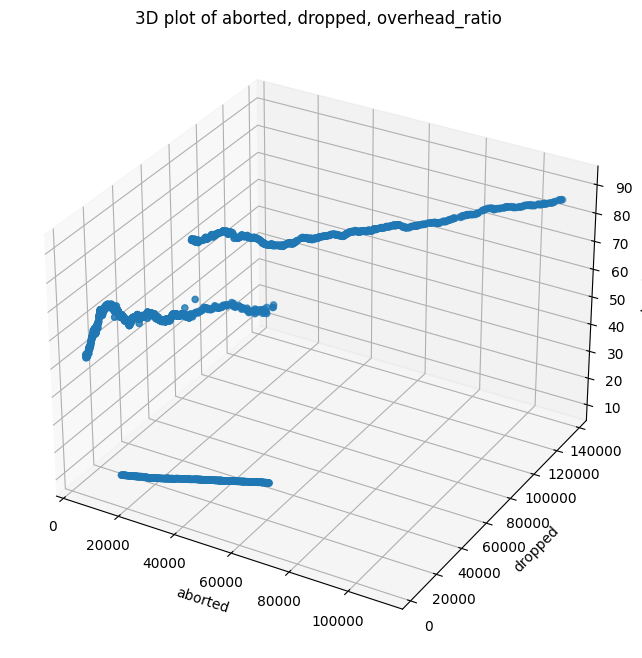

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['aborted'], df['dropped'], df['overhead_ratio'])
ax.set_title("3D plot of aborted, dropped, overhead_ratio")

ax.set_xlabel('aborted')
ax.set_ylabel('dropped')
ax.set_zlabel('overhead_ratio')

plt.show()


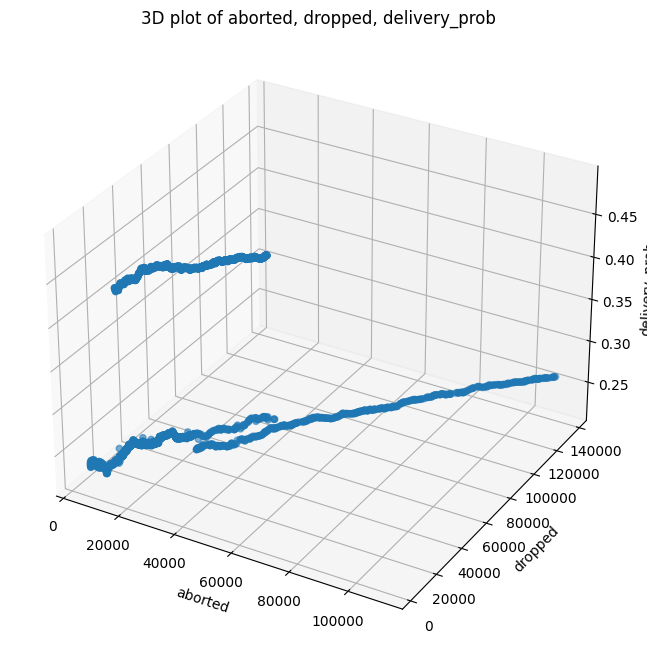

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['aborted'], df['dropped'], df['delivery_prob'])
ax.set_title("3D plot of aborted, dropped, delivery_prob")

ax.set_xlabel('aborted')
ax.set_ylabel('dropped')
ax.set_zlabel('delivery_prob')

plt.show()


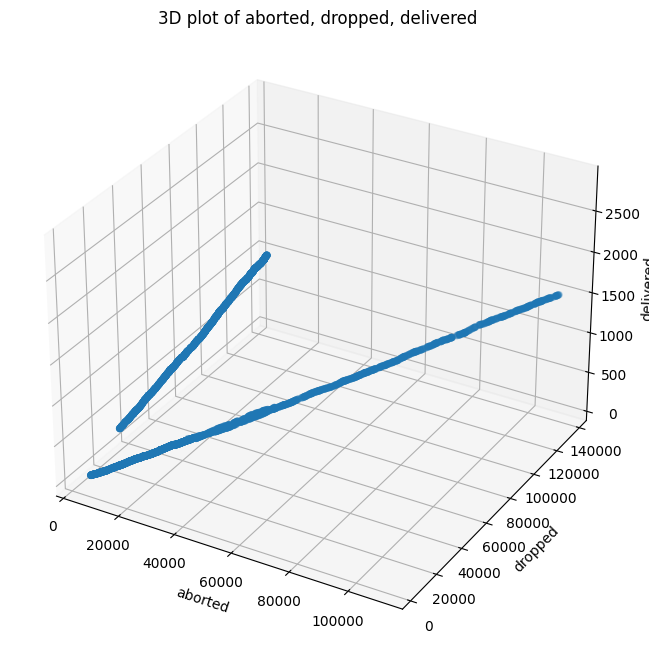

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['aborted'], df['dropped'], df['delivered'])
ax.set_title("3D plot of aborted, dropped, delivered")

ax.set_xlabel('aborted')
ax.set_ylabel('dropped')
ax.set_zlabel('delivered')

plt.show()


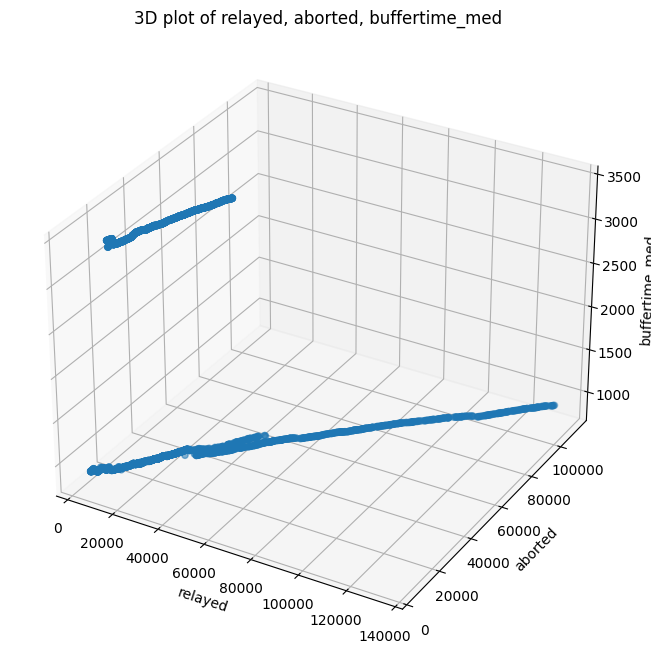

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['relayed'], df['aborted'], df['buffertime_med'])
ax.set_title("3D plot of relayed, aborted, buffertime_med")

ax.set_xlabel('relayed')
ax.set_ylabel('aborted')
ax.set_zlabel('buffertime_med')

plt.show()


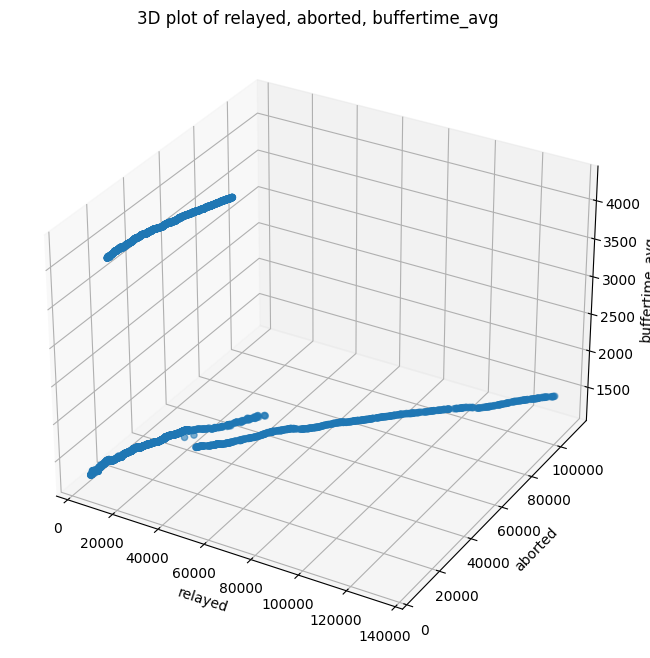

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['relayed'], df['aborted'], df['buffertime_avg'])
ax.set_title("3D plot of relayed, aborted, buffertime_avg")

ax.set_xlabel('relayed')
ax.set_ylabel('aborted')
ax.set_zlabel('buffertime_avg')

plt.show()


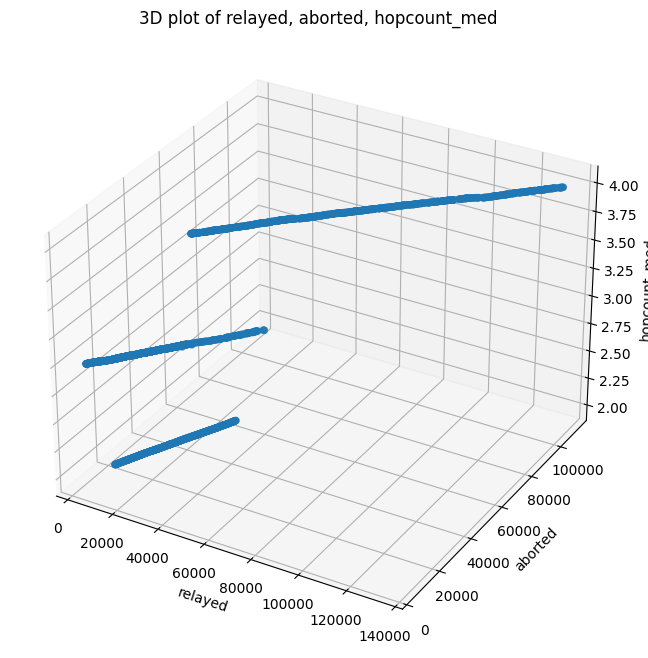

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['relayed'], df['aborted'], df['hopcount_med'])
ax.set_title("3D plot of relayed, aborted, hopcount_med")

ax.set_xlabel('relayed')
ax.set_ylabel('aborted')
ax.set_zlabel('hopcount_med')

plt.show()


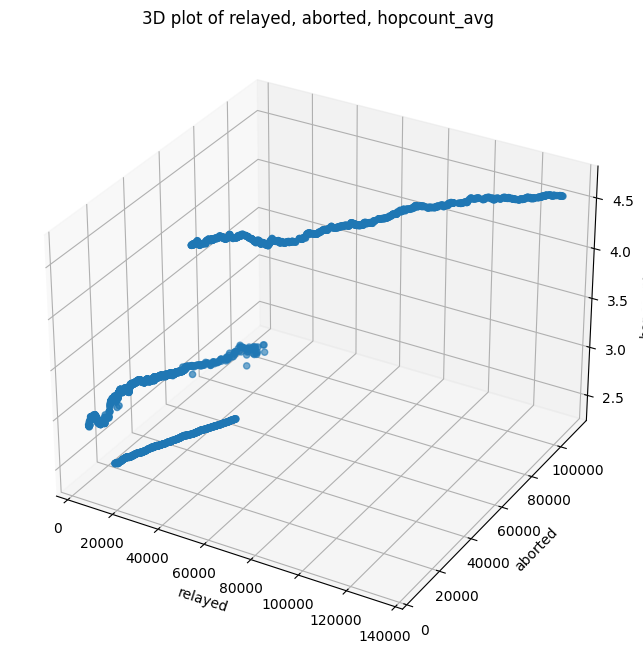

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['relayed'], df['aborted'], df['hopcount_avg'])
ax.set_title("3D plot of relayed, aborted, hopcount_avg")

ax.set_xlabel('relayed')
ax.set_ylabel('aborted')
ax.set_zlabel('hopcount_avg')

plt.show()


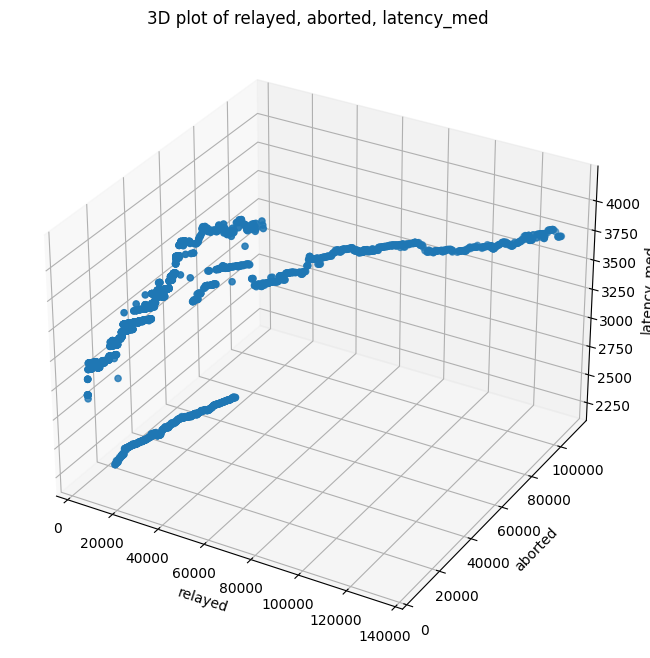

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['relayed'], df['aborted'], df['latency_med'])
ax.set_title("3D plot of relayed, aborted, latency_med")

ax.set_xlabel('relayed')
ax.set_ylabel('aborted')
ax.set_zlabel('latency_med')

plt.show()


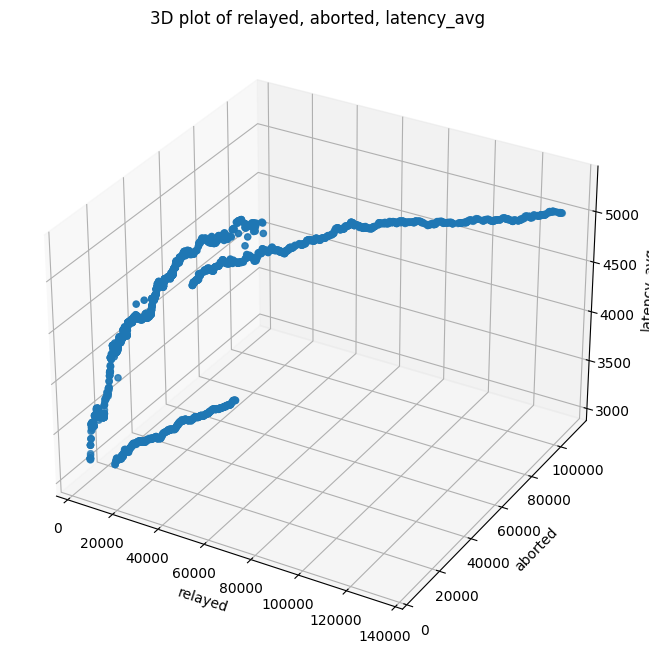

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['relayed'], df['aborted'], df['latency_avg'])
ax.set_title("3D plot of relayed, aborted, latency_avg")

ax.set_xlabel('relayed')
ax.set_ylabel('aborted')
ax.set_zlabel('latency_avg')

plt.show()


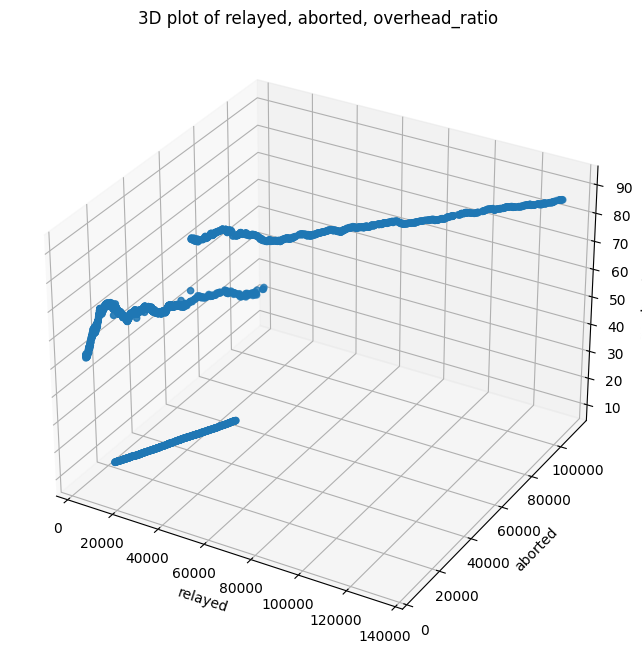

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['relayed'], df['aborted'], df['overhead_ratio'])
ax.set_title("3D plot of relayed, aborted, overhead_ratio")

ax.set_xlabel('relayed')
ax.set_ylabel('aborted')
ax.set_zlabel('overhead_ratio')

plt.show()


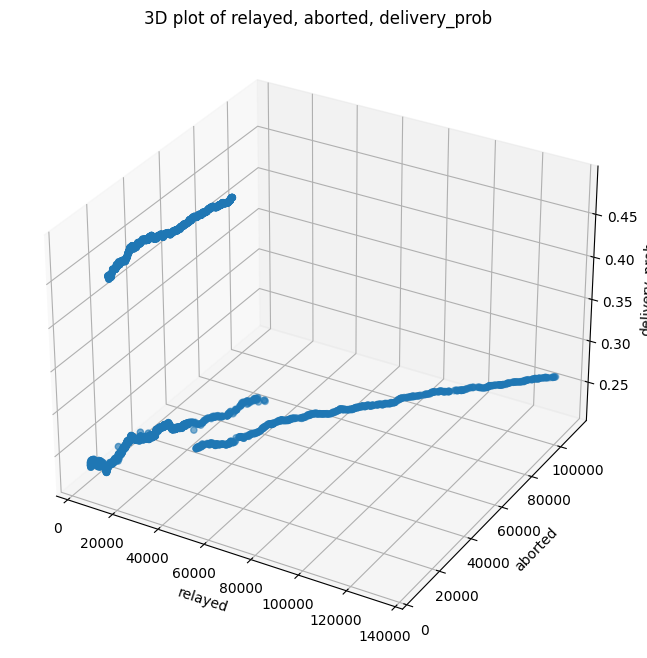

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['relayed'], df['aborted'], df['delivery_prob'])
ax.set_title("3D plot of relayed, aborted, delivery_prob")

ax.set_xlabel('relayed')
ax.set_ylabel('aborted')
ax.set_zlabel('delivery_prob')

plt.show()


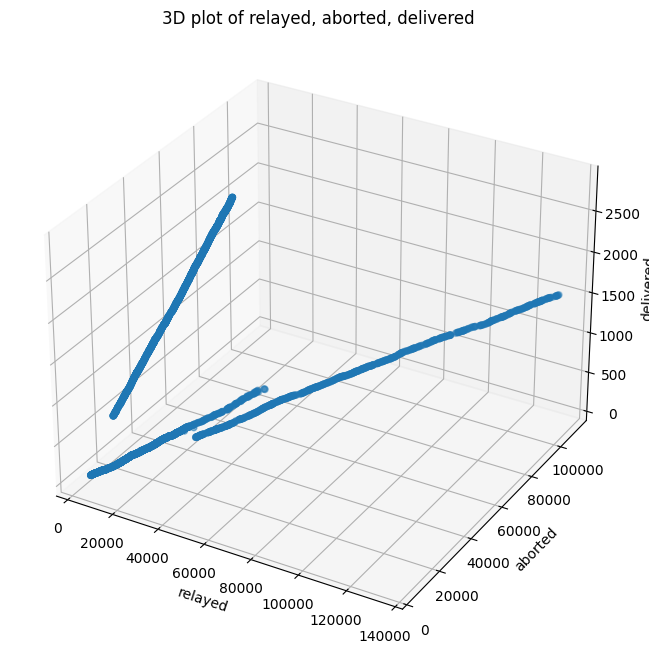

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['relayed'], df['aborted'], df['delivered'])
ax.set_title("3D plot of relayed, aborted, delivered")

ax.set_xlabel('relayed')
ax.set_ylabel('aborted')
ax.set_zlabel('delivered')

plt.show()


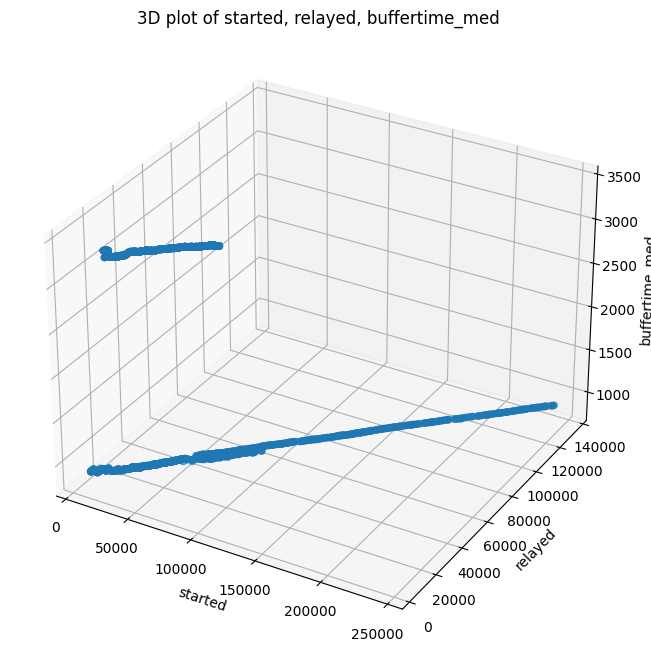

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['started'], df['relayed'], df['buffertime_med'])
ax.set_title("3D plot of started, relayed, buffertime_med")

ax.set_xlabel('started')
ax.set_ylabel('relayed')
ax.set_zlabel('buffertime_med')

plt.show()


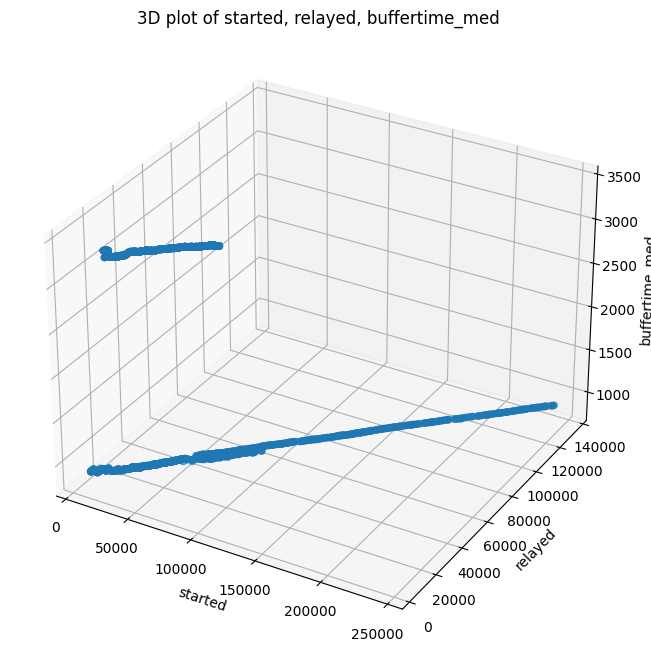

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['started'], df['relayed'], df['buffertime_med'])
ax.set_title("3D plot of started, relayed, buffertime_med")

ax.set_xlabel('started')
ax.set_ylabel('relayed')
ax.set_zlabel('buffertime_med')

plt.show()


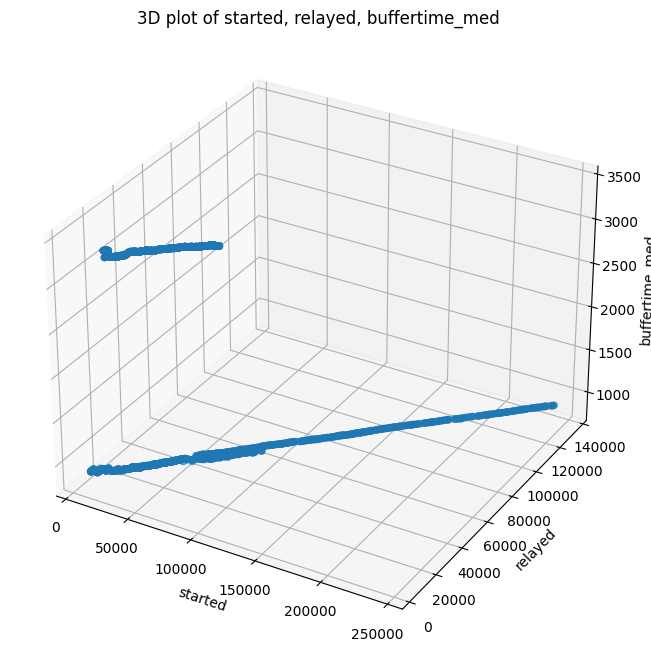

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['started'], df['relayed'], df['buffertime_med'])
ax.set_title("3D plot of started, relayed, buffertime_med")

ax.set_xlabel('started')
ax.set_ylabel('relayed')
ax.set_zlabel('buffertime_med')

plt.show()


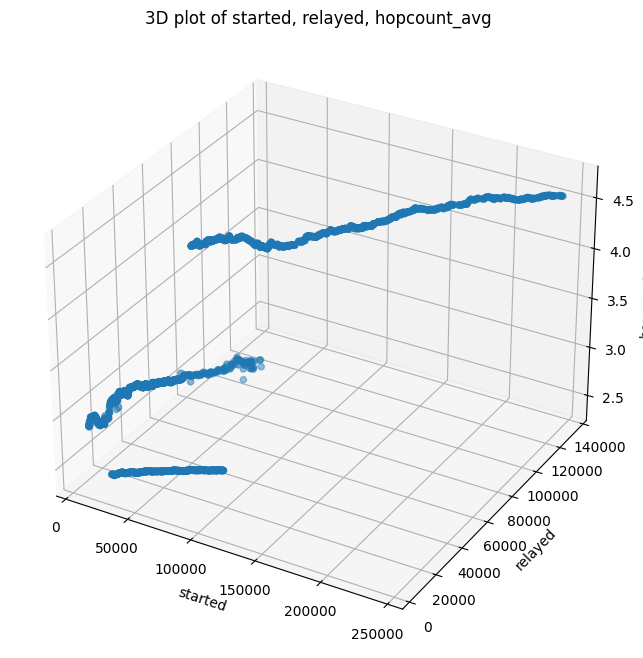

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['started'], df['relayed'], df['hopcount_avg'])
ax.set_title("3D plot of started, relayed, hopcount_avg")

ax.set_xlabel('started')
ax.set_ylabel('relayed')
ax.set_zlabel('hopcount_avg')

plt.show()


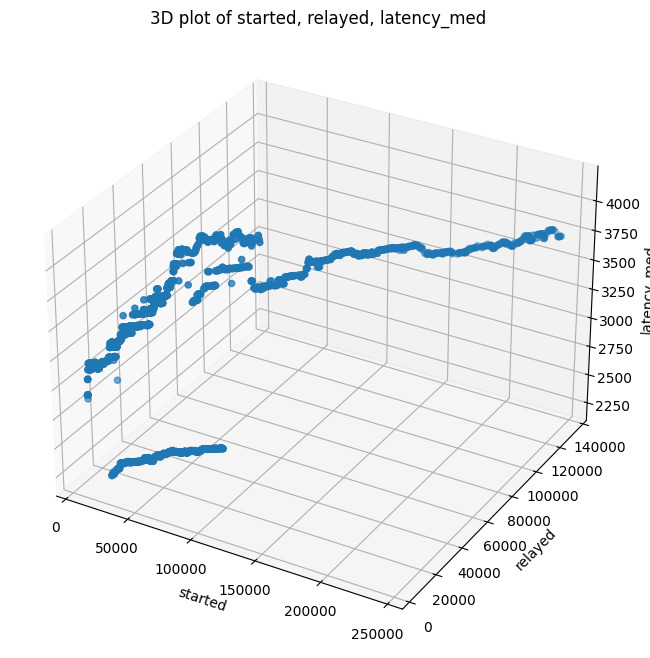

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['started'], df['relayed'], df['latency_med'])
ax.set_title("3D plot of started, relayed, latency_med")

ax.set_xlabel('started')
ax.set_ylabel('relayed')
ax.set_zlabel('latency_med')

plt.show()


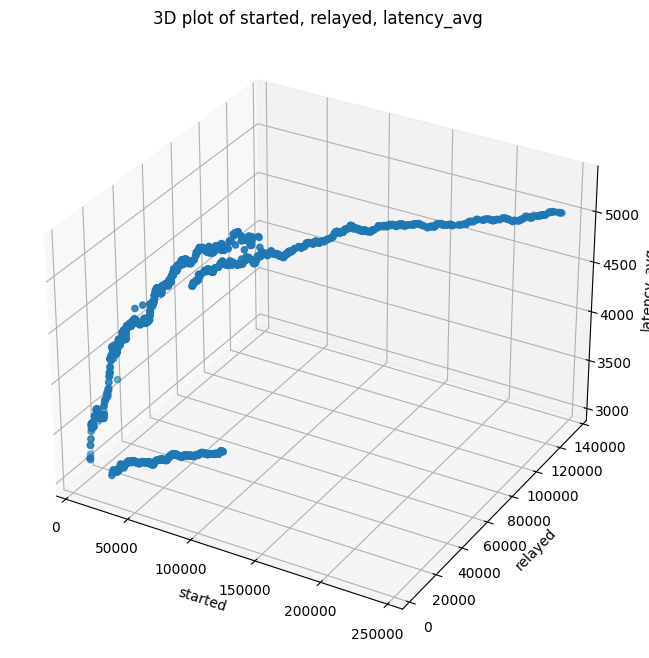

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['started'], df['relayed'], df['latency_avg'])
ax.set_title("3D plot of started, relayed, latency_avg")

ax.set_xlabel('started')
ax.set_ylabel('relayed')
ax.set_zlabel('latency_avg')

plt.show()


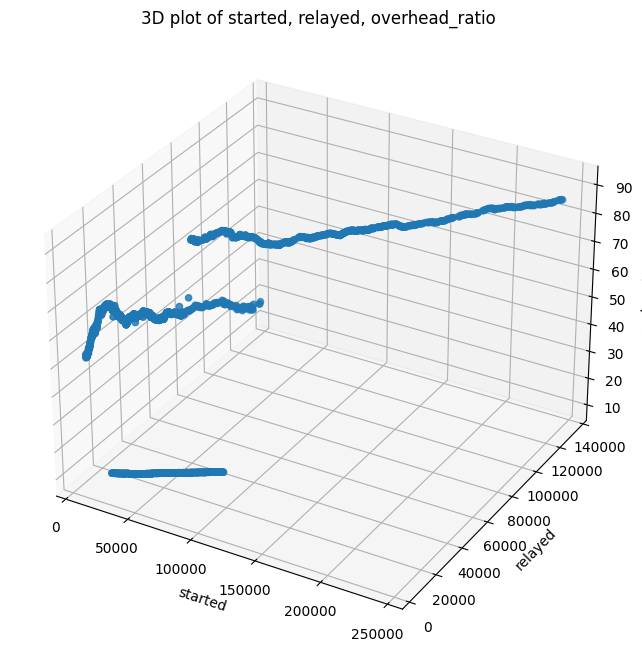

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['started'], df['relayed'], df['overhead_ratio'])
ax.set_title("3D plot of started, relayed, overhead_ratio")

ax.set_xlabel('started')
ax.set_ylabel('relayed')
ax.set_zlabel('overhead_ratio')

plt.show()


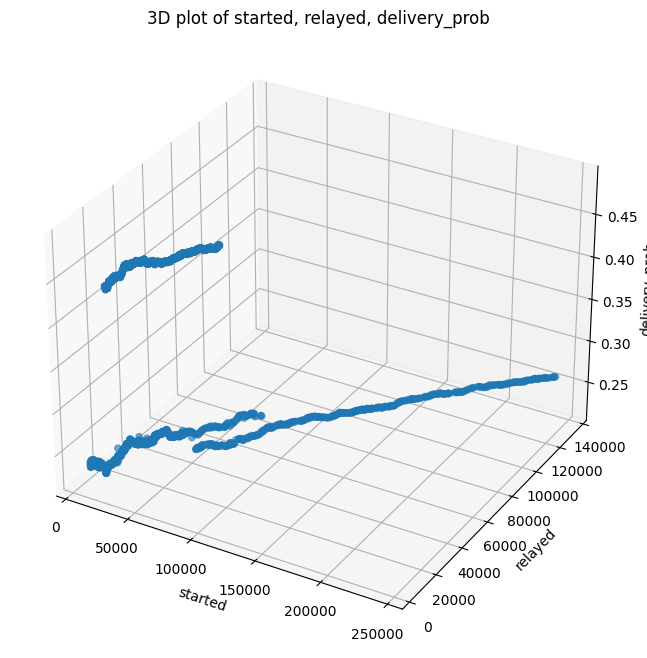

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['started'], df['relayed'], df['delivery_prob'])
ax.set_title("3D plot of started, relayed, delivery_prob")

ax.set_xlabel('started')
ax.set_ylabel('relayed')
ax.set_zlabel('delivery_prob')

plt.show()


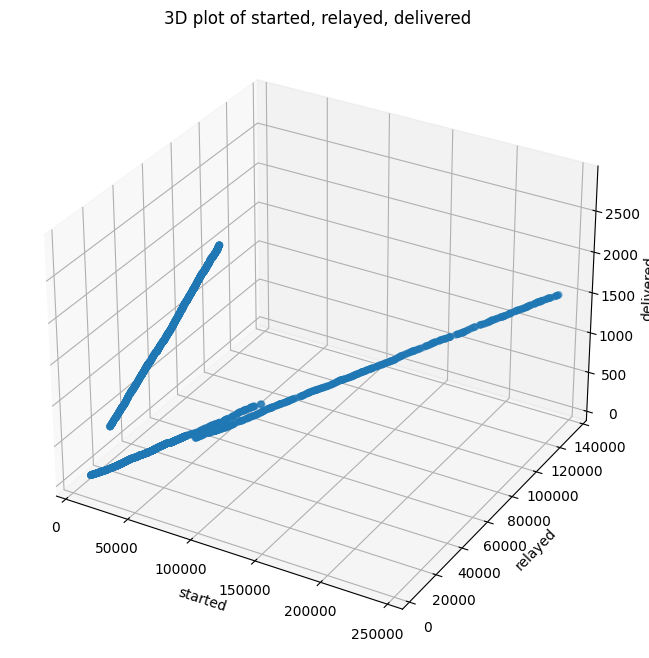

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['started'], df['relayed'], df['delivered'])
ax.set_title("3D plot of started, relayed, delivered")

ax.set_xlabel('started')
ax.set_ylabel('relayed')
ax.set_zlabel('delivered')

plt.show()


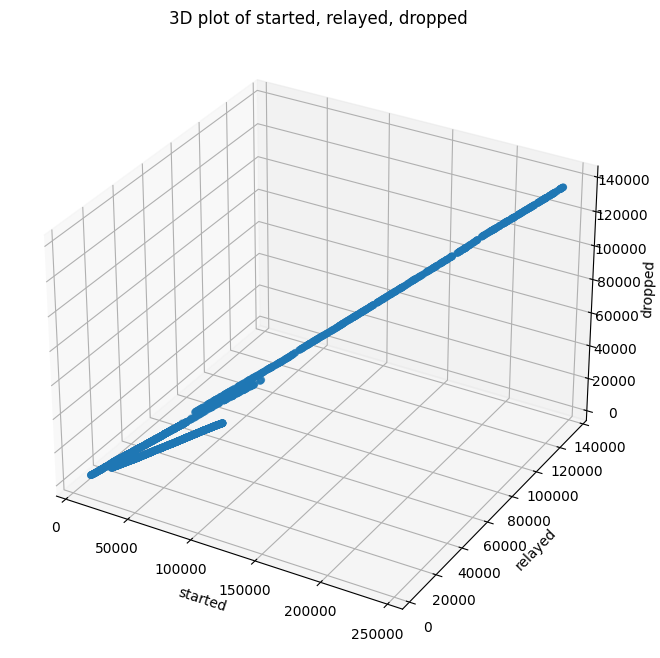

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['started'], df['relayed'], df['dropped'])
ax.set_title("3D plot of started, relayed, dropped")

ax.set_xlabel('started')
ax.set_ylabel('relayed')
ax.set_zlabel('dropped')

plt.show()


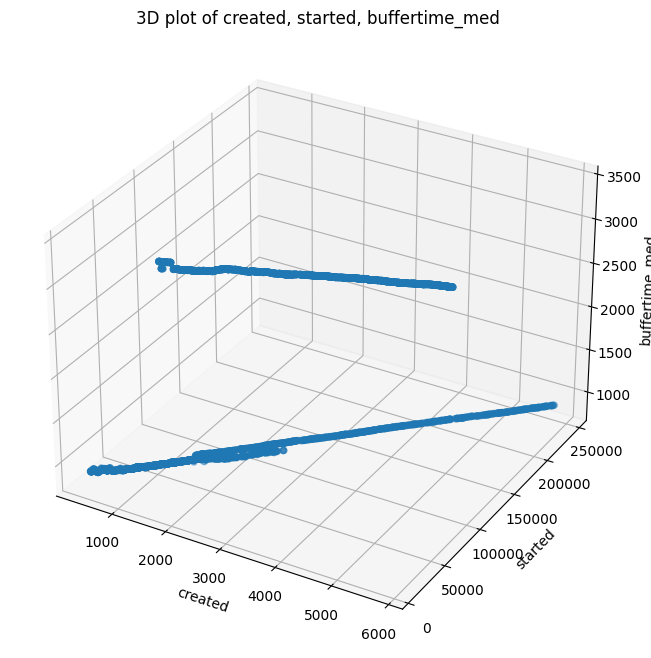

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['created'], df['started'], df['buffertime_med'])
ax.set_title("3D plot of created, started, buffertime_med")

ax.set_xlabel('created')
ax.set_ylabel('started')
ax.set_zlabel('buffertime_med')

plt.show()


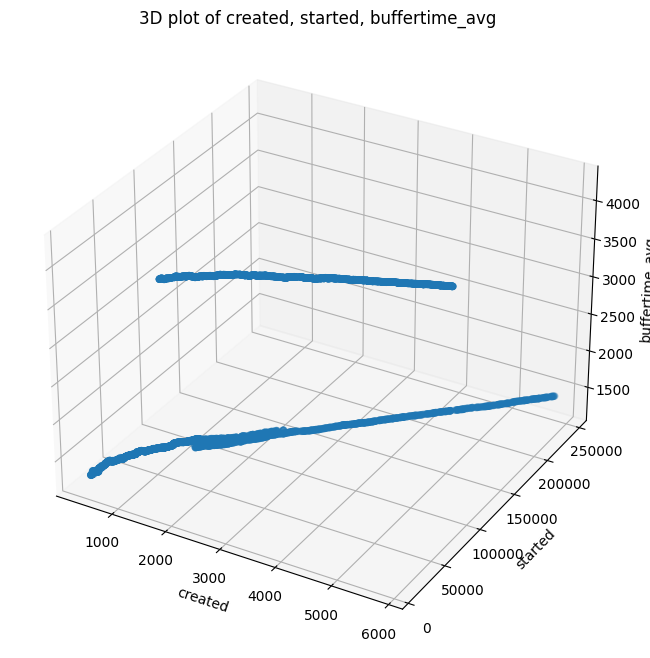

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['created'], df['started'], df['buffertime_avg'])
ax.set_title("3D plot of created, started, buffertime_avg")

ax.set_xlabel('created')
ax.set_ylabel('started')
ax.set_zlabel('buffertime_avg')

plt.show()


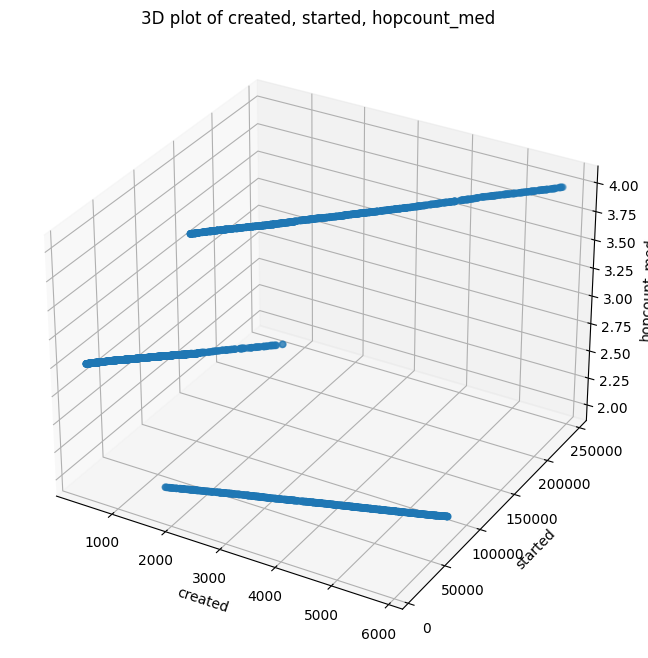

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['created'], df['started'], df['hopcount_med'])
ax.set_title("3D plot of created, started, hopcount_med")

ax.set_xlabel('created')
ax.set_ylabel('started')
ax.set_zlabel('hopcount_med')

plt.show()


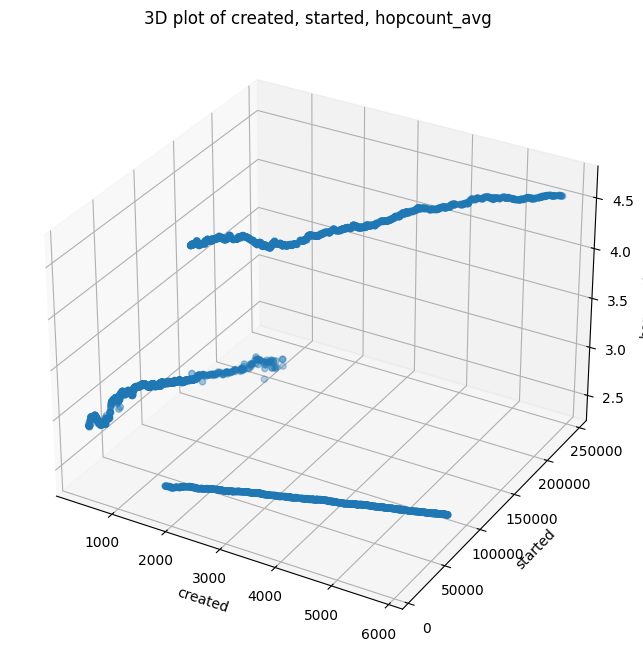

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['created'], df['started'], df['hopcount_avg'])
ax.set_title("3D plot of created, started, hopcount_avg")

ax.set_xlabel('created')
ax.set_ylabel('started')
ax.set_zlabel('hopcount_avg')

plt.show()


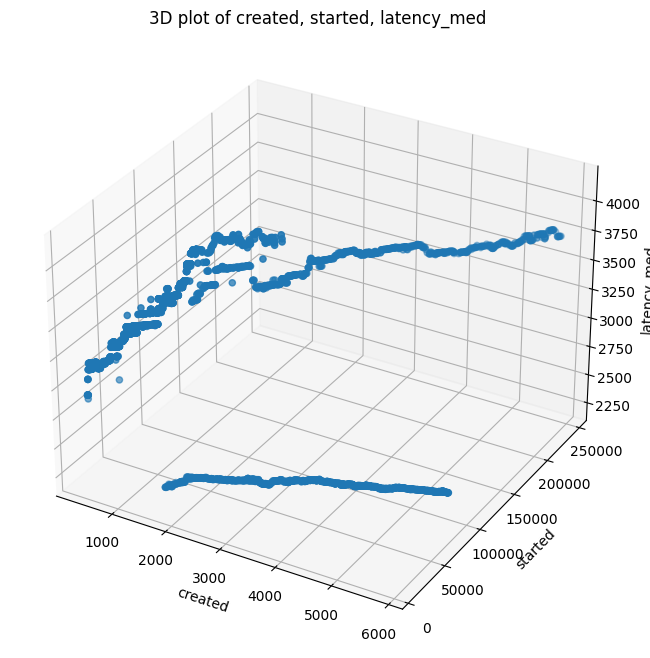

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['created'], df['started'], df['latency_med'])
ax.set_title("3D plot of created, started, latency_med")

ax.set_xlabel('created')
ax.set_ylabel('started')
ax.set_zlabel('latency_med')

plt.show()


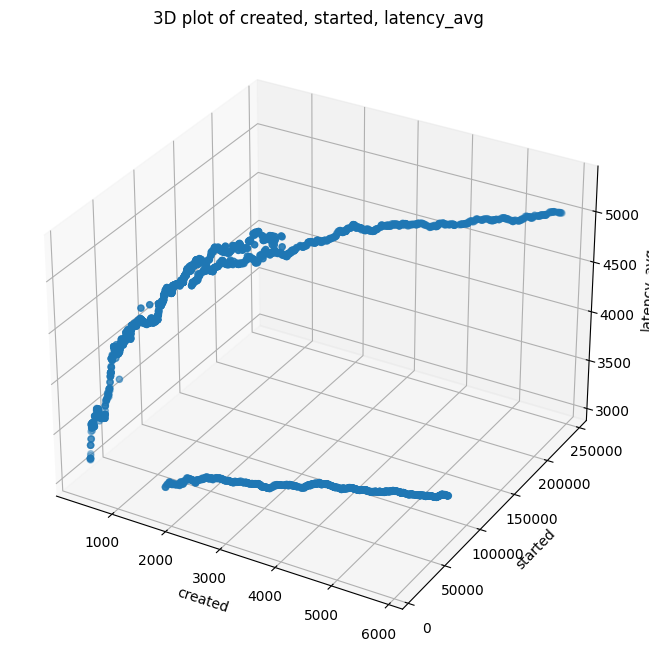

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['created'], df['started'], df['latency_avg'])
ax.set_title("3D plot of created, started, latency_avg")

ax.set_xlabel('created')
ax.set_ylabel('started')
ax.set_zlabel('latency_avg')

plt.show()


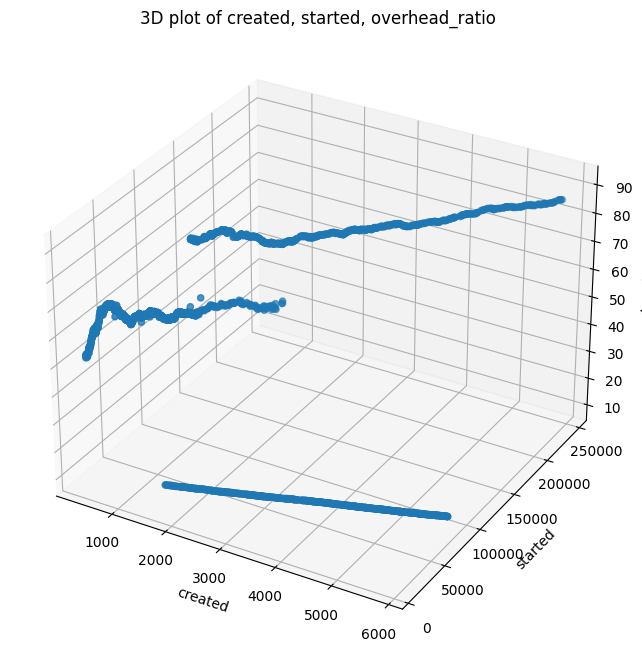

In [ ]:

import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['created'], df['started'], df['overhead_ratio'])
ax.set_title("3D plot of created, started, overhead_ratio")

ax.set_xlabel('created')
ax.set_ylabel('started')
ax.set_zlabel('overhead_ratio')

plt.show()


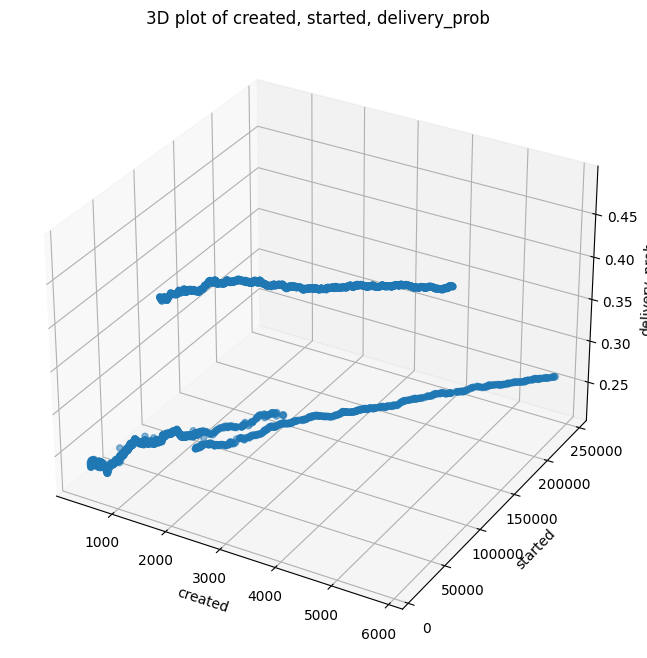

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['created'], df['started'], df['delivery_prob'])
ax.set_title("3D plot of created, started, delivery_prob")

ax.set_xlabel('created')
ax.set_ylabel('started')
ax.set_zlabel('delivery_prob')

plt.show()


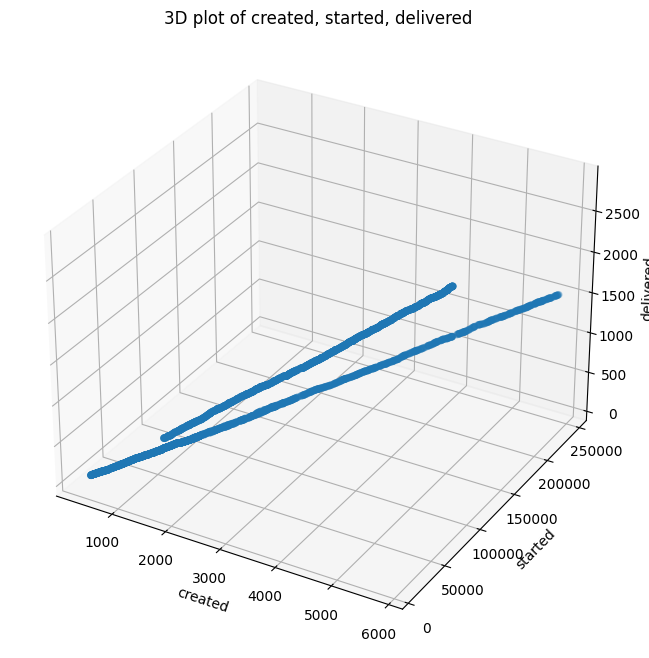

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['created'], df['started'], df['delivered'])
ax.set_title("3D plot of created, started, delivered")

ax.set_xlabel('created')
ax.set_ylabel('started')
ax.set_zlabel('delivered')

plt.show()


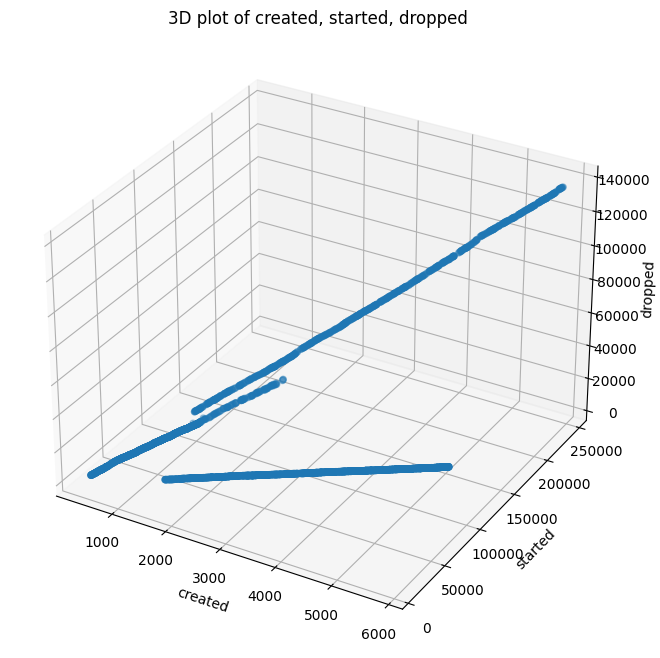

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['created'], df['started'], df['dropped'])
ax.set_title("3D plot of created, started, dropped")

ax.set_xlabel('created')
ax.set_ylabel('started')
ax.set_zlabel('dropped')

plt.show()



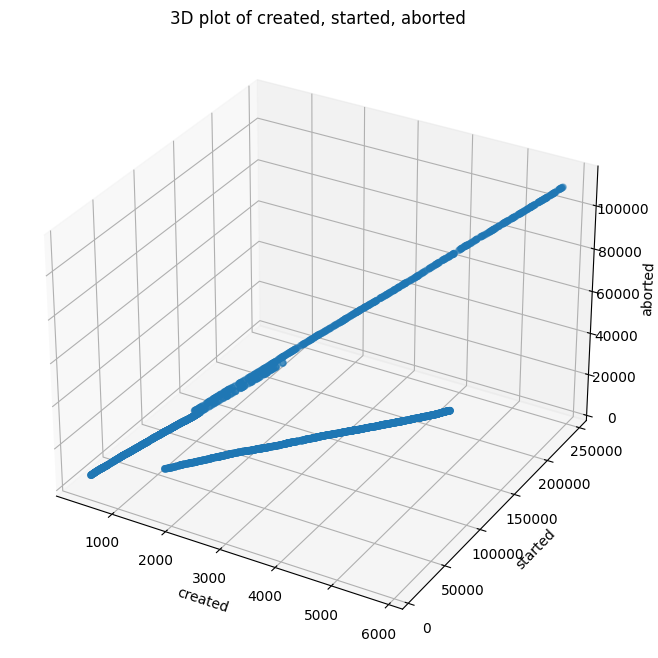

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['created'], df['started'], df['aborted'])
ax.set_title("3D plot of created, started, aborted")

ax.set_xlabel('created')
ax.set_ylabel('started')
ax.set_zlabel('aborted')

plt.show()


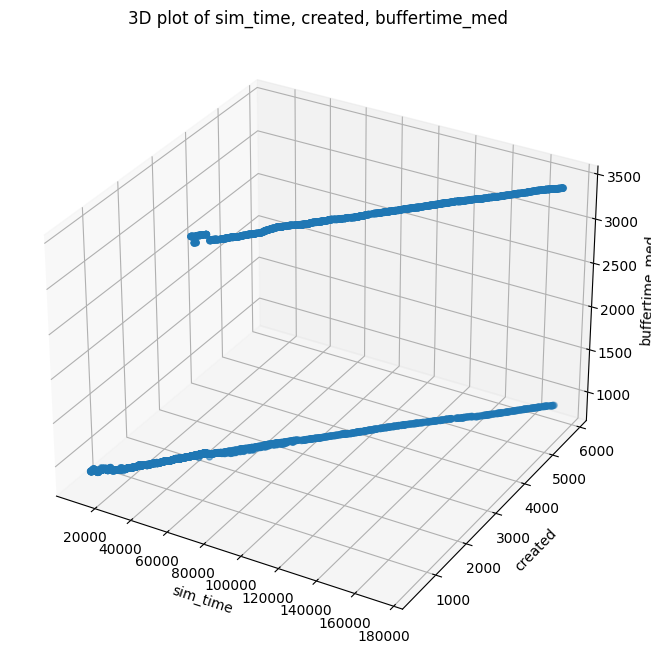

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['sim_time'], df['created'], df['buffertime_med'])
ax.set_title("3D plot of sim_time, created, buffertime_med")

ax.set_xlabel('sim_time')
ax.set_ylabel('created')
ax.set_zlabel('buffertime_med')

plt.show()

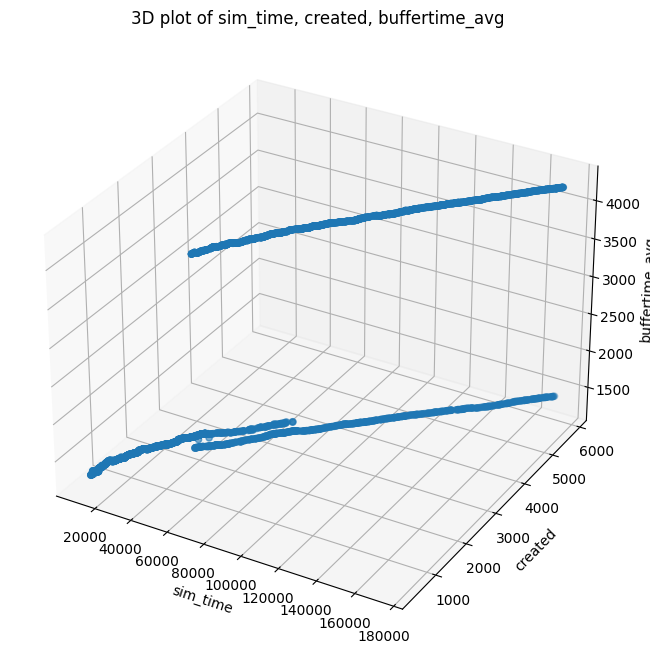

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['sim_time'], df['created'], df['buffertime_avg'])
ax.set_title("3D plot of sim_time, created, buffertime_avg")

ax.set_xlabel('sim_time')
ax.set_ylabel('created')
ax.set_zlabel('buffertime_avg')

plt.show()

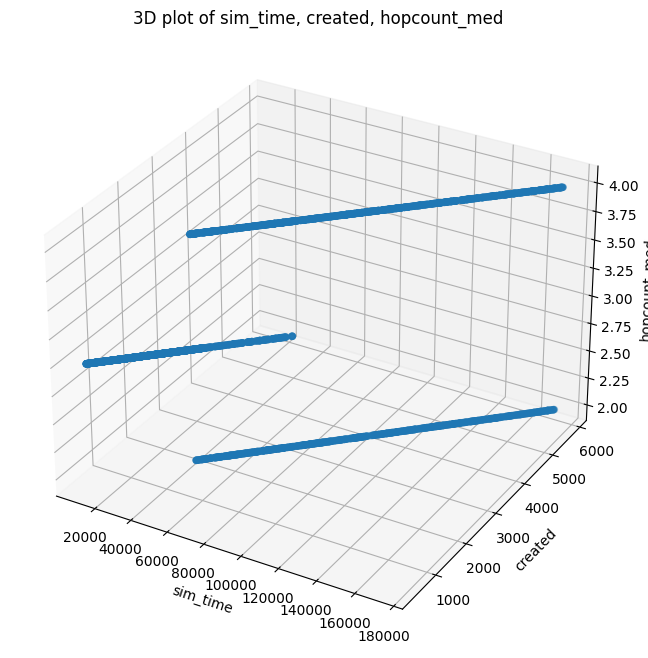

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['sim_time'], df['created'], df['hopcount_med'])
ax.set_title("3D plot of sim_time, created, hopcount_med")

ax.set_xlabel('sim_time')
ax.set_ylabel('created')
ax.set_zlabel('hopcount_med')

plt.show()

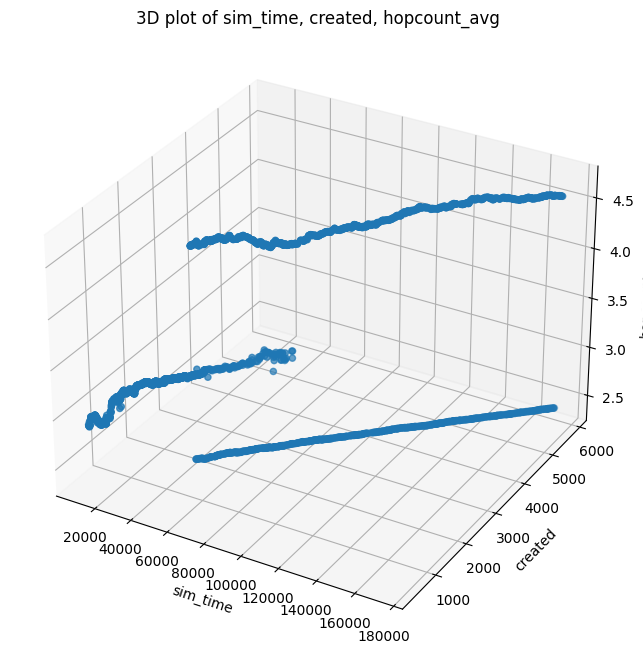

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['sim_time'], df['created'], df['hopcount_avg'])
ax.set_title("3D plot of sim_time, created, hopcount_avg")
ax.set_xlabel('sim_time')
ax.set_ylabel('created')
ax.set_zlabel('hopcount_avg')

plt.show()

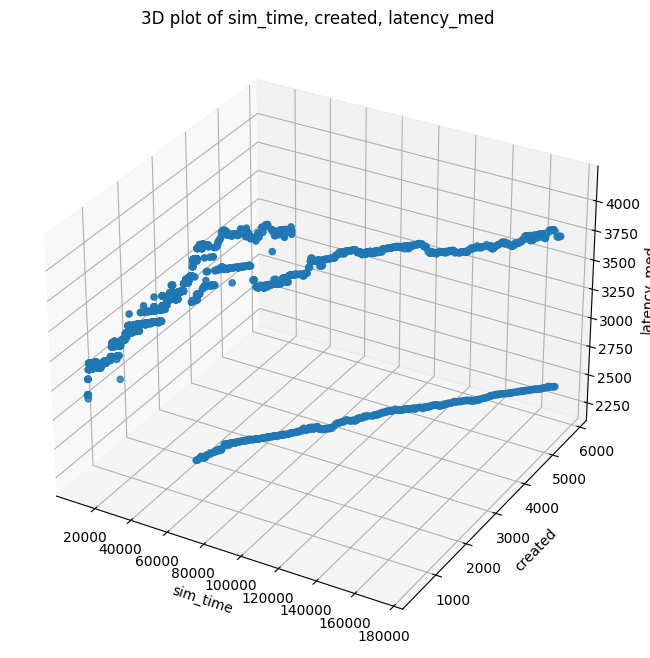

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['sim_time'], df['created'], df['latency_med'])
ax.set_title("3D plot of sim_time, created, latency_med")
ax.set_xlabel('sim_time')
ax.set_ylabel('created')
ax.set_zlabel('latency_med')

plt.show()

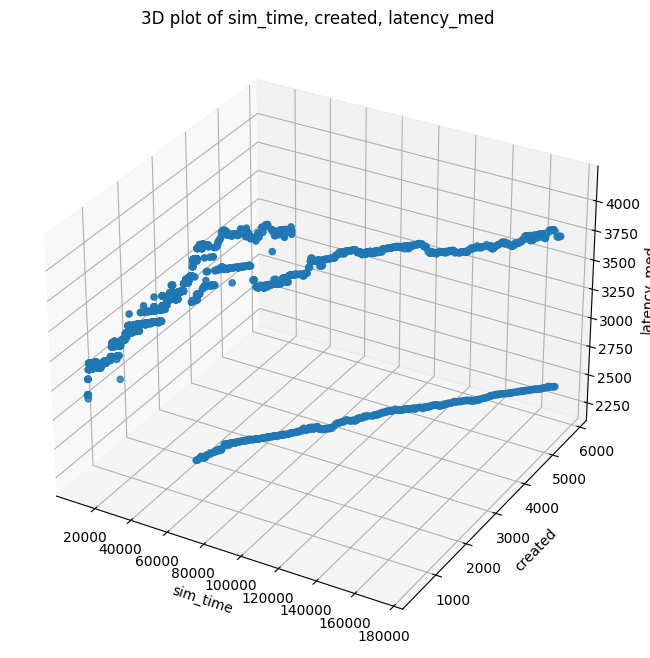

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['sim_time'], df['created'], df['latency_med'])
ax.set_title("3D plot of sim_time, created, latency_med")
ax.set_xlabel('sim_time')
ax.set_ylabel('created')
ax.set_zlabel('latency_med')

plt.show()

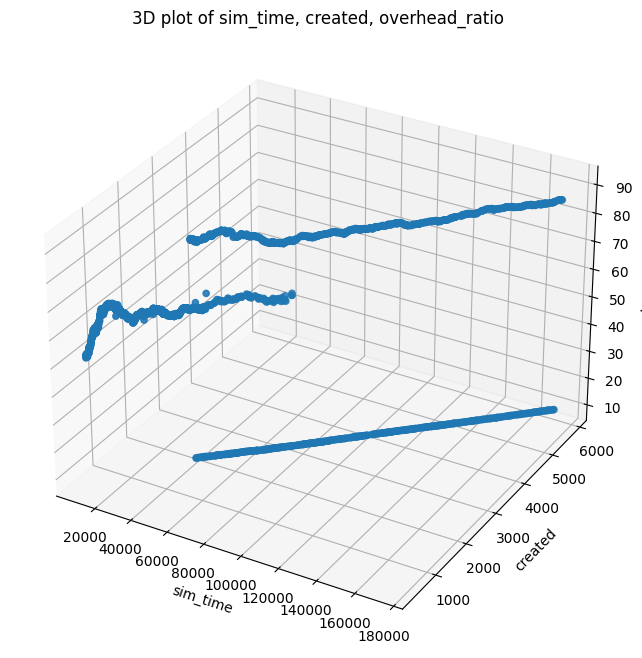

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['sim_time'], df['created'], df['overhead_ratio'])
ax.set_title("3D plot of sim_time, created, overhead_ratio")
ax.set_xlabel('sim_time')
ax.set_ylabel('created')
ax.set_zlabel('overhead_ratio')

plt.show()

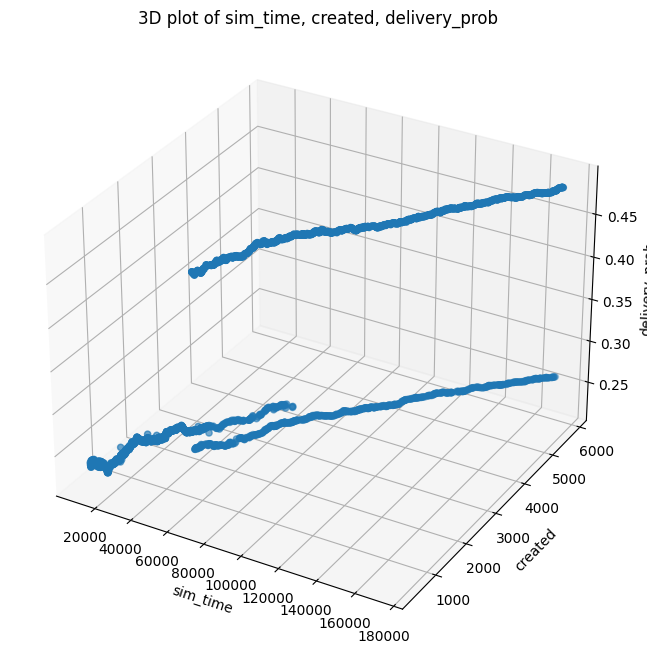

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['sim_time'], df['created'], df['delivery_prob'])
ax.set_title("3D plot of sim_time, created, delivery_prob")
ax.set_xlabel('sim_time')
ax.set_ylabel('created')
ax.set_zlabel('delivery_prob')

plt.show()

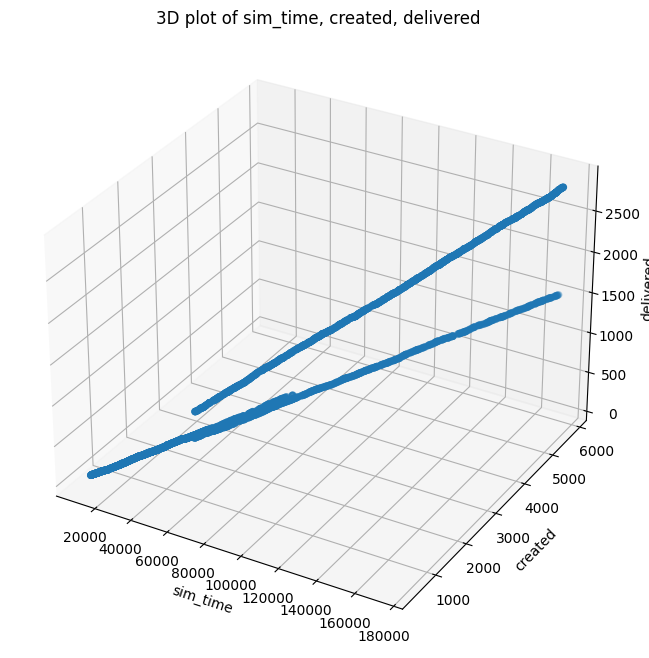

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['sim_time'], df['created'], df['delivered'])
ax.set_title("3D plot of sim_time, created, delivered")
ax.set_xlabel('sim_time')
ax.set_ylabel('created')
ax.set_zlabel('delivered')

plt.show()

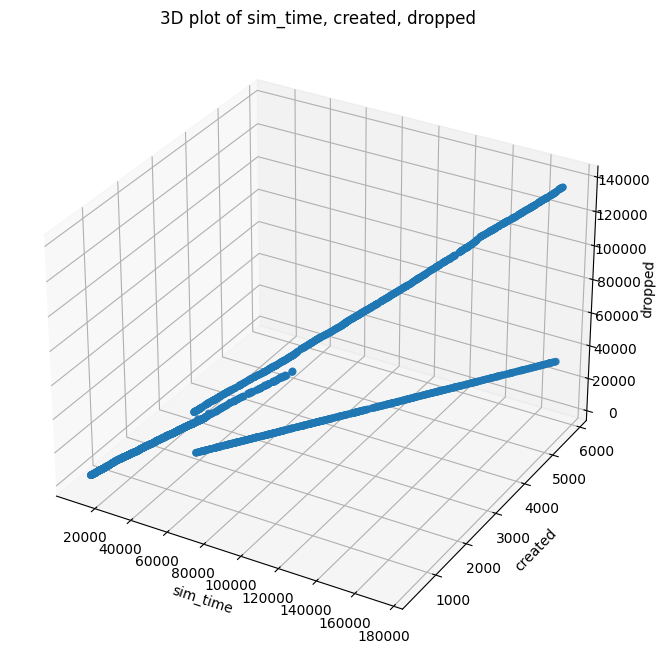

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['sim_time'], df['created'], df['dropped'])
ax.set_title("3D plot of sim_time, created, dropped")
ax.set_xlabel('sim_time')
ax.set_ylabel('created')
ax.set_zlabel('dropped')

plt.show()

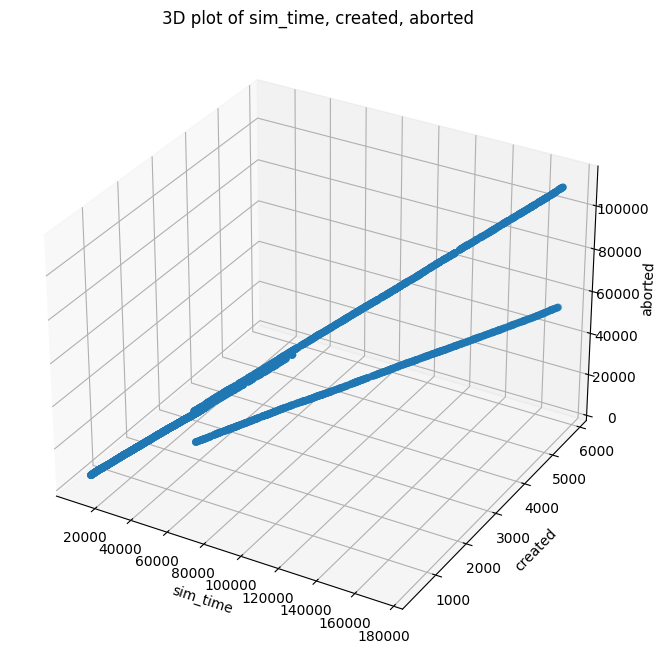

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['sim_time'], df['created'], df['aborted'])
ax.set_title("3D plot of sim_time, created, aborted")
ax.set_xlabel('sim_time')
ax.set_ylabel('created')
ax.set_zlabel('aborted')

plt.show()

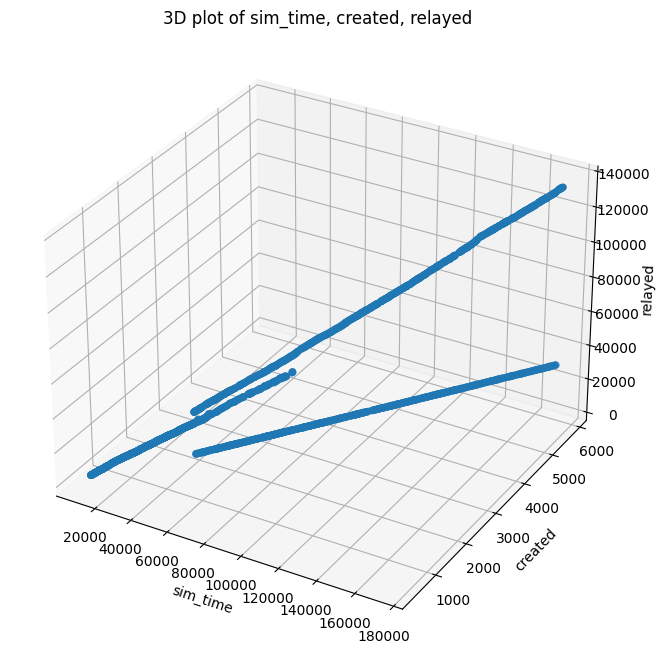

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Creating 3D scatter plot with a larger figure size
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df['sim_time'], df['created'], df['relayed'])
ax.set_title("3D plot of sim_time, created, relayed")
ax.set_xlabel('sim_time')
ax.set_ylabel('created')
ax.set_zlabel('relayed')

plt.show()

#2D

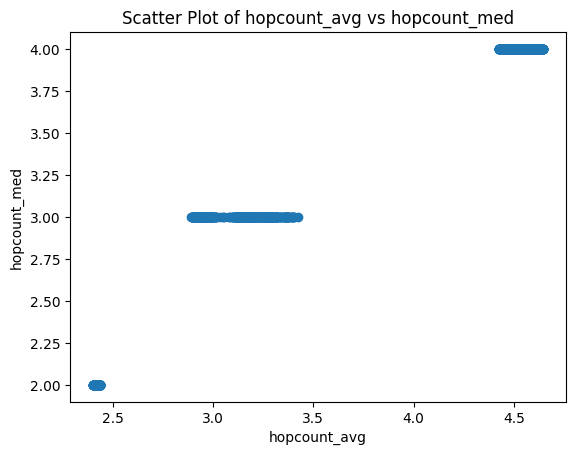

In [ ]:
# prompt: scatterplot hopcount_avg vs hopcount_med

import matplotlib.pyplot as plt

# Create a scatter plot of hopcount_avg vs hopcount_med
plt.scatter(df['hopcount_avg'], df['hopcount_med'])

# Set the title and axis labels
plt.title('Scatter Plot of hopcount_avg vs hopcount_med')
plt.xlabel('hopcount_avg')
plt.ylabel('hopcount_med')

# Show the plot
plt.show()


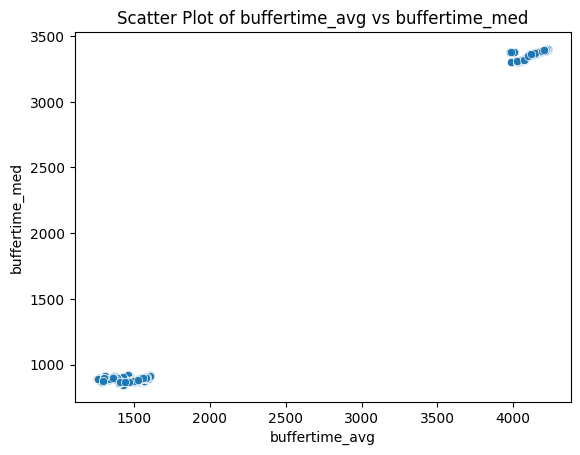

In [ ]:
# prompt: scatter plot buffertime_avg vs buffertime_med

import matplotlib.pyplot as plt
sns.scatterplot(x='buffertime_avg', y='buffertime_med', data=df)
plt.xlabel('buffertime_avg')
plt.ylabel('buffertime_med')
plt.title('Scatter Plot of buffertime_avg vs buffertime_med')
plt.show()


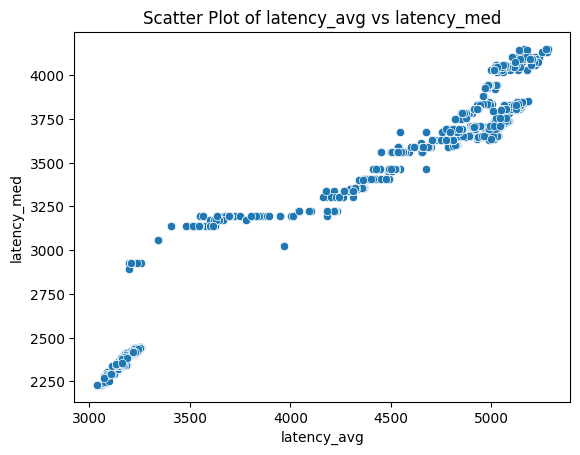

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='latency_avg', y='latency_med', data=df)
plt.xlabel('latency_avg')
plt.ylabel('latency_med')
plt.title('Scatter Plot of latency_avg vs latency_med')
plt.show()

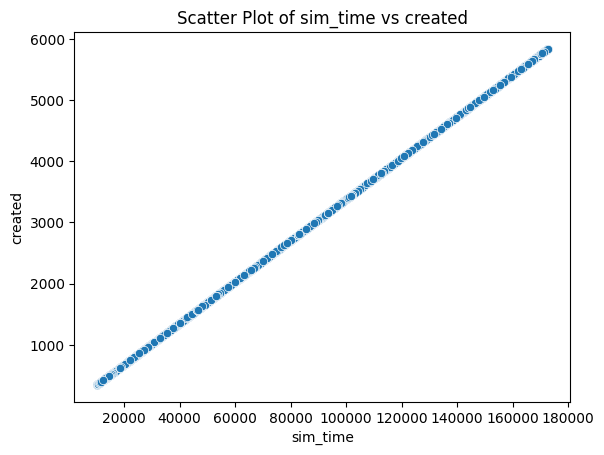

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='created', data=df)
plt.xlabel('sim_time')
plt.ylabel('created')
plt.title('Scatter Plot of sim_time vs created')
plt.show()

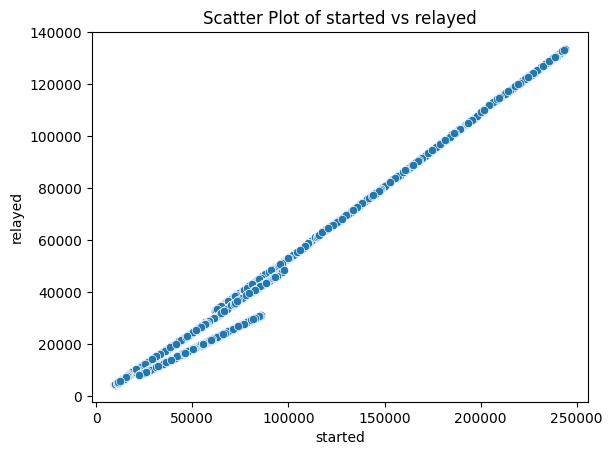

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='started', y='relayed', data=df)
plt.xlabel('started')
plt.ylabel('relayed')
plt.title('Scatter Plot of started vs relayed')
plt.show()

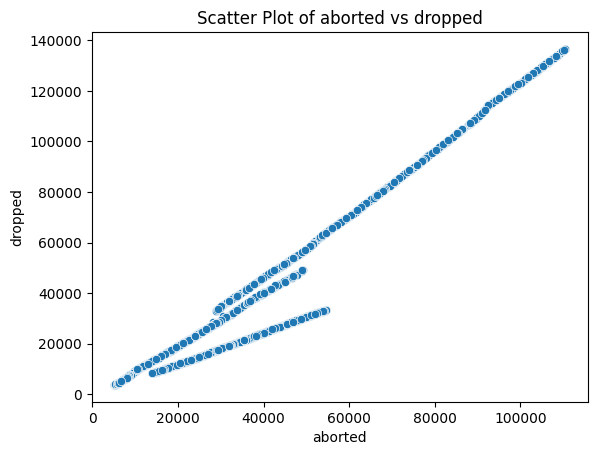

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='aborted', y='dropped', data=df)
plt.xlabel('aborted')
plt.ylabel('dropped')
plt.title('Scatter Plot of aborted vs dropped')
plt.show()

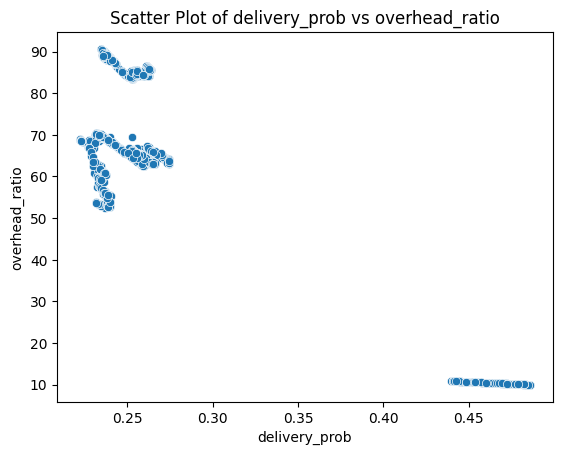

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivery_prob', y='overhead_ratio', data=df)
plt.xlabel('delivery_prob')
plt.ylabel('overhead_ratio')
plt.title('Scatter Plot of delivery_prob vs overhead_ratio')
plt.show()

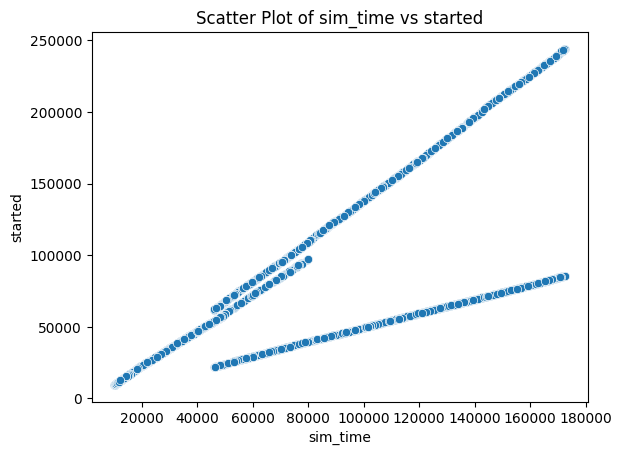

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='started', data=df)
plt.xlabel('sim_time')
plt.ylabel('started')
plt.title('Scatter Plot of sim_time vs started')
plt.show()

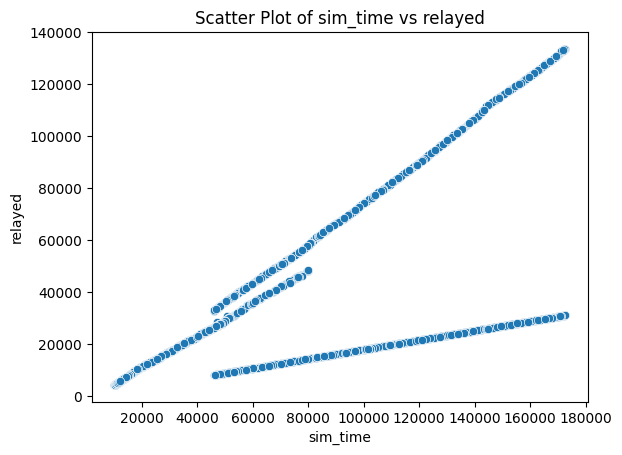

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='relayed', data=df)
plt.xlabel('sim_time')
plt.ylabel('relayed')
plt.title('Scatter Plot of sim_time vs relayed')
plt.show()

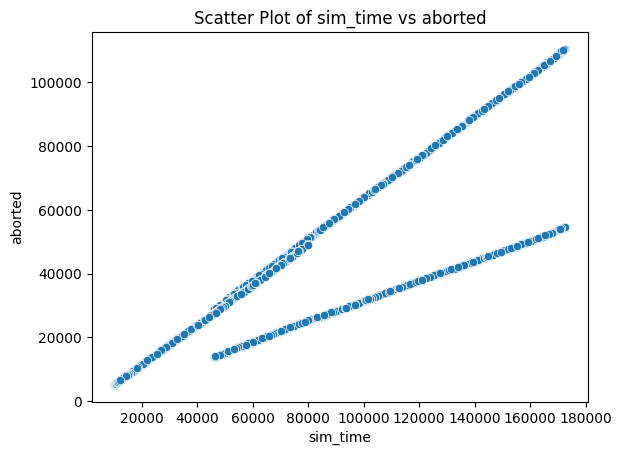

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='aborted', data=df)
plt.xlabel('sim_time')
plt.ylabel('aborted')
plt.title('Scatter Plot of sim_time vs aborted')
plt.show()

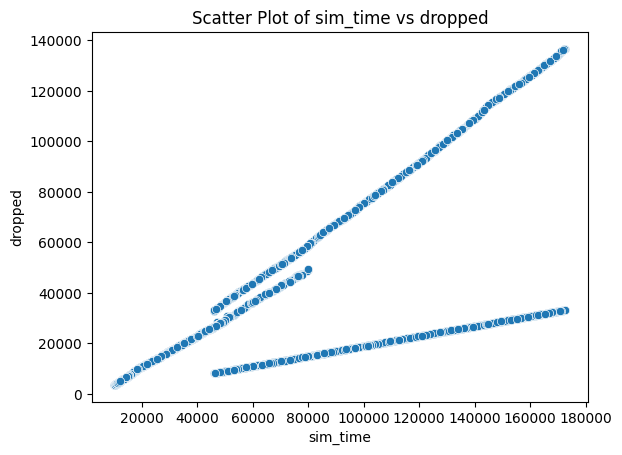

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='dropped', data=df)
plt.xlabel('sim_time')
plt.ylabel('dropped')
plt.title('Scatter Plot of sim_time vs dropped')
plt.show()

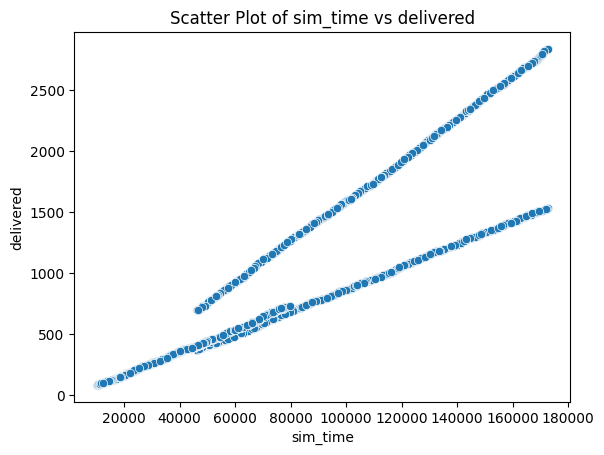

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='delivered', data=df)
plt.xlabel('sim_time')
plt.ylabel('delivered')
plt.title('Scatter Plot of sim_time vs delivered')
plt.show()

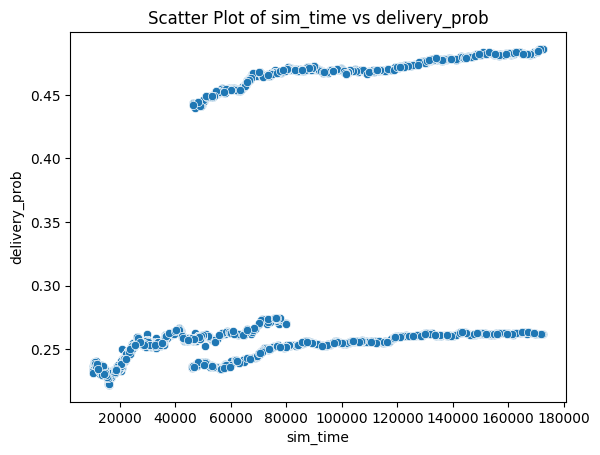

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='delivery_prob', data=df)
plt.xlabel('sim_time')
plt.ylabel('delivery_prob')
plt.title('Scatter Plot of sim_time vs delivery_prob')
plt.show()

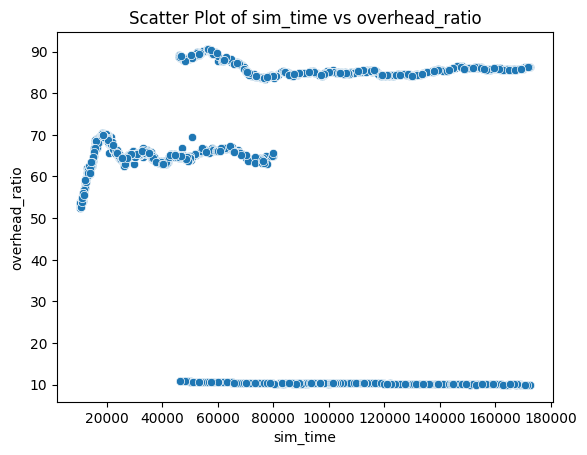

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='overhead_ratio', data=df)
plt.xlabel('sim_time')
plt.ylabel('overhead_ratio')
plt.title('Scatter Plot of sim_time vs overhead_ratio')
plt.show()

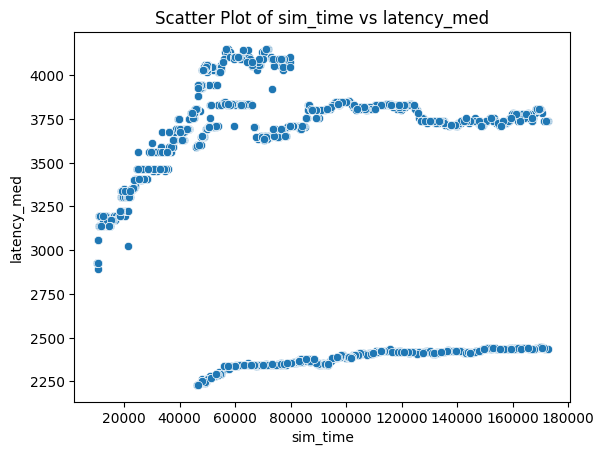

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='latency_med', data=df)
plt.xlabel('sim_time')
plt.ylabel('latency_med')
plt.title('Scatter Plot of sim_time vs latency_med')
plt.show()

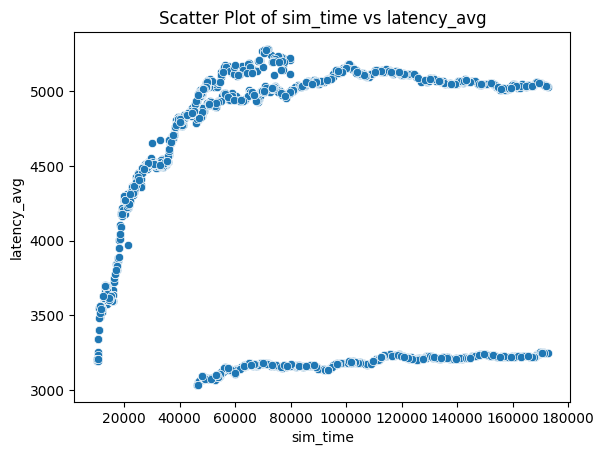

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='latency_avg', data=df)
plt.xlabel('sim_time')
plt.ylabel('latency_avg')
plt.title('Scatter Plot of sim_time vs latency_avg')
plt.show()

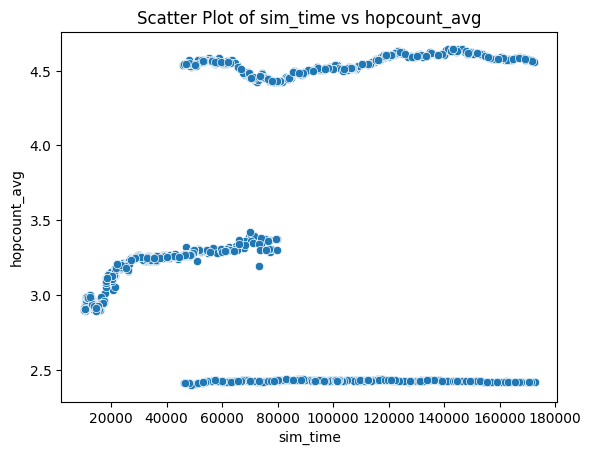

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='hopcount_avg', data=df)
plt.xlabel('sim_time')
plt.ylabel('hopcount_avg')
plt.title('Scatter Plot of sim_time vs hopcount_avg')
plt.show()

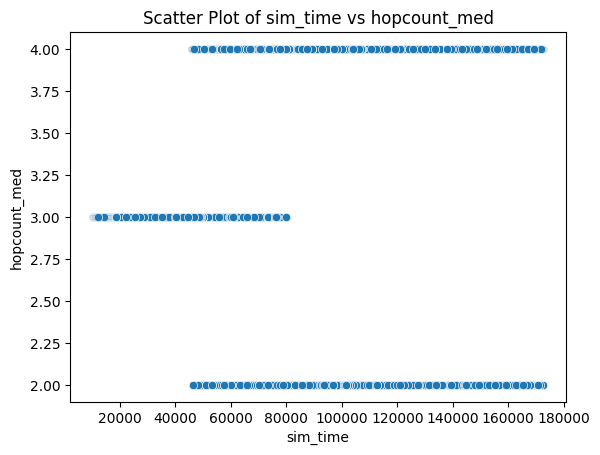

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='hopcount_med', data=df)
plt.xlabel('sim_time')
plt.ylabel('hopcount_med')
plt.title('Scatter Plot of sim_time vs hopcount_med')
plt.show()

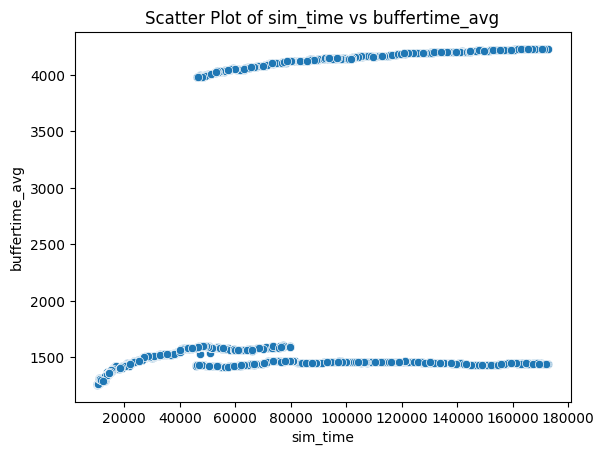

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='buffertime_avg', data=df)
plt.xlabel('sim_time')
plt.ylabel('buffertime_avg')
plt.title('Scatter Plot of sim_time vs buffertime_avg')
plt.show()

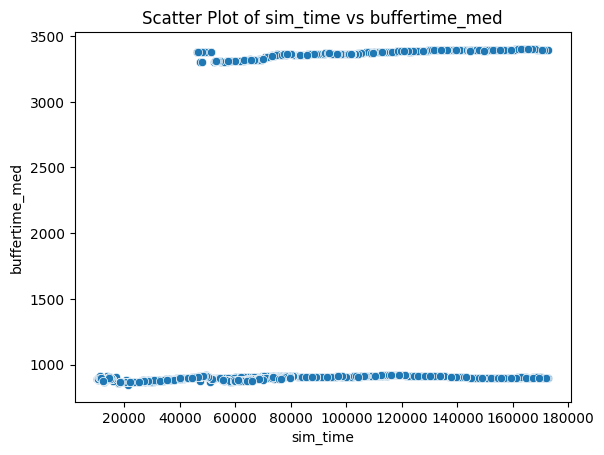

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='sim_time', y='buffertime_med', data=df)
plt.xlabel('sim_time')
plt.ylabel('buffertime_med')
plt.title('Scatter Plot of sim_time vs buffertime_med')
plt.show()

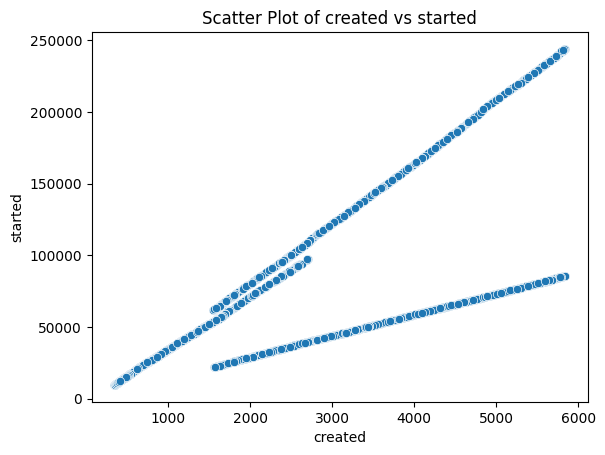

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='created', y='started', data=df)
plt.xlabel('created')
plt.ylabel('started')
plt.title('Scatter Plot of created vs started')
plt.show()

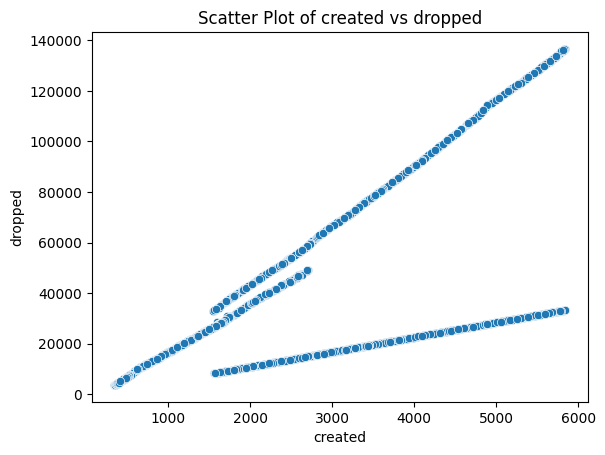

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='created', y='dropped', data=df)
plt.xlabel('created')
plt.ylabel('dropped')
plt.title('Scatter Plot of created vs dropped')
plt.show()

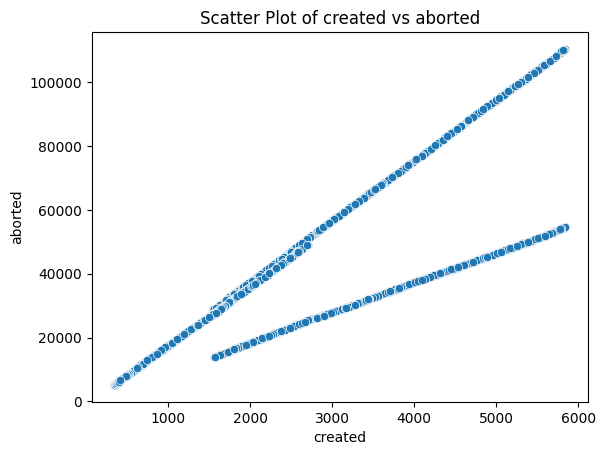

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='created', y='aborted', data=df)
plt.xlabel('created')
plt.ylabel('aborted')
plt.title('Scatter Plot of created vs aborted')
plt.show()

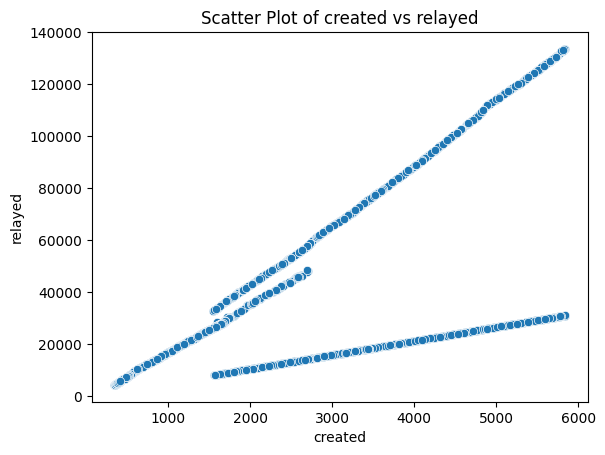

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='created', y='relayed', data=df)
plt.xlabel('created')
plt.ylabel('relayed')
plt.title('Scatter Plot of created vs relayed')
plt.show()

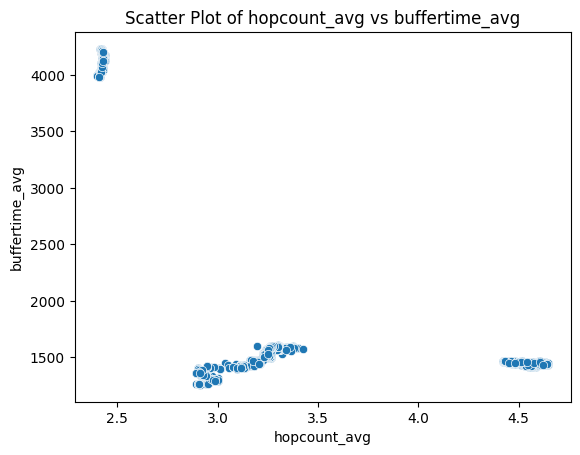

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='hopcount_avg', y='buffertime_avg', data=df)
plt.xlabel('hopcount_avg')
plt.ylabel('buffertime_avg')
plt.title('Scatter Plot of hopcount_avg vs buffertime_avg')
plt.show()

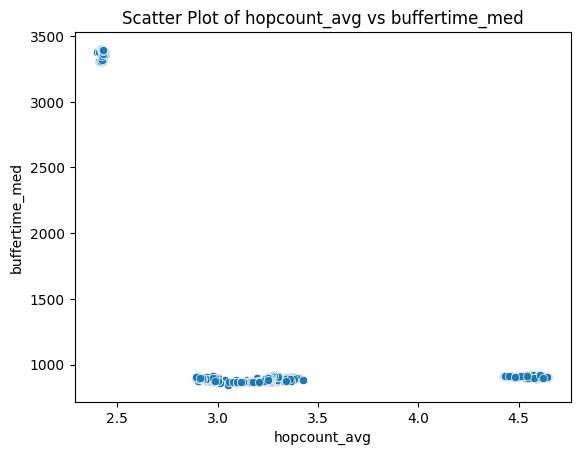

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='hopcount_avg', y='buffertime_med', data=df)
plt.xlabel('hopcount_avg')
plt.ylabel('buffertime_med')
plt.title('Scatter Plot of hopcount_avg vs buffertime_med')
plt.show()

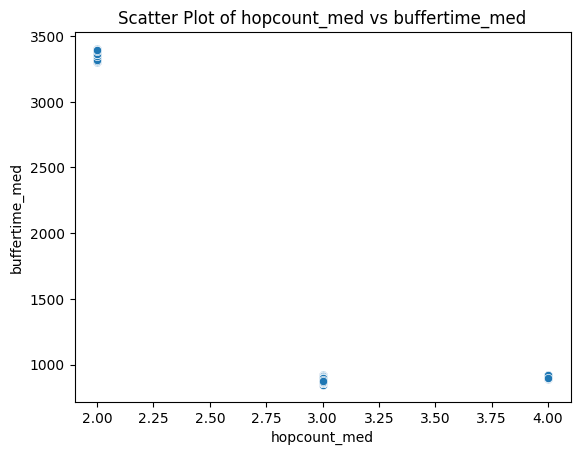

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='hopcount_med', y='buffertime_med', data=df)
plt.xlabel('hopcount_med')
plt.ylabel('buffertime_med')
plt.title('Scatter Plot of hopcount_med vs buffertime_med')
plt.show()

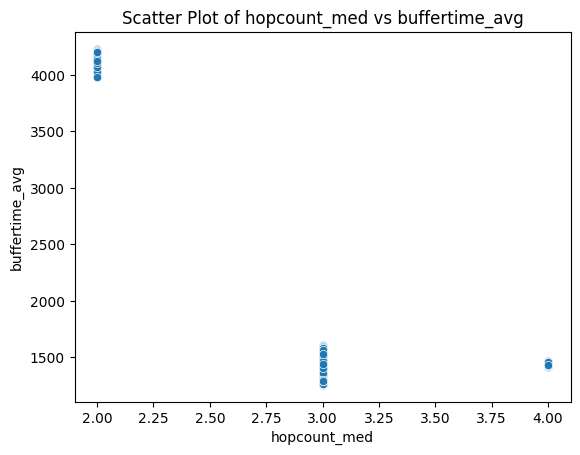

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='hopcount_med', y='buffertime_avg', data=df)
plt.xlabel('hopcount_med')
plt.ylabel('buffertime_avg')
plt.title('Scatter Plot of hopcount_med vs buffertime_avg')
plt.show()

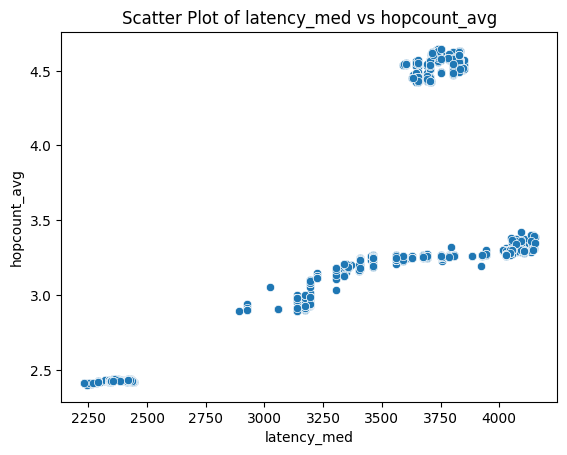

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='latency_med', y='hopcount_avg', data=df)
plt.xlabel('latency_med')
plt.ylabel('hopcount_avg')
plt.title('Scatter Plot of latency_med vs hopcount_avg')
plt.show()

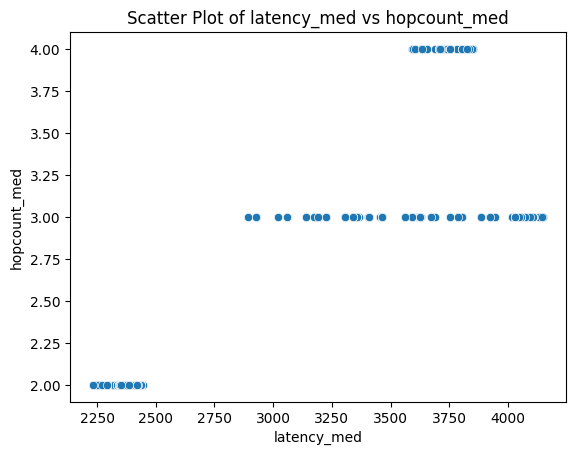

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='latency_med', y='hopcount_med', data=df)
plt.xlabel('latency_med')
plt.ylabel('hopcount_med')
plt.title('Scatter Plot of latency_med vs hopcount_med')
plt.show()

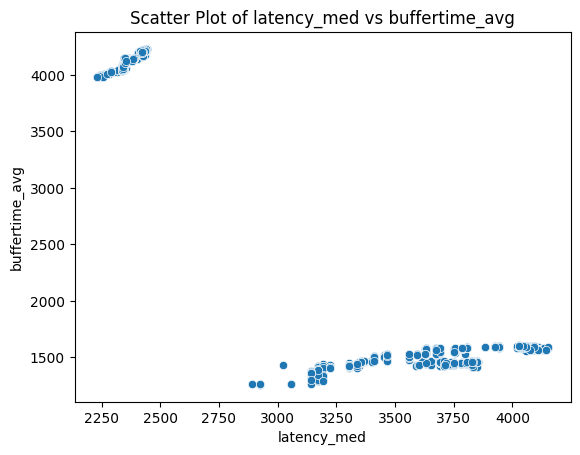

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='latency_med', y='buffertime_avg', data=df)
plt.xlabel('latency_med')
plt.ylabel('buffertime_avg')
plt.title('Scatter Plot of latency_med vs buffertime_avg')
plt.show()

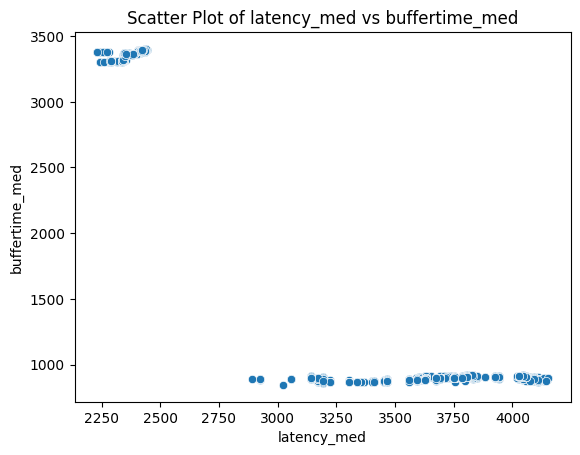

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='latency_med', y='buffertime_med', data=df)
plt.xlabel('latency_med')
plt.ylabel('buffertime_med')
plt.title('Scatter Plot of latency_med vs buffertime_med')
plt.show()

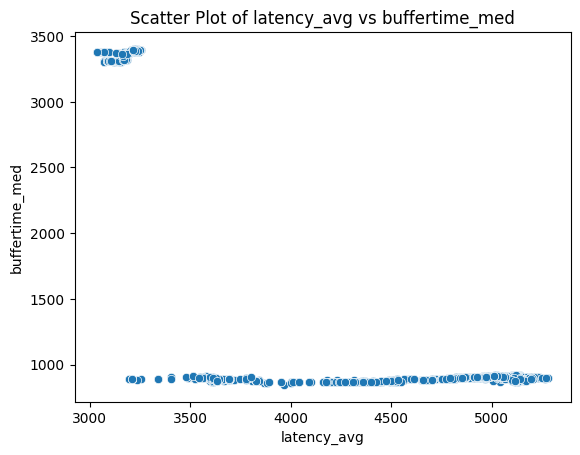

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='latency_avg', y='buffertime_med', data=df)
plt.xlabel('latency_avg')
plt.ylabel('buffertime_med')
plt.title('Scatter Plot of latency_avg vs buffertime_med')
plt.show()

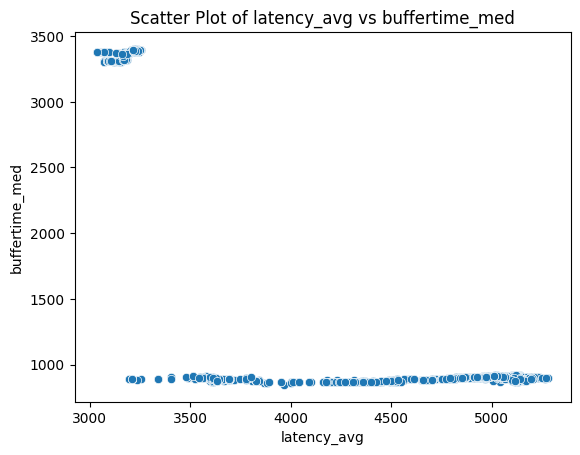

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='latency_avg', y='buffertime_med', data=df)
plt.xlabel('latency_avg')
plt.ylabel('buffertime_med')
plt.title('Scatter Plot of latency_avg vs buffertime_med')
plt.show()

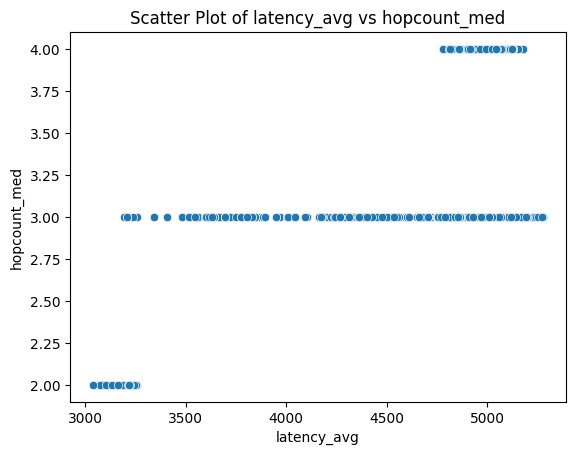

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='latency_avg', y='hopcount_med', data=df)
plt.xlabel('latency_avg')
plt.ylabel('hopcount_med')
plt.title('Scatter Plot of latency_avg vs hopcount_med')
plt.show()

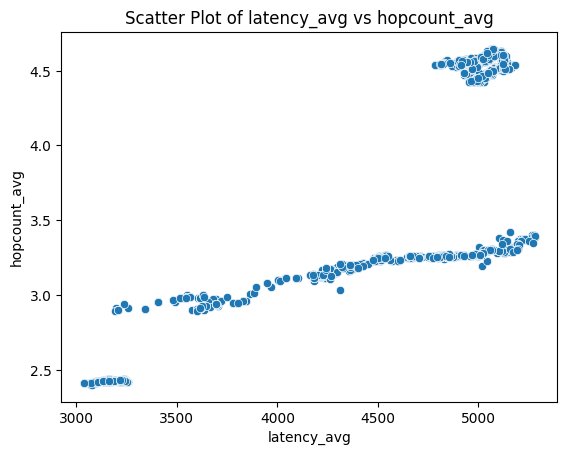

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='latency_avg', y='hopcount_avg', data=df)
plt.xlabel('latency_avg')
plt.ylabel('hopcount_avg')
plt.title('Scatter Plot of latency_avg vs hopcount_avg')
plt.show()

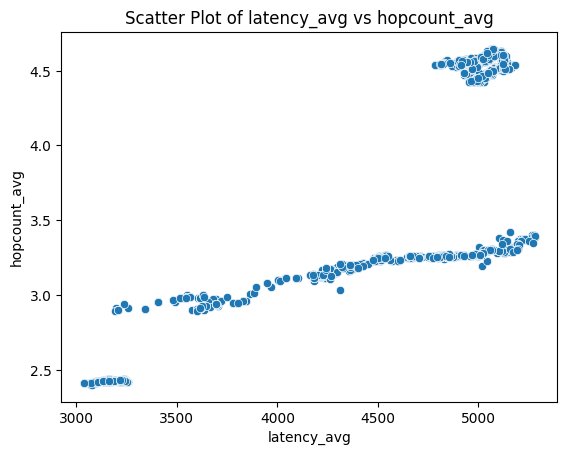

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='latency_avg', y='hopcount_avg', data=df)
plt.xlabel('latency_avg')
plt.ylabel('hopcount_avg')
plt.title('Scatter Plot of latency_avg vs hopcount_avg')
plt.show()

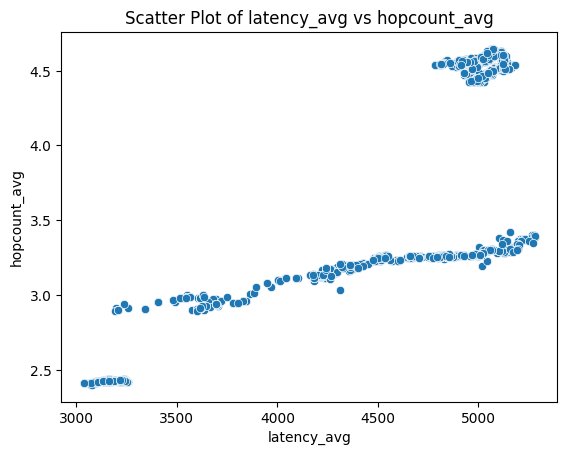

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='latency_avg', y='hopcount_avg', data=df)
plt.xlabel('latency_avg')
plt.ylabel('hopcount_avg')
plt.title('Scatter Plot of latency_avg vs hopcount_avg')
plt.show()

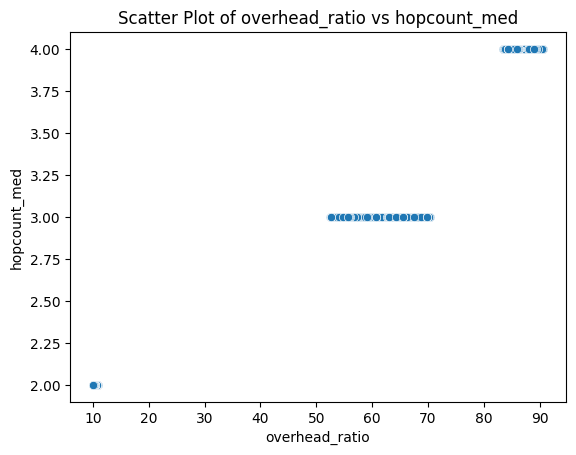

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='overhead_ratio', y='hopcount_med', data=df)
plt.xlabel('overhead_ratio')
plt.ylabel('hopcount_med')
plt.title('Scatter Plot of overhead_ratio vs hopcount_med')
plt.show()

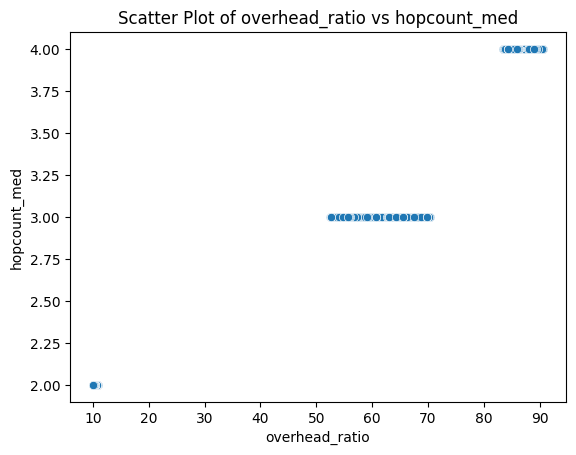

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='overhead_ratio', y='hopcount_med', data=df)
plt.xlabel('overhead_ratio')
plt.ylabel('hopcount_med')
plt.title('Scatter Plot of overhead_ratio vs hopcount_med')
plt.show()

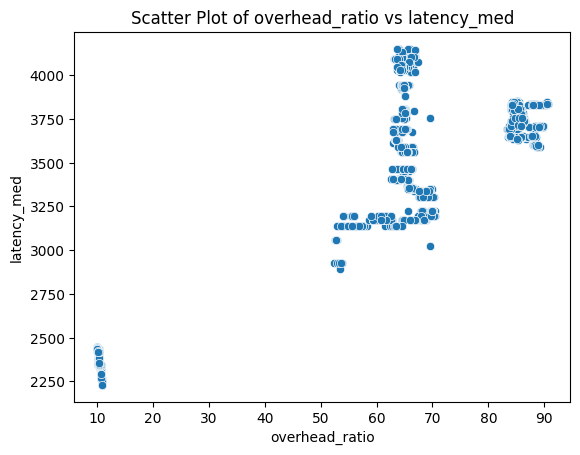

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='overhead_ratio', y='latency_med', data=df)
plt.xlabel('overhead_ratio')
plt.ylabel('latency_med')
plt.title('Scatter Plot of overhead_ratio vs latency_med')
plt.show()

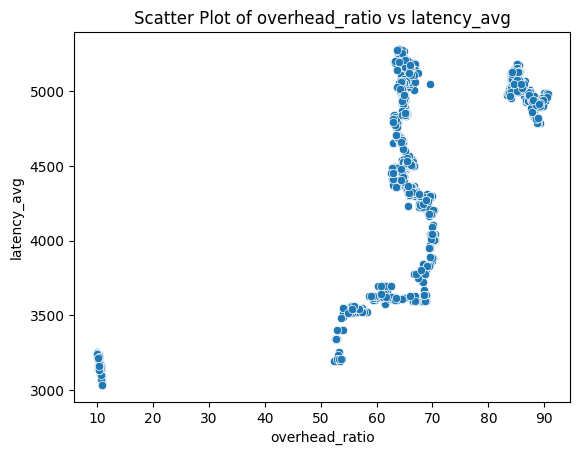

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='overhead_ratio', y='latency_avg', data=df)
plt.xlabel('overhead_ratio')
plt.ylabel('latency_avg')
plt.title('Scatter Plot of overhead_ratio vs latency_avg')
plt.show()

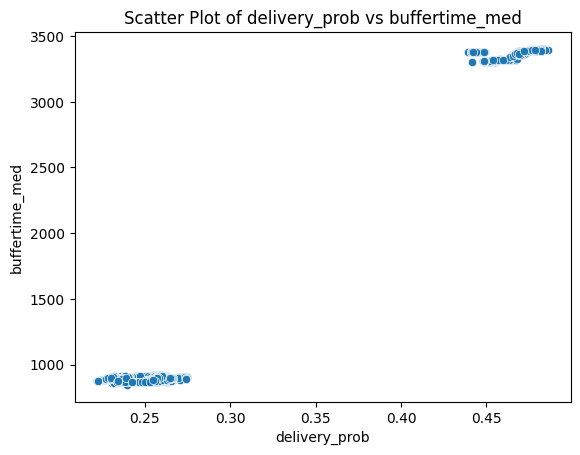

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivery_prob', y='buffertime_med', data=df)
plt.xlabel('delivery_prob')
plt.ylabel('buffertime_med')
plt.title('Scatter Plot of delivery_prob vs buffertime_med')
plt.show()

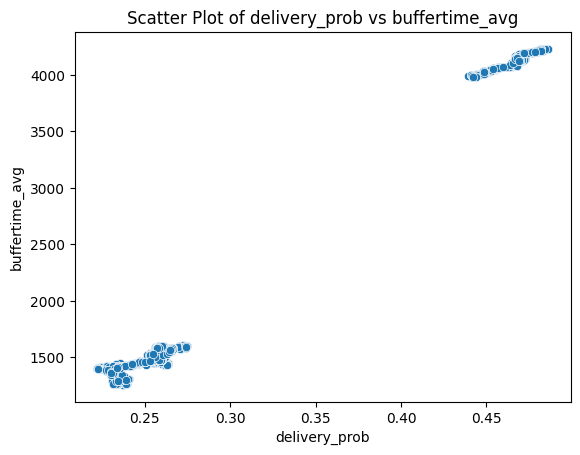

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivery_prob', y='buffertime_avg', data=df)
plt.xlabel('delivery_prob')
plt.ylabel('buffertime_avg')
plt.title('Scatter Plot of delivery_prob vs buffertime_avg')
plt.show()

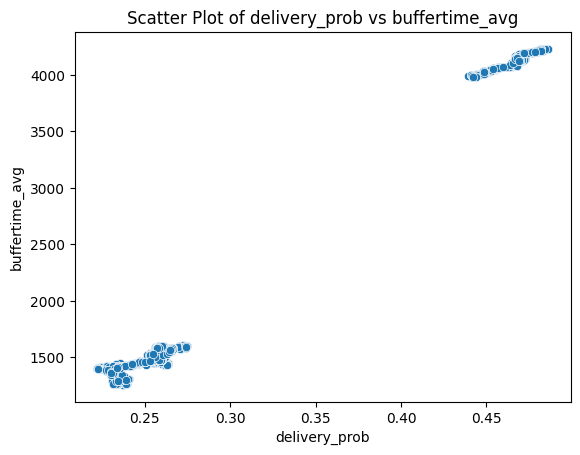

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivery_prob', y='buffertime_avg', data=df)
plt.xlabel('delivery_prob')
plt.ylabel('buffertime_avg')
plt.title('Scatter Plot of delivery_prob vs buffertime_avg')
plt.show()

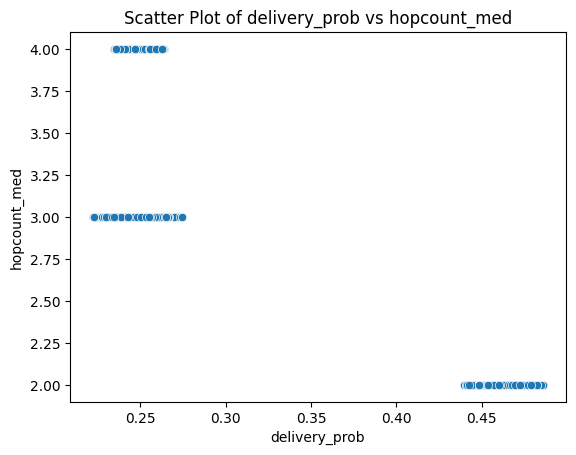

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivery_prob', y='hopcount_med', data=df)
plt.xlabel('delivery_prob')
plt.ylabel('hopcount_med')
plt.title('Scatter Plot of delivery_prob vs hopcount_med')
plt.show()

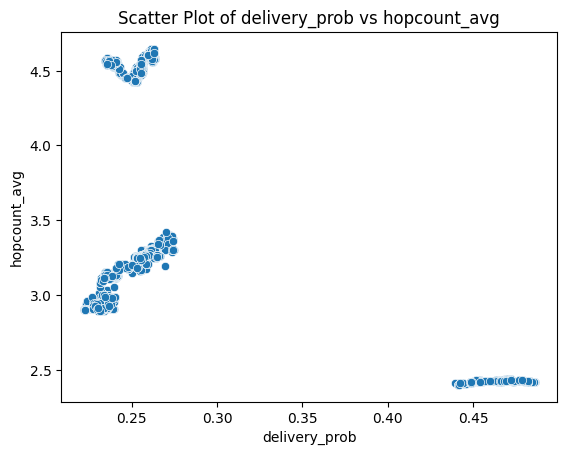

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivery_prob', y='hopcount_avg', data=df)
plt.xlabel('delivery_prob')
plt.ylabel('hopcount_avg')
plt.title('Scatter Plot of delivery_prob vs hopcount_avg')
plt.show()

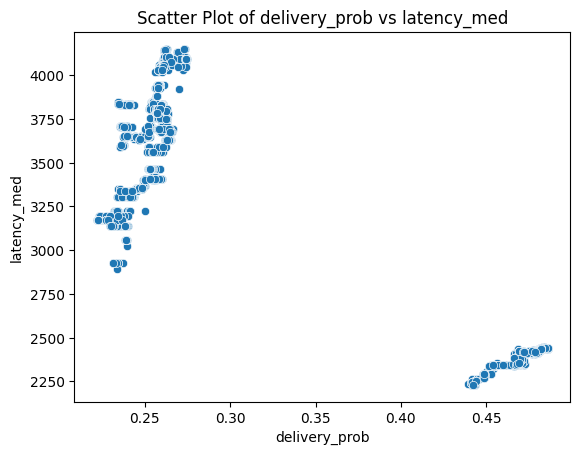

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivery_prob', y='latency_med', data=df)
plt.xlabel('delivery_prob')
plt.ylabel('latency_med')
plt.title('Scatter Plot of delivery_prob vs latency_med')
plt.show()

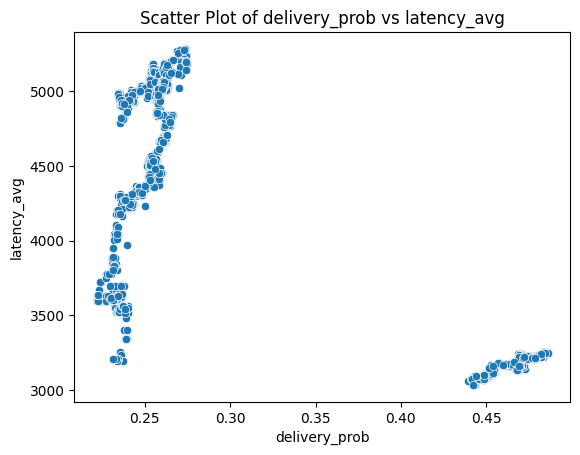

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivery_prob', y='latency_avg', data=df)
plt.xlabel('delivery_prob')
plt.ylabel('latency_avg')
plt.title('Scatter Plot of delivery_prob vs latency_avg')
plt.show()

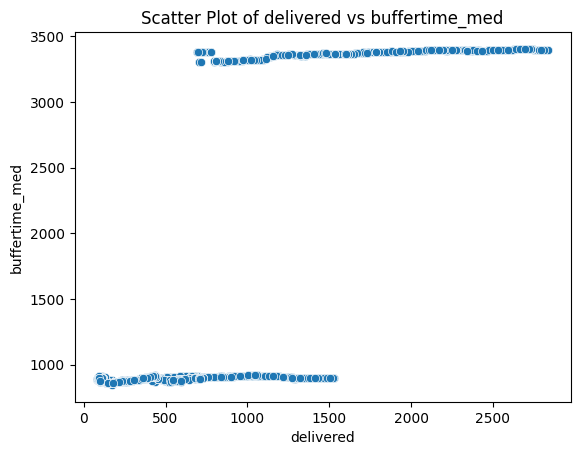

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivered', y='buffertime_med', data=df)
plt.xlabel('delivered')
plt.ylabel('buffertime_med')
plt.title('Scatter Plot of delivered vs buffertime_med')
plt.show()

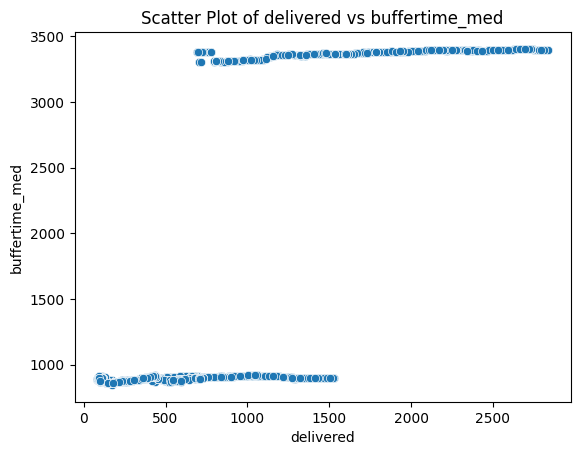

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivered', y='buffertime_med', data=df)
plt.xlabel('delivered')
plt.ylabel('buffertime_med')
plt.title('Scatter Plot of delivered vs buffertime_med')
plt.show()

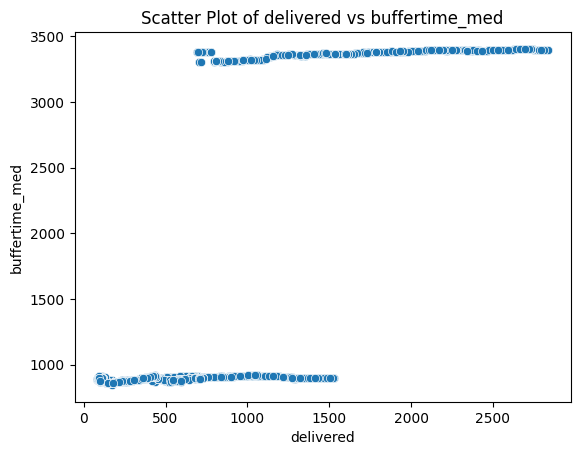

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivered', y='buffertime_med', data=df)
plt.xlabel('delivered')
plt.ylabel('buffertime_med')
plt.title('Scatter Plot of delivered vs buffertime_med')
plt.show()

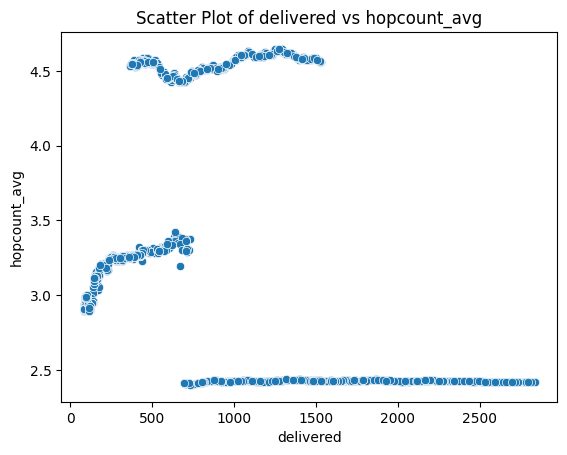

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivered', y='hopcount_avg', data=df)
plt.xlabel('delivered')
plt.ylabel('hopcount_avg')
plt.title('Scatter Plot of delivered vs hopcount_avg')
plt.show()

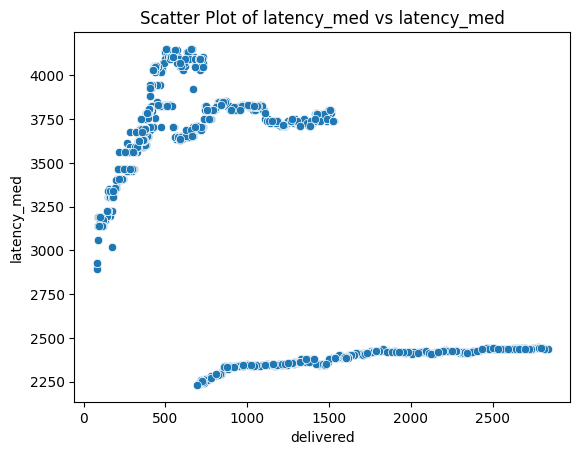

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivered', y='latency_med', data=df)
plt.xlabel('delivered')
plt.ylabel('latency_med')
plt.title('Scatter Plot of latency_med vs latency_med')
plt.show()

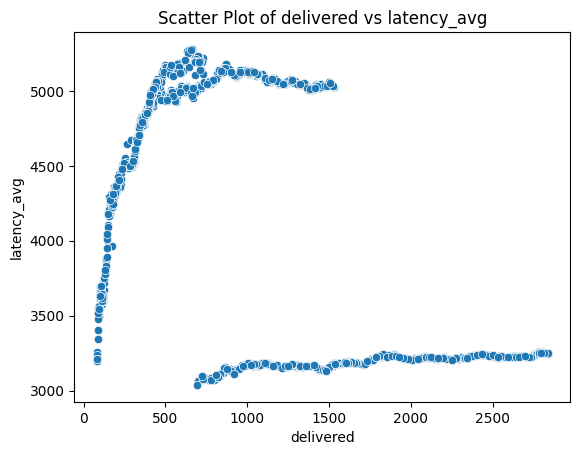

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivered', y='latency_avg', data=df)
plt.xlabel('delivered')
plt.ylabel('latency_avg')
plt.title('Scatter Plot of delivered vs latency_avg')
plt.show()

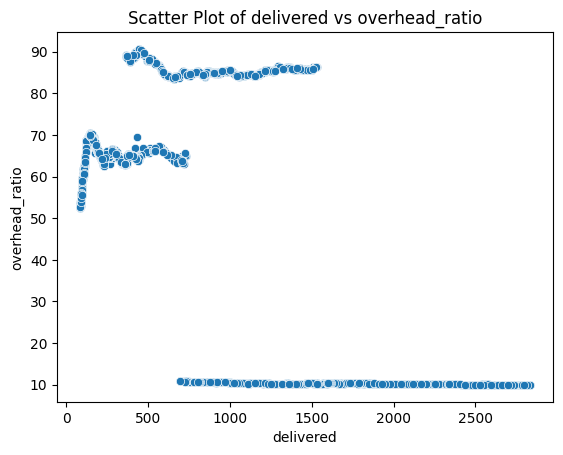

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivered', y='overhead_ratio', data=df)
plt.xlabel('delivered')
plt.ylabel('overhead_ratio')
plt.title('Scatter Plot of delivered vs overhead_ratio')
plt.show()

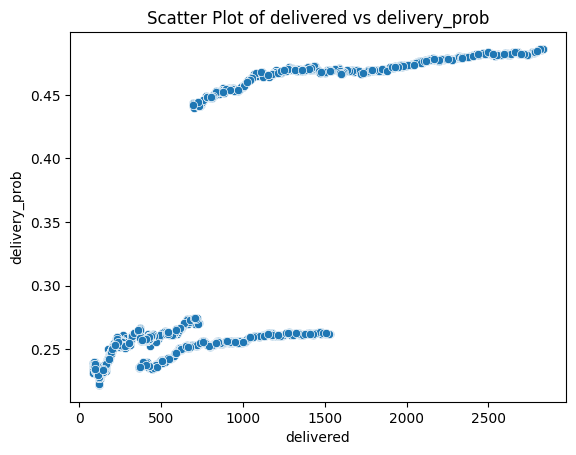

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='delivered', y='delivery_prob', data=df)
plt.xlabel('delivered')
plt.ylabel('delivery_prob')
plt.title('Scatter Plot of delivered vs delivery_prob')
plt.show()

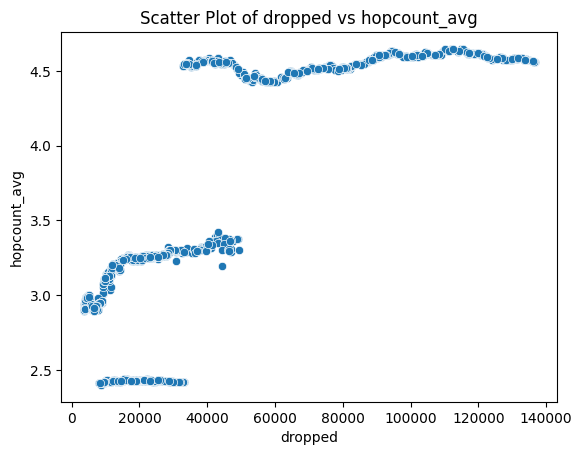

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='dropped', y='hopcount_avg', data=df)
plt.xlabel('dropped')
plt.ylabel('hopcount_avg')
plt.title('Scatter Plot of dropped vs hopcount_avg')
plt.show()

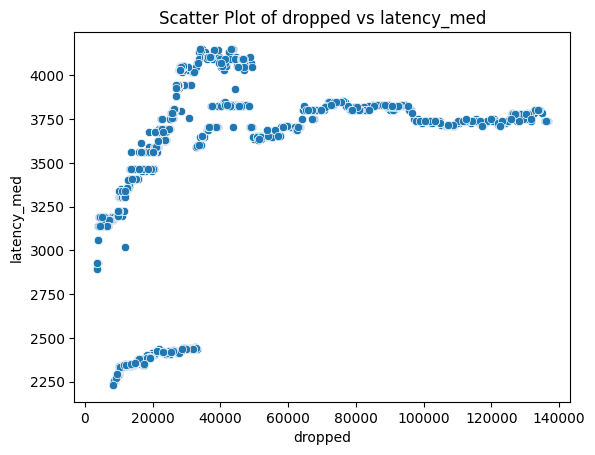

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='dropped', y='latency_med', data=df)
plt.xlabel('dropped')
plt.ylabel('latency_med')
plt.title('Scatter Plot of dropped vs latency_med')
plt.show()

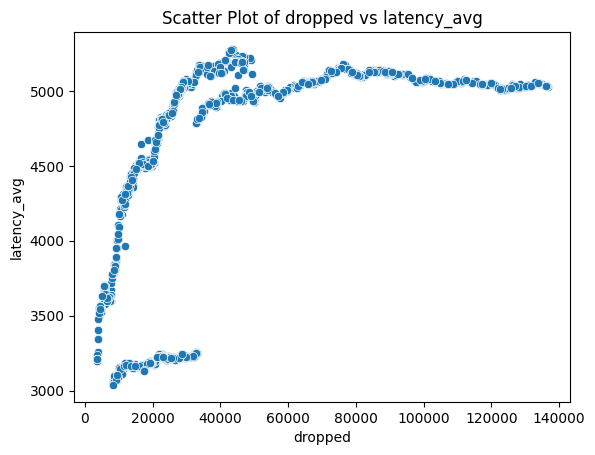

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='dropped', y='latency_avg', data=df)
plt.xlabel('dropped')
plt.ylabel('latency_avg')
plt.title('Scatter Plot of dropped vs latency_avg')
plt.show()

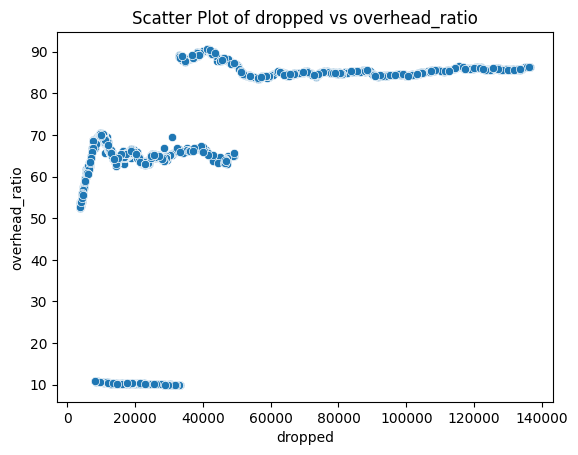

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='dropped', y='overhead_ratio', data=df)
plt.xlabel('dropped')
plt.ylabel('overhead_ratio')
plt.title('Scatter Plot of dropped vs overhead_ratio')
plt.show()


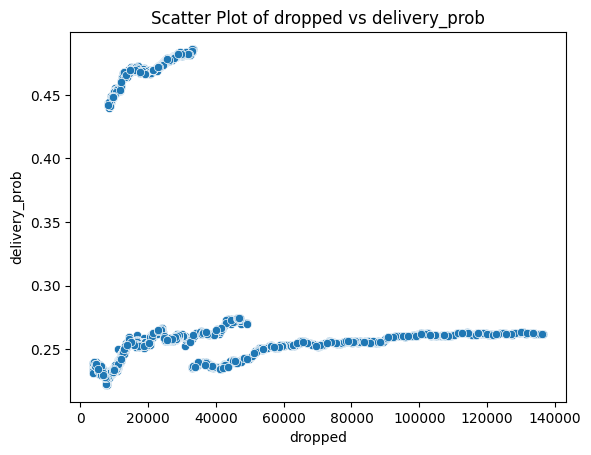

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='dropped', y='delivery_prob', data=df)
plt.xlabel('dropped')
plt.ylabel('delivery_prob')
plt.title('Scatter Plot of dropped vs delivery_prob')
plt.show()

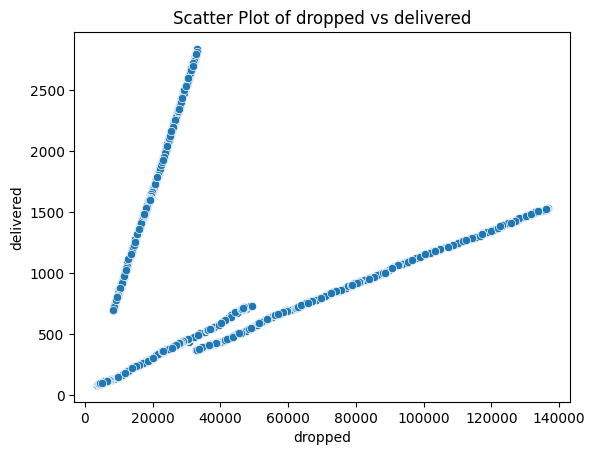

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='dropped', y='delivered', data=df)
plt.xlabel('dropped')
plt.ylabel('delivered')
plt.title('Scatter Plot of dropped vs delivered')
plt.show()

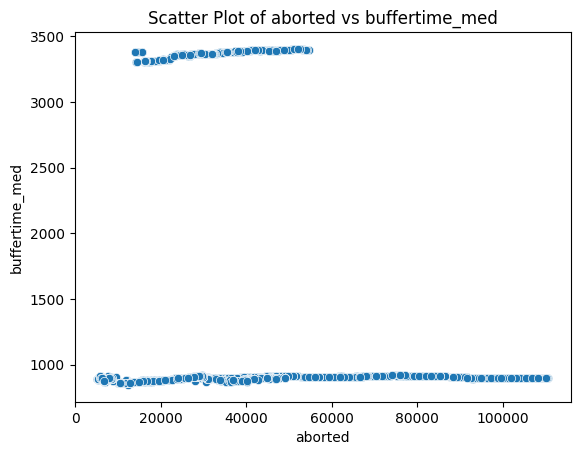

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='aborted', y='buffertime_med', data=df)
plt.xlabel('aborted')
plt.ylabel('buffertime_med')
plt.title('Scatter Plot of aborted vs buffertime_med')
plt.show()

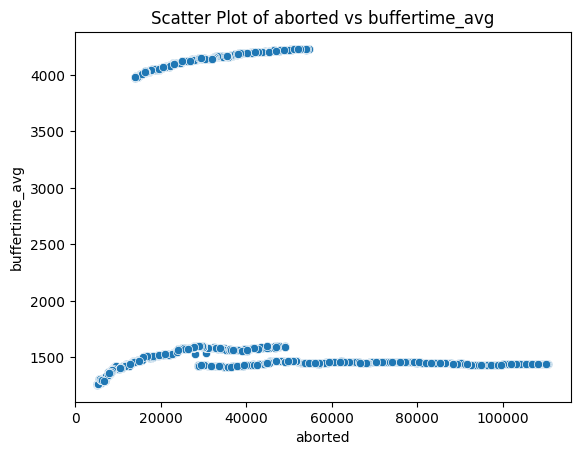

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='aborted', y='buffertime_avg', data=df)
plt.xlabel('aborted')
plt.ylabel('buffertime_avg')
plt.title('Scatter Plot of aborted vs buffertime_avg')
plt.show()

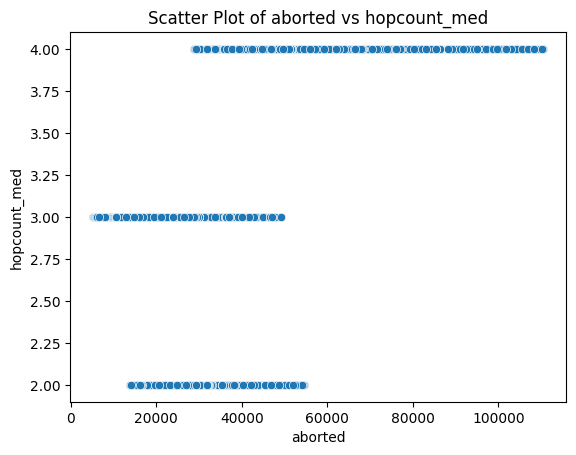

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='aborted', y='hopcount_med', data=df)
plt.xlabel('aborted')
plt.ylabel('hopcount_med')
plt.title('Scatter Plot of aborted vs hopcount_med')
plt.show()

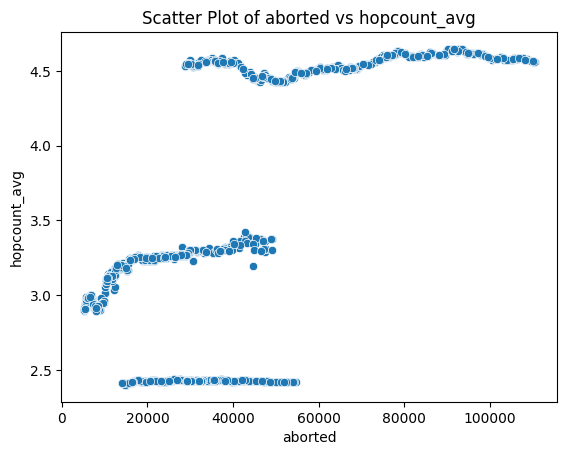

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='aborted', y='hopcount_avg', data=df)
plt.xlabel('aborted')
plt.ylabel('hopcount_avg')
plt.title('Scatter Plot of aborted vs hopcount_avg')
plt.show()

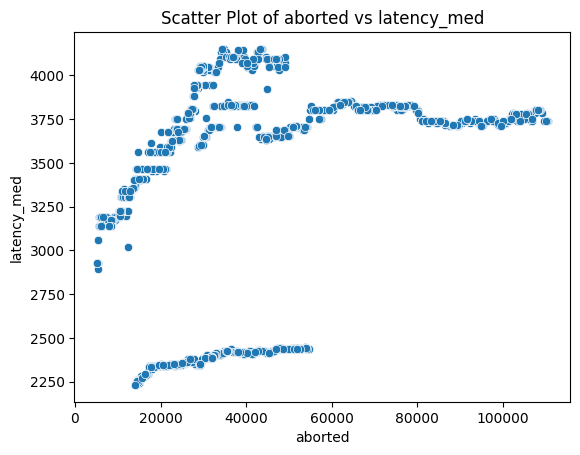

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='aborted', y='latency_med', data=df)
plt.xlabel('aborted')
plt.ylabel('latency_med')
plt.title('Scatter Plot of aborted vs latency_med')
plt.show()

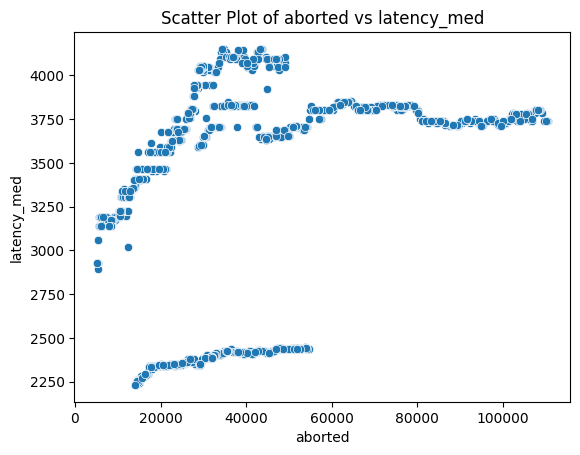

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='aborted', y='latency_med', data=df)
plt.xlabel('aborted')
plt.ylabel('latency_med')
plt.title('Scatter Plot of aborted vs latency_med')
plt.show()

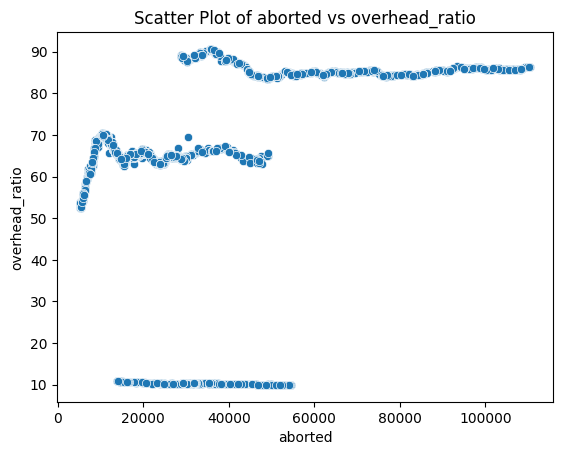

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='aborted', y='overhead_ratio', data=df)
plt.xlabel('aborted')
plt.ylabel('overhead_ratio')
plt.title('Scatter Plot of aborted vs overhead_ratio')
plt.show()

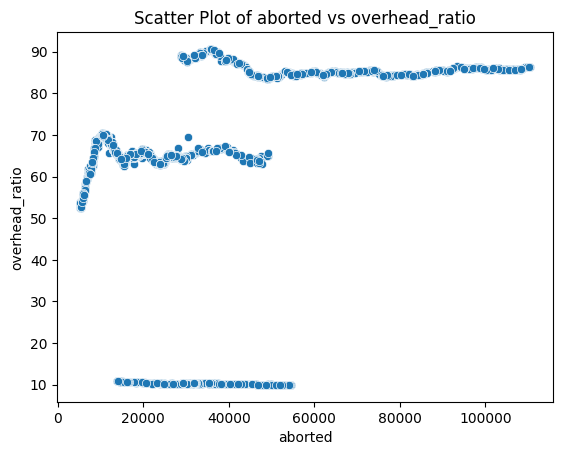

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='aborted', y='overhead_ratio', data=df)
plt.xlabel('aborted')
plt.ylabel('overhead_ratio')
plt.title('Scatter Plot of aborted vs overhead_ratio')
plt.show()

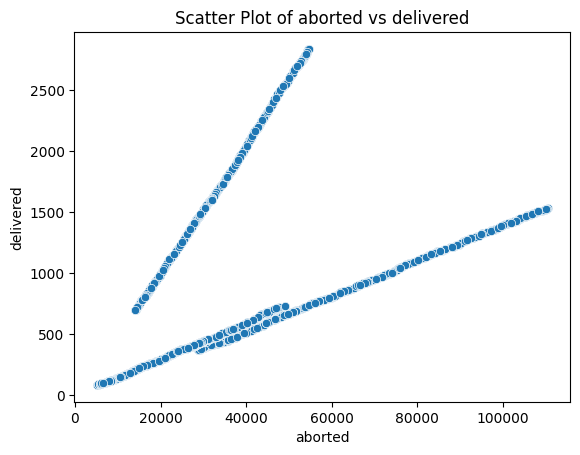

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='aborted', y='delivered', data=df)
plt.xlabel('aborted')
plt.ylabel('delivered')
plt.title('Scatter Plot of aborted vs delivered')
plt.show()

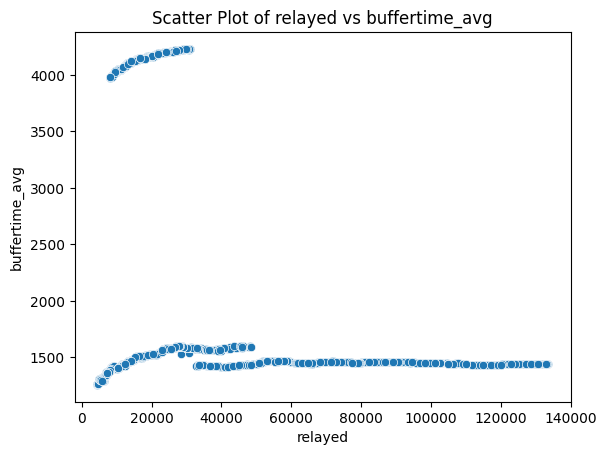

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='relayed', y='buffertime_avg', data=df)
plt.xlabel('relayed')
plt.ylabel('buffertime_avg')
plt.title('Scatter Plot of relayed vs buffertime_avg')
plt.show()

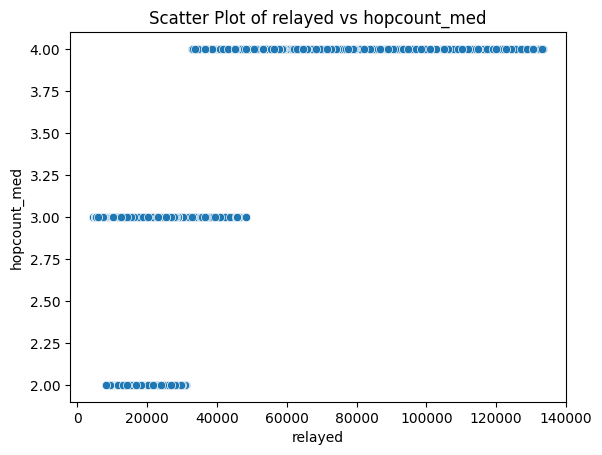

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='relayed', y='hopcount_med', data=df)
plt.xlabel('relayed')
plt.ylabel('hopcount_med')
plt.title('Scatter Plot of relayed vs hopcount_med')
plt.show()

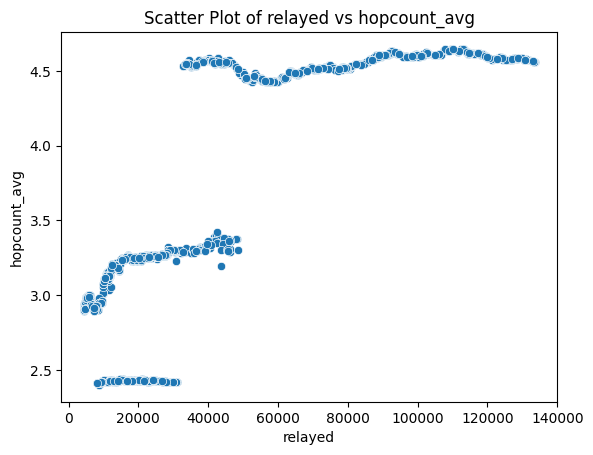

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='relayed', y='hopcount_avg', data=df)
plt.xlabel('relayed')
plt.ylabel('hopcount_avg')
plt.title('Scatter Plot of relayed vs hopcount_avg')
plt.show()

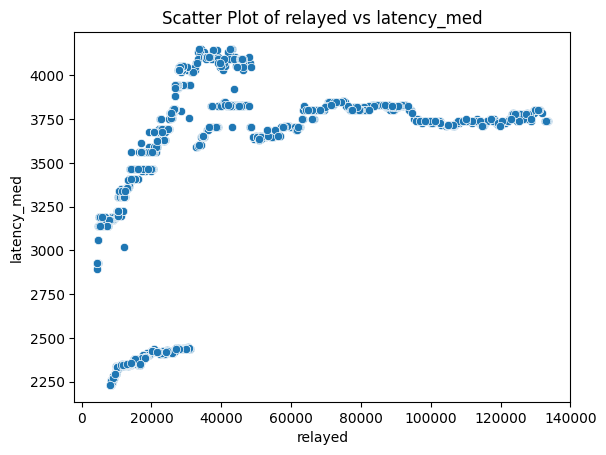

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='relayed', y='latency_med', data=df)
plt.xlabel('relayed')
plt.ylabel('latency_med')
plt.title('Scatter Plot of relayed vs latency_med')
plt.show()

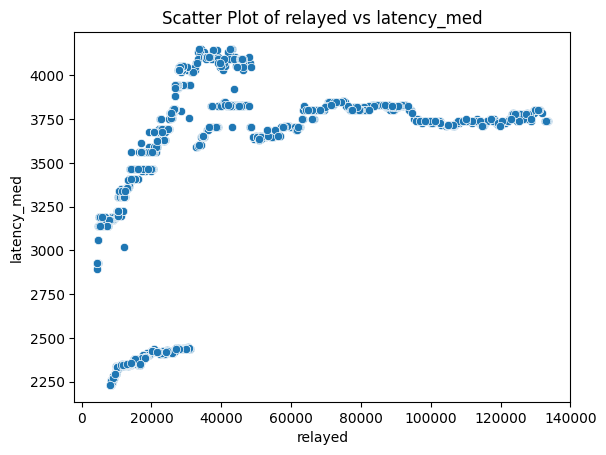

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='relayed', y='latency_med', data=df)
plt.xlabel('relayed')
plt.ylabel('latency_med')
plt.title('Scatter Plot of relayed vs latency_med')
plt.show()

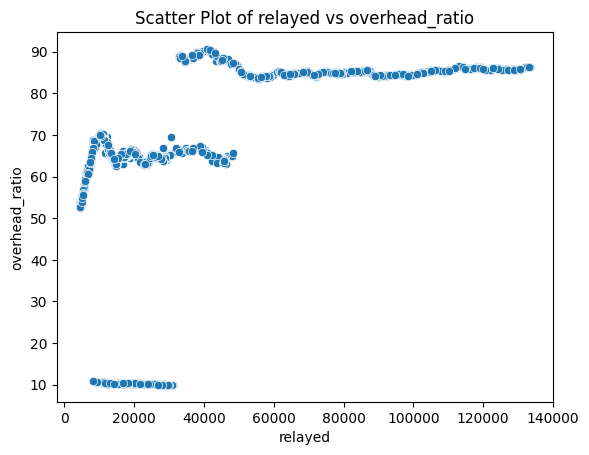

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='relayed', y='overhead_ratio', data=df)
plt.xlabel('relayed')
plt.ylabel('overhead_ratio')
plt.title('Scatter Plot of relayed vs overhead_ratio')
plt.show()

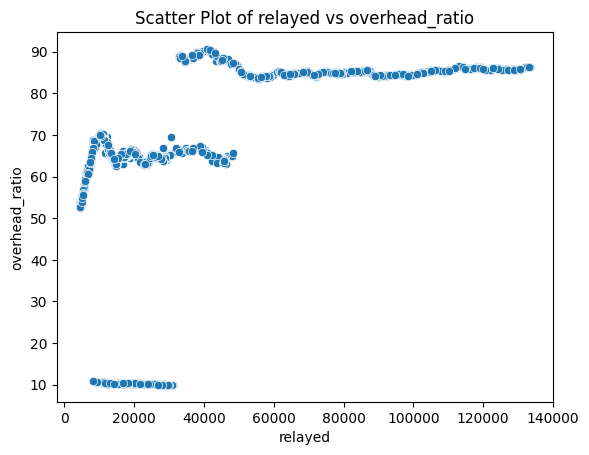

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='relayed', y='overhead_ratio', data=df)
plt.xlabel('relayed')
plt.ylabel('overhead_ratio')
plt.title('Scatter Plot of relayed vs overhead_ratio')
plt.show()

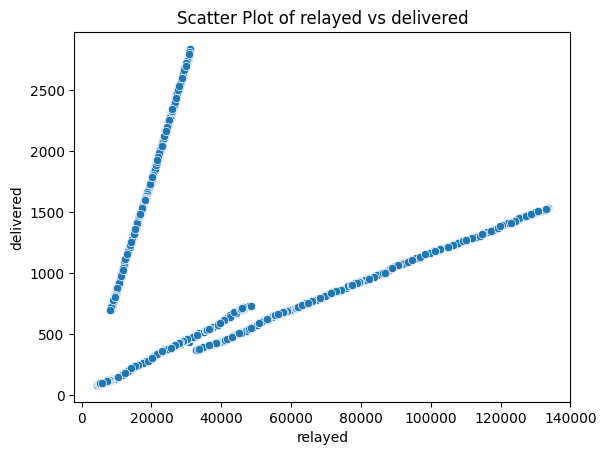

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='relayed', y='delivered', data=df)
plt.xlabel('relayed')
plt.ylabel('delivered')
plt.title('Scatter Plot of relayed vs delivered')
plt.show()

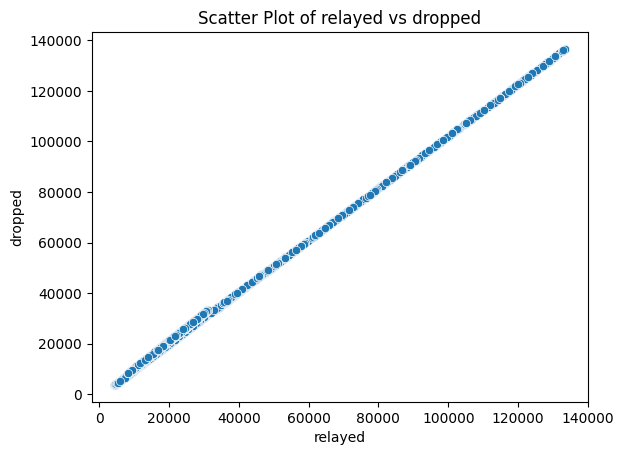

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='relayed', y='dropped', data=df)
plt.xlabel('relayed')
plt.ylabel('dropped')
plt.title('Scatter Plot of relayed vs dropped')
plt.show()

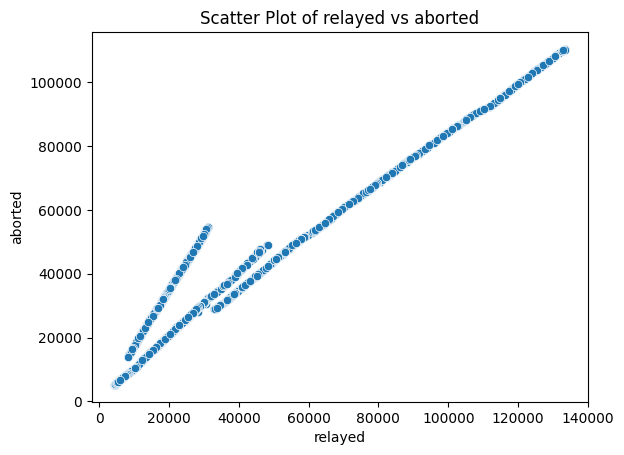

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='relayed', y='aborted', data=df)
plt.xlabel('relayed')
plt.ylabel('aborted')
plt.title('Scatter Plot of relayed vs aborted')
plt.show()

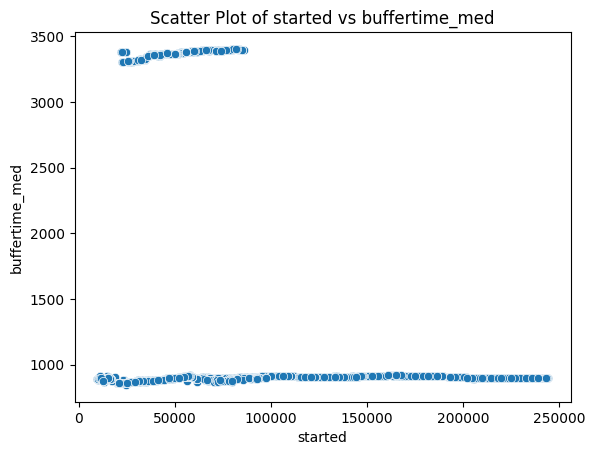

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='started', y='buffertime_med', data=df)
plt.xlabel('started')
plt.ylabel('buffertime_med')
plt.title('Scatter Plot of started vs buffertime_med')
plt.show()

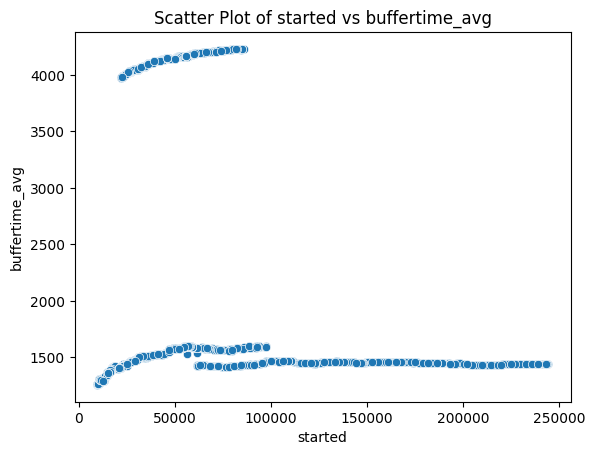

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='started', y='buffertime_avg', data=df)
plt.xlabel('started')
plt.ylabel('buffertime_avg')
plt.title('Scatter Plot of started vs buffertime_avg')
plt.show()

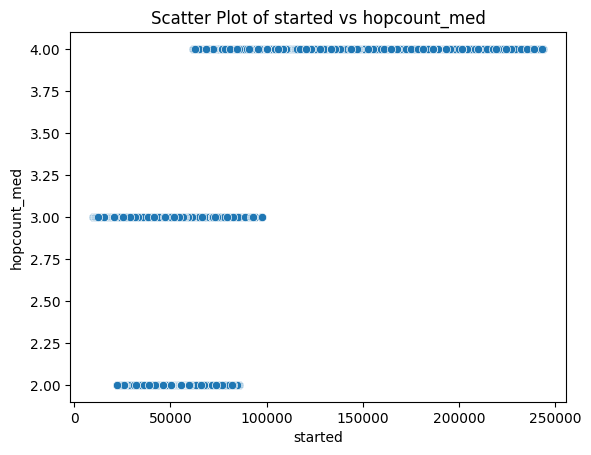

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='started', y='hopcount_med', data=df)
plt.xlabel('started')
plt.ylabel('hopcount_med')
plt.title('Scatter Plot of started vs hopcount_med')
plt.show()

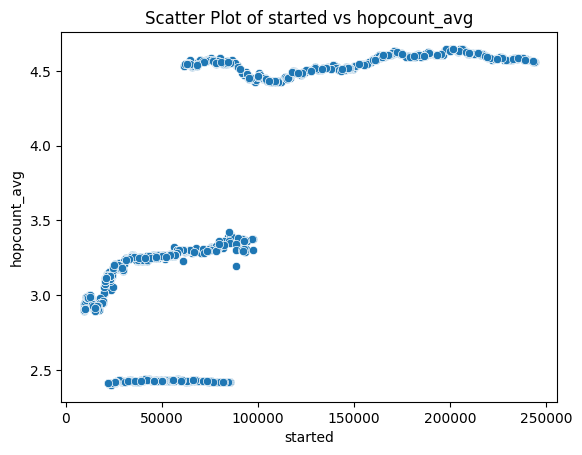

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='started', y='hopcount_avg', data=df)
plt.xlabel('started')
plt.ylabel('hopcount_avg')
plt.title('Scatter Plot of started vs hopcount_avg')
plt.show()

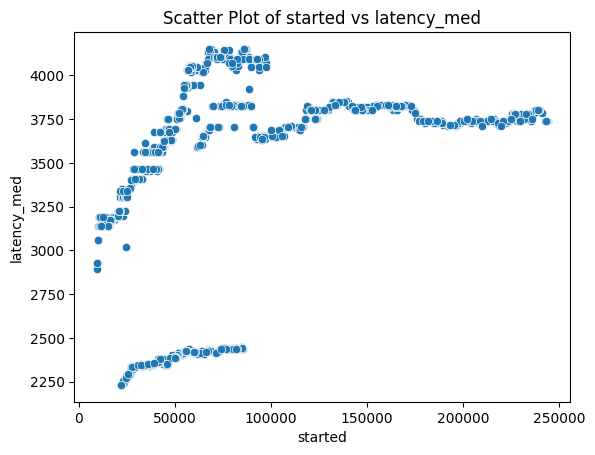

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='started', y='latency_med', data=df)
plt.xlabel('started')
plt.ylabel('latency_med')
plt.title('Scatter Plot of started vs latency_med')
plt.show()

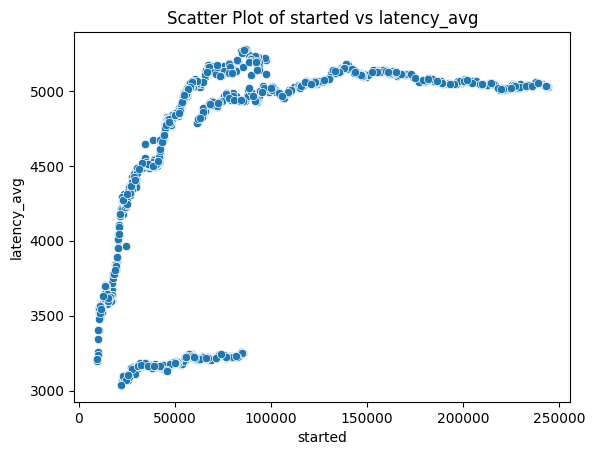

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='started', y='latency_avg', data=df)
plt.xlabel('started')
plt.ylabel('latency_avg')
plt.title('Scatter Plot of started vs latency_avg')
plt.show()

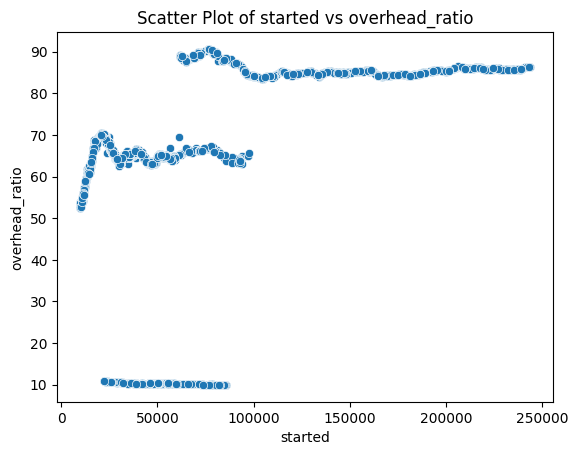

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='started', y='overhead_ratio', data=df)
plt.xlabel('started')
plt.ylabel('overhead_ratio')
plt.title('Scatter Plot of started vs overhead_ratio')
plt.show()

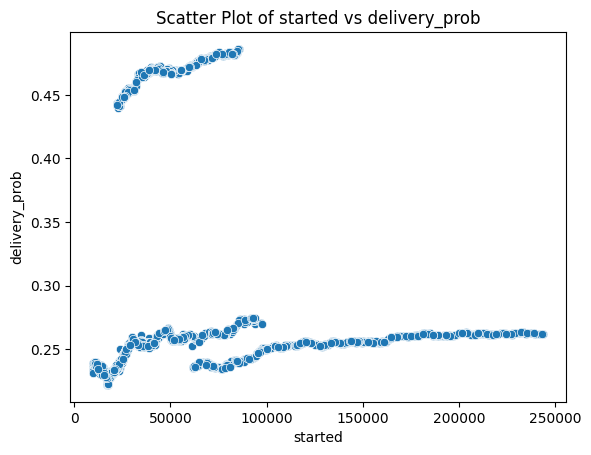

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='started', y='delivery_prob', data=df)
plt.xlabel('started')
plt.ylabel('delivery_prob')
plt.title('Scatter Plot of started vs delivery_prob')
plt.show()

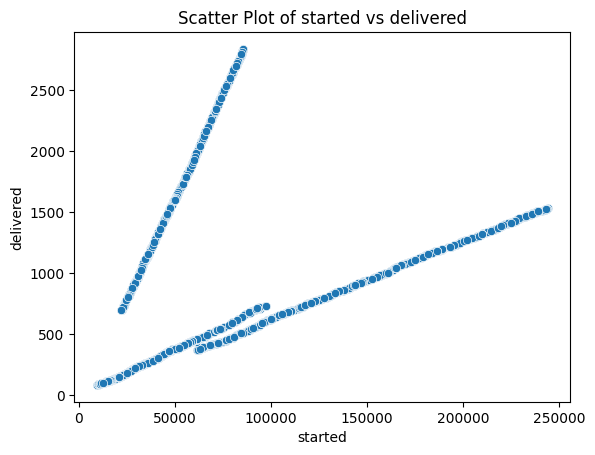

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='started', y='delivered', data=df)
plt.xlabel('started')
plt.ylabel('delivered')
plt.title('Scatter Plot of started vs delivered')
plt.show()

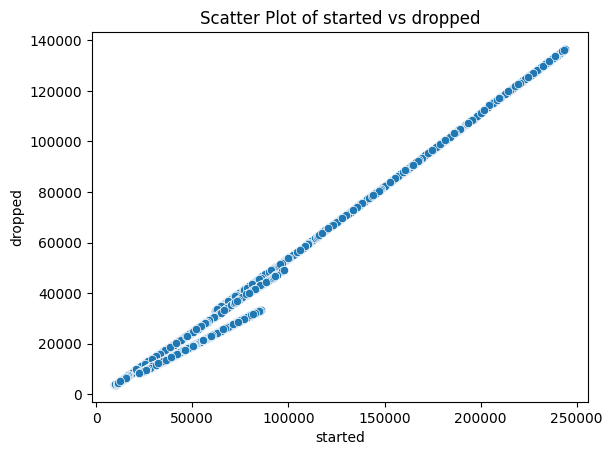

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='started', y='dropped', data=df)
plt.xlabel('started')
plt.ylabel('dropped')
plt.title('Scatter Plot of started vs dropped')
plt.show()

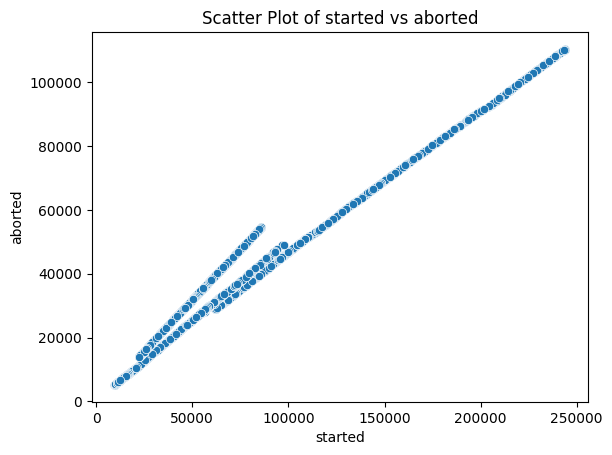

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='started', y='aborted', data=df)
plt.xlabel('started')
plt.ylabel('aborted')
plt.title('Scatter Plot of started vs aborted')
plt.show()

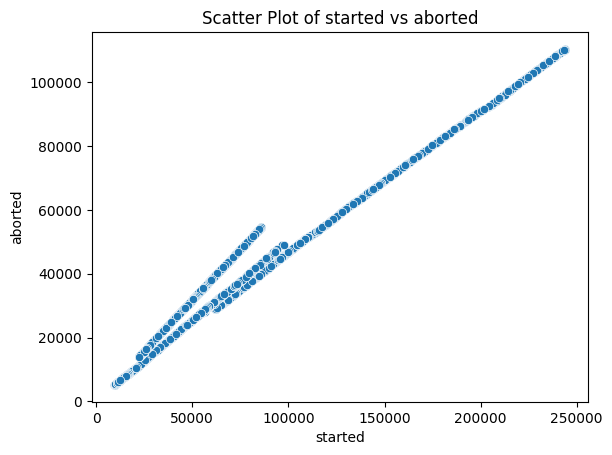

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='started', y='aborted', data=df)
plt.xlabel('started')
plt.ylabel('aborted')
plt.title('Scatter Plot of started vs aborted')
plt.show()

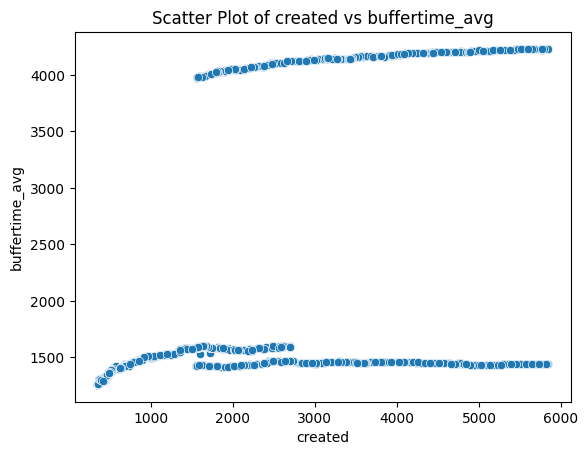

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='created', y='buffertime_avg', data=df)
plt.xlabel('created')
plt.ylabel('buffertime_avg')
plt.title('Scatter Plot of created vs buffertime_avg')
plt.show()

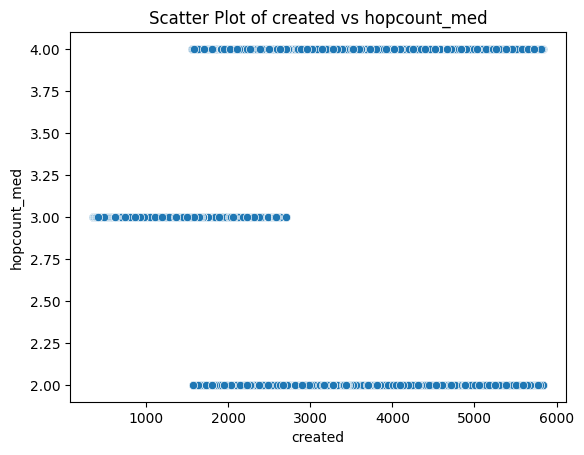

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='created', y='hopcount_med', data=df)
plt.xlabel('created')
plt.ylabel('hopcount_med')
plt.title('Scatter Plot of created vs hopcount_med')
plt.show()

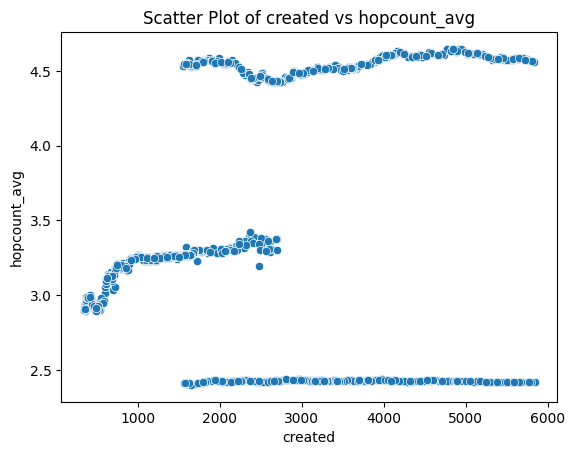

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='created', y='hopcount_avg', data=df)
plt.xlabel('created')
plt.ylabel('hopcount_avg')
plt.title('Scatter Plot of created vs hopcount_avg')
plt.show()

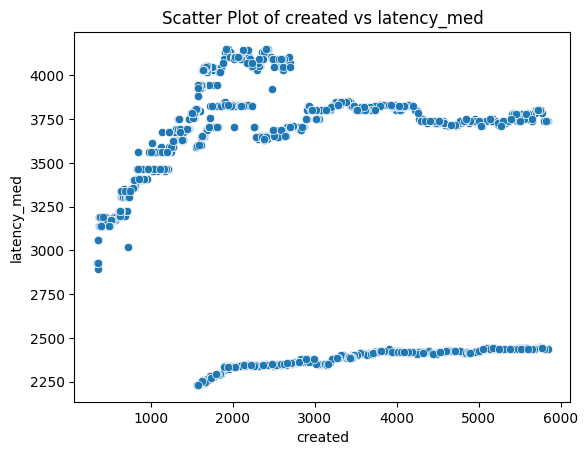

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='created', y='latency_med', data=df)
plt.xlabel('created')
plt.ylabel('latency_med')
plt.title('Scatter Plot of created vs latency_med')
plt.show()

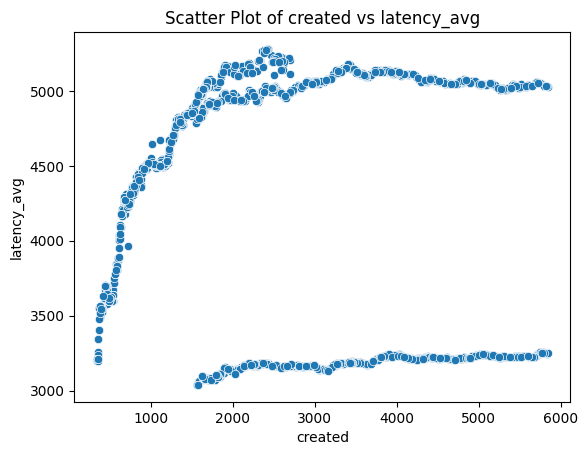

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='created', y='latency_avg', data=df)
plt.xlabel('created')
plt.ylabel('latency_avg')
plt.title('Scatter Plot of created vs latency_avg')
plt.show()

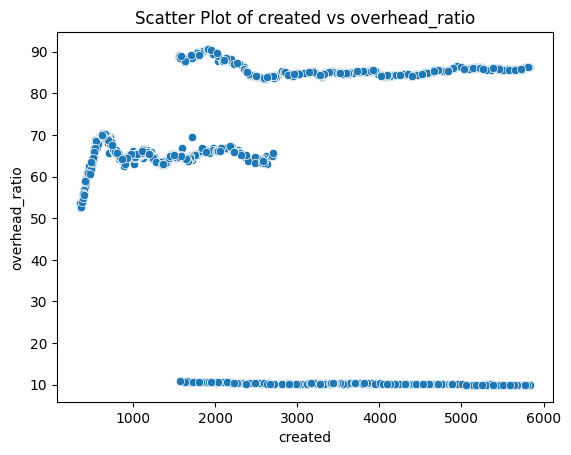

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='created', y='overhead_ratio', data=df)
plt.xlabel('created')
plt.ylabel('overhead_ratio')
plt.title('Scatter Plot of created vs overhead_ratio')
plt.show()

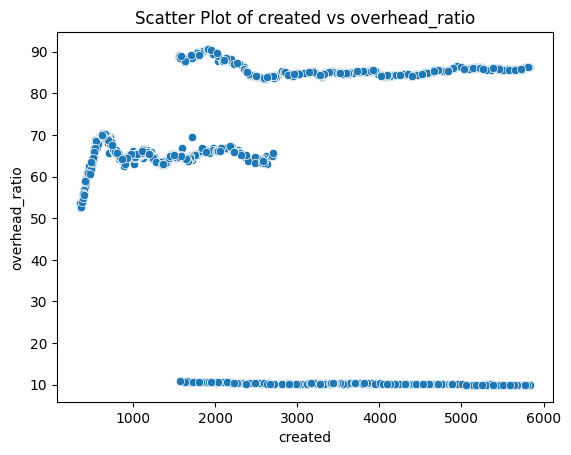

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='created', y='overhead_ratio', data=df)
plt.xlabel('created')
plt.ylabel('overhead_ratio')
plt.title('Scatter Plot of created vs overhead_ratio')
plt.show()

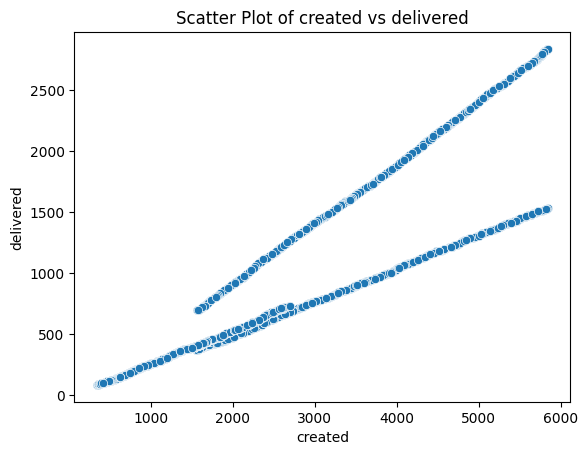

In [ ]:
import matplotlib.pyplot as plt
sns.scatterplot(x='created', y='delivered', data=df)
plt.xlabel('created')
plt.ylabel('delivered')
plt.title('Scatter Plot of created vs delivered')
plt.show()

In [ ]:
X = df[['router', 'sim_time', 'created', 'started', 'relayed', 'aborted',
       'dropped', 'delivered', 'delivery_prob', 'overhead_ratio',
       'latency_avg', 'latency_med', 'hopcount_avg', 'hopcount_med'       ]]
y = df['buffertime_avg']

In [ ]:
# Importing necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor

from sklearn.ensemble import GradientBoostingRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)




In [ ]:
# Linear Regression model
linear_reg = LinearRegression()
linear_reg.fit(X_train, y_train)

LinearRegression()

In [ ]:
# Random Forest Regressor model
random_forest = RandomForestRegressor()
random_forest.fit(X_train, y_train)

RandomForestRegressor()

In [ ]:
# Gradient Boosting Regressor model
gradient_boosting = GradientBoostingRegressor()
gradient_boosting.fit(X_train, y_train)

GradientBoostingRegressor()

In [ ]:
# XGBoost Regressor model
xgboost = XGBRegressor()
xgboost.fit(X_train, y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [ ]:
# LightGBM Regressor model
lightgbm = LGBMRegressor()
lightgbm.fit(X_train, y_train)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000496 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2929
[LightGBM] [Info] Number of data points in the train set: 2193, number of used features: 14
[LightGBM] [Info] Start training from score 2337.986180


LGBMRegressor()

In [ ]:
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
import numpy as np

# Function to calculate and print Mean Squared Error, R-squared, Mean Absolute Error, and Root Mean Square Error for each model
def calculate_metrics(model, X, y):
    y_pred = model.predict(X)
    mse = mean_squared_error(y, y_pred)
    mae = mean_absolute_error(y, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y, y_pred)
    return mse, mae, rmse, r2

# Calculate and print metrics for each model
mse_linear_reg, mae_linear_reg, rmse_linear_reg, r2_linear_reg = calculate_metrics(linear_reg, X_test, y_test)
mse_random_forest, mae_random_forest, rmse_random_forest, r2_random_forest = calculate_metrics(random_forest, X_test, y_test)
mse_gradient_boosting, mae_gradient_boosting, rmse_gradient_boosting, r2_gradient_boosting = calculate_metrics(gradient_boosting, X_test, y_test)
mse_xgboost, mae_xgboost, rmse_xgboost, r2_xgboost = calculate_metrics(xgboost, X_test, y_test)
mse_lightgbm, mae_lightgbm, rmse_lightgbm, r2_lightgbm = calculate_metrics(lightgbm, X_test, y_test)

print("Linear Regression Model - MSE:", mse_linear_reg, "MAE:", mae_linear_reg, "RMSE:", rmse_linear_reg, "R-squared:", r2_linear_reg)
print("Random Forest Regressor Model - MSE:", mse_random_forest, "MAE:", mae_random_forest, "RMSE:", rmse_random_forest, "R-squared:", r2_random_forest)
#print("Support Vector Regressor Model - MSE:", mse_svr, "R-squared:", r2_svr)
print("Gradient Boosting Regressor Model - MSE:", mse_gradient_boosting, "MAE:", mae_gradient_boosting, "RMSE:", rmse_gradient_boosting, "R-squared:", r2_gradient_boosting)
print("XGBoost Regressor Model - MSE:", mse_xgboost, "MAE:", mae_xgboost, "RMSE:", rmse_xgboost, "R-squared:", r2_xgboost)
print("LightGBM Regressor Model - MSE:", mse_lightgbm, "MAE:", mae_lightgbm, "RMSE:", rmse_lightgbm, "R-squared:", r2_lightgbm)


Linear Regression Model - MSE: 466.105392514718 MAE: 16.75273749202886 RMSE: 21.58947411389907 R-squared: 0.9996929296038479
Random Forest Regressor Model - MSE: 6.568766169820842 MAE: 0.9824406688524195 RMSE: 2.5629604307949903 R-squared: 0.9999956724945422
Gradient Boosting Regressor Model - MSE: 14.244462947384092 MAE: 2.5972469198871355 RMSE: 3.7741837458428136 R-squared: 0.9999906157428117
XGBoost Regressor Model - MSE: 8.185943102551736 MAE: 1.310825503045294 RMSE: 2.8611087191072864 R-squared: 0.9999946070978115
LightGBM Regressor Model - MSE: 8.795391130413263 MAE: 1.386583197682041 RMSE: 2.965702468288628 R-squared: 0.9999942055932368


In [ ]:
X_test.head()

,router,sim_time,created,started,relayed,aborted,dropped,delivered,delivery_prob,overhead_ratio,latency_avg,latency_med,hopcount_avg,hopcount_med
1220,1,77171.0,2610,93608,46176,47431,47024,715,0.2739,63.5818,5140.8994,4046.4,3.2909,3
2003,1,18132.0,613,20301,10008,10292,9373,142,0.2316,69.4789,3949.9993,3194.3,3.0775,3
1772,1,46232.1,1564,54094,26575,27519,26659,403,0.2577,64.9429,4930.9973,3806.1,3.2655,3
1806,1,45808.1,1549,53553,26291,27261,26359,400,0.2582,64.7275,4927.1060,3806.1,3.2700,3
2636,2,92623.0,3130,45560,16561,28998,17371,1466,0.4684,10.2967,3137.2239,2347.8,2.4297,2


In [ ]:
(gradient_boosting.predict(X_test)).mean()

2281.7652883023643

In [ ]:
(np.array([y_test])).mean()

2281.7174176684885

In [ ]:
import numpy as np

# Assuming gradient_boosting is your Gradient Boosting Regressor model
predictions = gradient_boosting.predict(X_test)
median_prediction = np.median(predictions)

print("Median of Predictions:", median_prediction)


Median of Predictions: 1523.7255631091978


In [ ]:
import numpy as np

# Assuming y_test contains the true target values
median_target = np.median(np.array([y_test]))

print("Median of True Target Values:", median_target)


Median of True Target Values: 1523.8896
